In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

In [242]:
# Importation de notre fichier
data = pd.read_csv('flipkart_com-ecommerce_sample_1050.csv')

**<u>Mission</u>** : 

Au sein de l'entreprise "Place de Marché", les vendeurs proposent des articles à des acheteurs en postant une photo et une description. Les vendeurs attribuent eux-mêmes la catégorie de leur article. Afin de **faciliter la mise en ligne de nouveaux articles** pour les vendeurs et la **recherche de produits** pour les acheteurs en automatisant la tâche. 

Nous allons donc effectuer une étude de faisabilité d'un moteur de classification d'articles basé sur une image et une description afin d'automatiser l'attribution de la catégorie de l'article.

# DONNEES TEXTUELLES

# 1. Affichage

In [243]:
data.head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa..."


In [244]:
data.tail()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
1045,958f54f4c46b53c8a0a9b8167d9140bc,2015-12-01 10:15:43 +0000,http://www.flipkart.com/oren-empower-extra-lar...,Oren Empower Extra Large Self Adhesive Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIE88ZGTX65GH4V,1399.0,999.0,958f54f4c46b53c8a0a9b8167d9140bc.jpg,False,Oren Empower Extra Large Self Adhesive Sticker...,No rating available,No rating available,Oren Empower,"{""product_specification""=>[{""key""=>""Number of ..."
1046,fd6cbcc22efb6b761bd564c28928483c,2015-12-01 10:15:43 +0000,http://www.flipkart.com/wallmantra-large-vinyl...,Wallmantra Large Vinyl Sticker Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIEC889ZD5GDCVQ,4930.0,1896.0,fd6cbcc22efb6b761bd564c28928483c.jpg,False,Wallmantra Large Vinyl Sticker Sticker (Pack o...,No rating available,No rating available,Wallmantra,"{""product_specification""=>[{""key""=>""Number of ..."
1047,5912e037d12774bb73a2048f35a00009,2015-12-01 10:15:43 +0000,http://www.flipkart.com/uberlyfe-extra-large-p...,Uberlyfe Extra Large Pigmented Polyvinyl Films...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIE5UVGW2JWVWCT,4500.0,1449.0,5912e037d12774bb73a2048f35a00009.jpg,False,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...,No rating available,No rating available,Uberlyfe,"{""product_specification""=>[{""key""=>""Number of ..."
1048,c3edc504d1b4f0ba6224fa53a43a7ad6,2015-12-01 10:15:43 +0000,http://www.flipkart.com/wallmantra-medium-viny...,Wallmantra Medium Vinyl Sticker Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIEC889ZGFD3RCE,3465.0,1333.0,c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,False,Buy Wallmantra Medium Vinyl Sticker Sticker fo...,No rating available,No rating available,Wallmantra,"{""product_specification""=>[{""key""=>""Number of ..."
1049,f2f027ad6a6df617c9f125173da71e44,2015-12-01 10:15:43 +0000,http://www.flipkart.com/uberlyfe-large-vinyl-s...,Uberlyfe Large Vinyl Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIE2ZEPACRQJKH7,1190.0,595.0,f2f027ad6a6df617c9f125173da71e44.jpg,False,Buy Uberlyfe Large Vinyl Sticker for Rs.595 on...,4,4,Uberlyfe,"{""product_specification""=>[{""key""=>""Sales Pack..."


In [245]:
data.sample(5)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
856,568f331e1039bf2e0635b899c2b3248f,2015-12-29 05:07:38 +0000,http://www.flipkart.com/lifestyle-you-ig43-04-...,Lifestyle-You IG43_04 USB USB Fan,"[""Computers >> Laptop Accessories >> USB Gadge...",USGE5BVUJY4DCCZF,999.0,499.0,568f331e1039bf2e0635b899c2b3248f.jpg,False,Lifestyle-You IG43_04 USB USB Fan (Yellow)\r\n...,No rating available,No rating available,Lifestyle-You,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
523,8d1abb3504a19ab41e7d8b8b1d5dd839,2016-01-07 05:50:25 +0000,http://www.flipkart.com/maxima-09321cmgy-gold-...,Maxima 09321CMGY Gold Analog Watch - For Men,"[""Watches >> Wrist Watches >> Maxima Wrist Wat...",WATDZ5HGZZCZXDNC,975.0,880.0,8d1abb3504a19ab41e7d8b8b1d5dd839.jpg,False,Maxima 09321CMGY Gold Analog Watch - For Men ...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Type"", ""va..."
191,ce2f67c3365846170cb709784d87e45b,2015-12-01 12:40:44 +0000,http://www.flipkart.com/prithish-blue-gold-hea...,"Prithish Blue & Gold Heart, I Love You Ceramic...","[""Kitchen & Dining >> Coffee Mugs >> Prithish ...",MUGE8DAUYGPWG9AE,499.0,175.0,ce2f67c3365846170cb709784d87e45b.jpg,False,"Buy Prithish Blue & Gold Heart, I Love You Cer...",No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Type"", ""va..."
99,059493eeb88ebb4cc08d1522f3f87c3f,2016-01-04 00:20:04 +0000,http://www.flipkart.com/thar-handloom-stylish-...,Thar Handloom Stylish Multicolor Jewellery Box...,"[""Beauty and Personal Care >> Makeup >> Vanity...",VANE8KP4GWZPNKQZ,1455.0,1350.0,059493eeb88ebb4cc08d1522f3f87c3f.jpg,False,Buy Thar Handloom Stylish Multicolor Jewellery...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Ideal For""..."
1030,4d6bf06ef01f80130a1ab28dfdeb7aa3,2016-03-03 06:06:42 +0000,http://www.flipkart.com/omrd-rd6697-hot-cold-p...,OMRD RD6697 Hot and cold Pack,"[""Beauty and Personal Care >> Health Care >> M...",HCPEFNFMYAUM6CNN,399.0,269.0,4d6bf06ef01f80130a1ab28dfdeb7aa3.jpg,False,Specifications of OMRD RD6697 Hot and cold Pac...,No rating available,No rating available,OMRD,"{""product_specification""=>[{""key""=>""Re-usable""..."


# 2. Structure

In [246]:
data.shape

(1050, 15)

In [247]:
data.columns

Index(['uniq_id', 'crawl_timestamp', 'product_url', 'product_name',
       'product_category_tree', 'pid', 'retail_price', 'discounted_price',
       'image', 'is_FK_Advantage_product', 'description', 'product_rating',
       'overall_rating', 'brand', 'product_specifications'],
      dtype='object')

In [248]:
data.dtypes

uniq_id                     object
crawl_timestamp             object
product_url                 object
product_name                object
product_category_tree       object
pid                         object
retail_price               float64
discounted_price           float64
image                       object
is_FK_Advantage_product       bool
description                 object
product_rating              object
overall_rating              object
brand                       object
product_specifications      object
dtype: object

In [249]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   uniq_id                  1050 non-null   object 
 1   crawl_timestamp          1050 non-null   object 
 2   product_url              1050 non-null   object 
 3   product_name             1050 non-null   object 
 4   product_category_tree    1050 non-null   object 
 5   pid                      1050 non-null   object 
 6   retail_price             1049 non-null   float64
 7   discounted_price         1049 non-null   float64
 8   image                    1050 non-null   object 
 9   is_FK_Advantage_product  1050 non-null   bool   
 10  description              1050 non-null   object 
 11  product_rating           1050 non-null   object 
 12  overall_rating           1050 non-null   object 
 13  brand                    712 non-null    object 
 14  product_specifications  

In [250]:
data.dtypes.value_counts()

object     12
float64     2
bool        1
dtype: int64

In [251]:
data.nunique()

uniq_id                    1050
crawl_timestamp             149
product_url                1050
product_name               1050
product_category_tree       642
pid                        1050
retail_price                354
discounted_price            424
image                      1050
is_FK_Advantage_product       2
description                1050
product_rating               27
overall_rating               27
brand                       490
product_specifications      984
dtype: int64

Le fichier est constitué de 1050 produits comportant un identifiant unique chacun. Parmis les 15 variables, 12 sont de type "object", seulement 2 sont de type "float" et une variable booléenne. Nous retrouvons différentes informations concernant chaque produit comme des dates, des url, des noms, catégories, codes, des prix (rabais ou non), le nom de l'image correspondante, une description, note, marque. 

# 3. Valeurs manquantes et dupliquées

## 3.1. Valeurs manquantes

In [252]:
data.isnull().sum()

uniq_id                      0
crawl_timestamp              0
product_url                  0
product_name                 0
product_category_tree        0
pid                          0
retail_price                 1
discounted_price             1
image                        0
is_FK_Advantage_product      0
description                  0
product_rating               0
overall_rating               0
brand                      338
product_specifications       1
dtype: int64

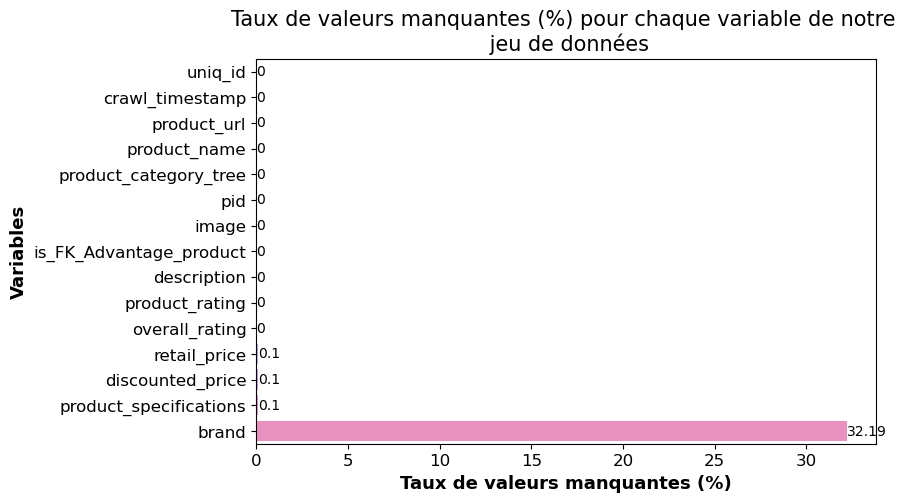

In [253]:
# Visualisation des données manquantes en %

# On crée un nouveau df des données manquantes
val_manq = pd.DataFrame(round(data.isnull().sum()/len(data)*100, 2)).reset_index()
val_manq = val_manq.rename(columns={0: 'val_manq'})
val_manq = val_manq.sort_values(by='val_manq', ascending=True)

# On crée un barplot affichant le taux de valeurs manquantes
# pour chaque variable
plt.figure(figsize=(8, 5))

ax = sns.barplot(data=val_manq, x="val_manq", y="index", ci=None, dodge=False)

plt.xlabel('Taux de valeurs manquantes (%)', size=13, fontweight='bold')
plt.ylabel('Variables', size=13, fontweight='bold')
plt.title('Taux de valeurs manquantes (%) pour chaque variable'
          ' de notre \n jeu de données', size=15)

plt.yticks(size=12)
plt.xticks(size=12)

for i in ax.containers:
    ax.bar_label(i,)

plt.show()

In [254]:
# Regardons le produit contenant des valeurs manquantes pour le prix
data[data['retail_price'].isnull()]

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."


In [255]:
# Regardons le produit contenant des valeurs manquantes pour les spécifications
data[data['product_specifications'].isnull()]

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
957,e488005c7fb68747d3458c7d73760bae,2016-02-24 04:24:17 +0000,http://www.flipkart.com/nutcase-multicolor-col...,Nutcase Multicolor Column Floor Lamp,"[""Home Decor & Festive Needs >> Decorative Lig...",FIOEFUXPJQYZKDXZ,3299.0,1299.0,e488005c7fb68747d3458c7d73760bae.jpg,False,Key Features of Nutcase Multicolor Column Floo...,No rating available,No rating available,Nutcase,NaN


In [256]:
# Regardons les produits contenant des valeurs manquantes pour la marque
data[data['brand'].isnull()].head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
5,893aa5ed55f7cff2eccea7758d7a86bd,2015-12-04 07:25:36 +0000,http://www.flipkart.com/maserati-time-r8851116...,Maserati Time R8851116001 Analog Watch - For ...,"[""Watches >> Wrist Watches >> Maserati Time Wr...",WATEAYAHJ8CUCAYM,24400.0,24400.0,893aa5ed55f7cff2eccea7758d7a86bd.jpg,False,Maserati Time R8851116001 Analog Watch - For ...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Chronograp..."
6,f355cc1ccb08bd0d283ed979b7ee7515,2015-12-04 07:25:36 +0000,http://www.flipkart.com/camerii-wm64-elegance-...,"Camerii WM64 Elegance Analog Watch - For Men,...","[""Watches >> Wrist Watches >> Camerii Wrist Wa...",WATE6Y6D2MZHWGBZ,1099.0,449.0,f355cc1ccb08bd0d283ed979b7ee7515.jpg,False,"Camerii WM64 Elegance Analog Watch - For Men,...",5,5,NaN,"{""product_specification""=>[{""key""=>""Chronograp..."
7,dd0e3470a7e6ed76fd69c2da27721041,2015-12-04 07:25:36 +0000,http://www.flipkart.com/t-star-uft-tsw-005-bk-...,T STAR UFT-TSW-005-BK-BR Analog Watch - For Boys,"[""Watches >> Wrist Watches >> T STAR Wrist Wat...",WATECFFVGFZPAD3D,999.0,399.0,dd0e3470a7e6ed76fd69c2da27721041.jpg,False,T STAR UFT-TSW-005-BK-BR Analog Watch - For B...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Chronograp..."
8,41384da51732c0b4df3de8f395714fbb,2015-12-04 07:25:36 +0000,http://www.flipkart.com/alfajr-wy16b-youth-dig...,"Alfajr WY16B Youth Digital Watch - For Men, Boys","[""Watches >> Wrist Watches >> Alfajr Wrist Wat...",WATECHFU4QGFQEJG,5495.0,4995.0,41384da51732c0b4df3de8f395714fbb.jpg,False,"Alfajr WY16B Youth Digital Watch - For Men, B...",No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Chronograp..."
9,710ed5f2393a4b9e8823aa0029f71f93,2015-12-04 07:25:36 +0000,http://www.flipkart.com/tag-heuer-cau1116-ba08...,TAG Heuer CAU1116.BA0858 Formula 1 Analog Watc...,"[""Watches >> Wrist Watches >> TAG Heuer Wrist ...",WATEA6UGFGKZKDJC,107750.0,107750.0,710ed5f2393a4b9e8823aa0029f71f93.jpg,False,TAG Heuer CAU1116.BA0858 Formula 1 Analog Watc...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Chronograp..."


## 3.2. Doublons

In [257]:
data.duplicated().sum()

0

In [258]:
# On cherche les doublons pour les informations qui nous intéressent
data.duplicated(subset='description').sum()

0

In [259]:
# Regardons les doublons pour chaque variable

for col in data.columns:
    n = data.duplicated(subset = col).sum()
    print(f"col : {col} -> duplicated : {n}")

col : uniq_id -> duplicated : 0
col : crawl_timestamp -> duplicated : 901
col : product_url -> duplicated : 0
col : product_name -> duplicated : 0
col : product_category_tree -> duplicated : 408
col : pid -> duplicated : 0
col : retail_price -> duplicated : 695
col : discounted_price -> duplicated : 625
col : image -> duplicated : 0
col : is_FK_Advantage_product -> duplicated : 1048
col : description -> duplicated : 0
col : product_rating -> duplicated : 1023
col : overall_rating -> duplicated : 1023
col : brand -> duplicated : 559
col : product_specifications -> duplicated : 65


# 4. Nettoyage

Nous n'avons pas de doublons et les valeurs manquantes ne concernent pas des variables très importantes dans notre cas. Aucun nettoyage n'est à effectuer pour le moment.  

# 5. Analyse exploratoire

## 5.1. Horaire

In [260]:
# Conversion de notre variable d'horaires en datetime
data['crawl_timestamp'] = pd.to_datetime(data['crawl_timestamp'],
                                             format="%Y-%m-%d %H:%M:%S")

In [261]:
data.crawl_timestamp.dtypes

datetime64[ns, UTC]

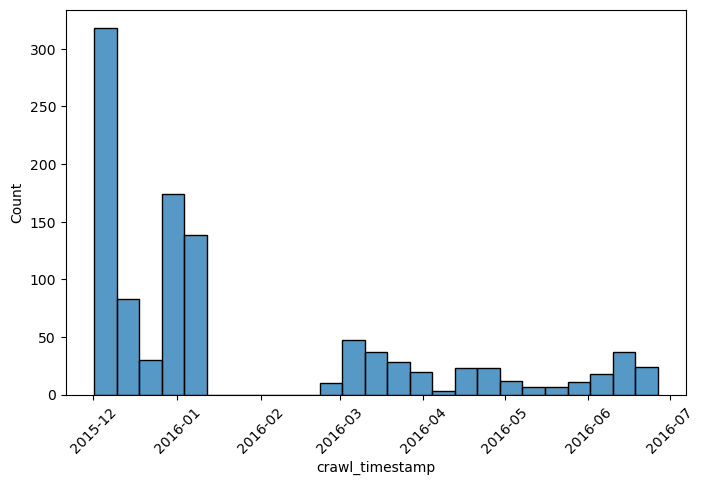

In [262]:
# Histogramme

plt.figure(figsize=(8, 5))
sns.histplot(data['crawl_timestamp'], bins=25)
plt.xticks(rotation=45)
plt.show()

## 5.2. Prix de détail

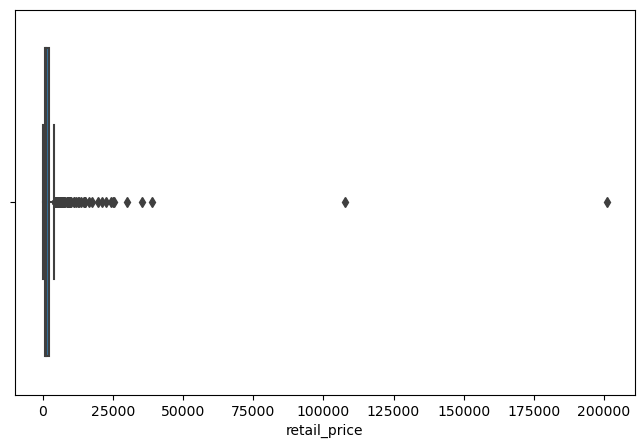

In [263]:
# Box-plot du prix de détail

plt.figure(figsize=(8, 5))
sns.boxplot(x=data['retail_price'])
plt.show()

Des produits ont des valeurs extrêmes, peut-être qu'il faudrait regarder à quoi ils correspondent. 

## 5.3. Prix au rabais

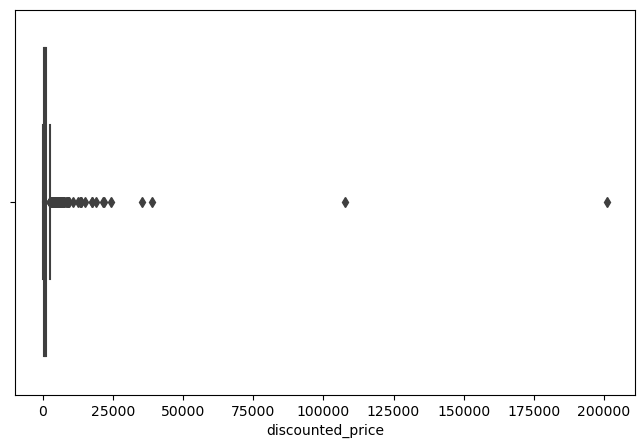

In [264]:
# Box-plot du prix au rabais

plt.figure(figsize=(8, 5))
sns.boxplot(x=data['discounted_price'])
plt.show()

Ces deux valeurs extrêmes apparaissent également sur le deuxième boxplot des prix au rabais.  

## 5.4. Note produit

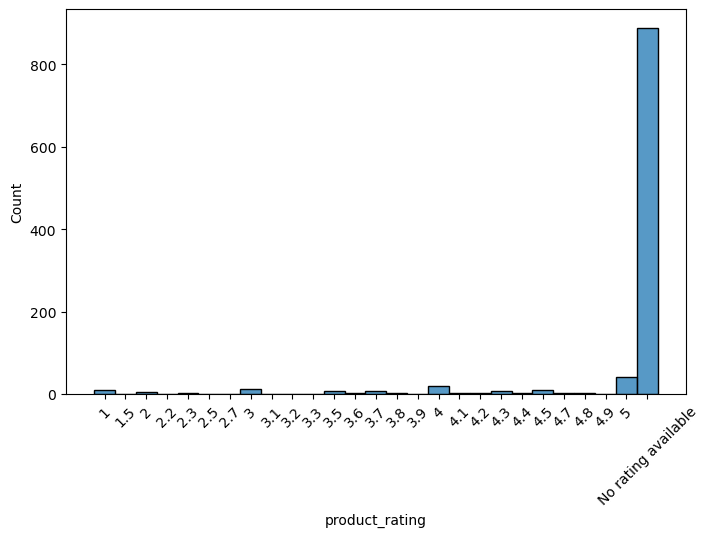

In [265]:
# Box-plot du prix au rabais

plt.figure(figsize=(8, 5))
sns.histplot(x=data['product_rating'].sort_values())
plt.xticks(rotation = 45)
plt.show()

In [266]:
# Regardons quel % de produits n'ont pas d'information pour la note
print(round(data[
    data['product_rating'] == 'No rating available'].shape[
    0]*100/data.shape[0], 2), 
      '% des produits n\'ont pas de données concernant la note.')

84.67 % des produits n'ont pas de données concernant la note.


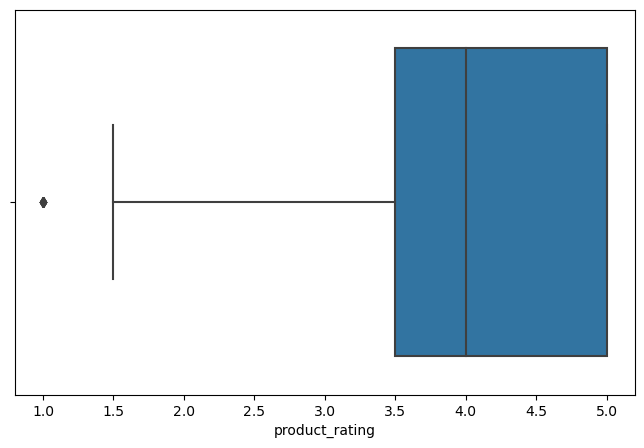

In [267]:
# Si on ne prend pas en compte ces derniers

data_note = data[data['product_rating'] != 'No rating available']
data_note['product_rating'] = data_note['product_rating'].astype('float')

plt.figure(figsize=(8, 5))
sns.boxplot(x=data_note['product_rating'])
plt.show()

Si on regarde pour les produits ayant des notes, on observe 1 seul produit avec une note de 1. La valeur médiane est de 4 (bonne note). 

## 5.5. Catégories

In [268]:
# Nombre de catégories uniques
print(data['product_category_tree'].nunique(), 'catégories uniques')

# Regardons comment est formée la catégorie 
# d'un produit au hasard
doc_categ = data['product_category_tree'].sample(1).iloc[0]
print(doc_categ)

642 catégories uniques
["Home Furnishing >> Bed Linen >> Blankets, Quilts & Dohars"]


On observe que les catégories sont formées d'une certaine façon. On part d'une catégorie générale >> à une catégorie de plus en plus précise. On va chercher à sélectionner uniquement la catégorie générale. 

In [269]:
# On ne garde que les premiers caractères avant ">>"
data['categ_generale'] = data['product_category_tree'].str.split('>>').str[0].str.strip()
display(data.head())

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,categ_generale
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56+00:00,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v...","[""Home Furnishing"
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56+00:00,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa...","[""Baby Care"
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56+00:00,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",...","[""Baby Care"
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52+00:00,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v...","[""Home Furnishing"
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52+00:00,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa...","[""Home Furnishing"


In [270]:
# Maintenant on cherche à retirer "[""

data['categ_generale'] = data['categ_generale'].apply(lambda x: x.replace('"', ''))
data['categ_generale'] = data['categ_generale'].apply(lambda x: x.replace('[', ''))
display(data.head())

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,categ_generale
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56+00:00,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Furnishing
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56+00:00,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa...",Baby Care
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56+00:00,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",...",Baby Care
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52+00:00,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Furnishing
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52+00:00,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa...",Home Furnishing


7 catégories uniques


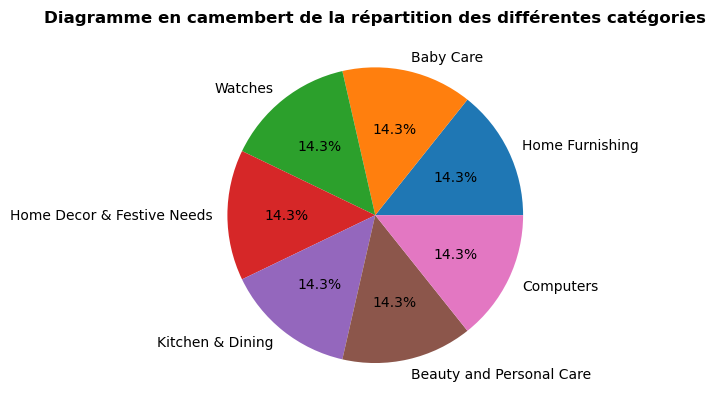

In [271]:
# On va maintenant regarder le nombre de catégories générales uniques

print(data['categ_generale'].nunique(), 'catégories uniques')

fig, ax = plt.subplots()
data['categ_generale'].value_counts(normalize = True).plot(kind = 'pie', autopct='%1.1f%%')
ax.set_title('Diagramme en camembert de la répartition des différentes catégories', fontweight = 'bold')
ax.set_ylabel('')
plt.show()

On observe 7 catégories générales toutes également réparties (14.3%).

In [272]:
# 2 catégories dont les prix sont les plus élevés
data.sort_values(by = 'discounted_price', ascending = False).head(2)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,categ_generale
11,08452abdadb3db1e686b94a9c52fc7b6,2015-12-04 07:25:36+00:00,http://www.flipkart.com/cartier-w6701005-analo...,"Cartier W6701005 Analog Watch - For Boys, Men","[""Watches >> Wrist Watches >> Cartier Wrist Wa...",WATEAK8SE2RUK7GM,201000.0,201000.0,08452abdadb3db1e686b94a9c52fc7b6.jpg,False,"Cartier W6701005 Analog Watch - For Boys, Men...",No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Chronograp...",Watches
9,710ed5f2393a4b9e8823aa0029f71f93,2015-12-04 07:25:36+00:00,http://www.flipkart.com/tag-heuer-cau1116-ba08...,TAG Heuer CAU1116.BA0858 Formula 1 Analog Watc...,"[""Watches >> Wrist Watches >> TAG Heuer Wrist ...",WATEA6UGFGKZKDJC,107750.0,107750.0,710ed5f2393a4b9e8823aa0029f71f93.jpg,False,TAG Heuer CAU1116.BA0858 Formula 1 Analog Watc...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Chronograp...",Watches


Les 2 produits dont les prix sont les plus élevés appartiennent à la catégorie "watches". 

## 5.6. Description

In [273]:
# Description de la description des produits
data['description'].describe()

count                                                  1050
unique                                                 1050
top       Key Features of Elegance Polyester Multicolor ...
freq                                                      1
Name: description, dtype: object

In [274]:
# Longueur de chaque description de produit

data['description'].apply(lambda x: len(x))

0       1420
1        444
2       1258
3        858
4       1197
        ... 
1045    2432
1046    1660
1047     262
1048     210
1049     187
Name: description, Length: 1050, dtype: int64

<Axes: >

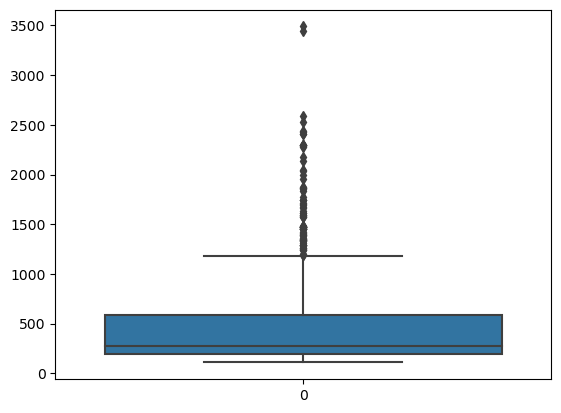

In [275]:
# Boxplot de la longueur de la description
tmp = data['description'].str.len()
sns.boxplot(tmp)

On observe des valeurs extrêmes avec des produits contenant un très grand nombre de caractères.

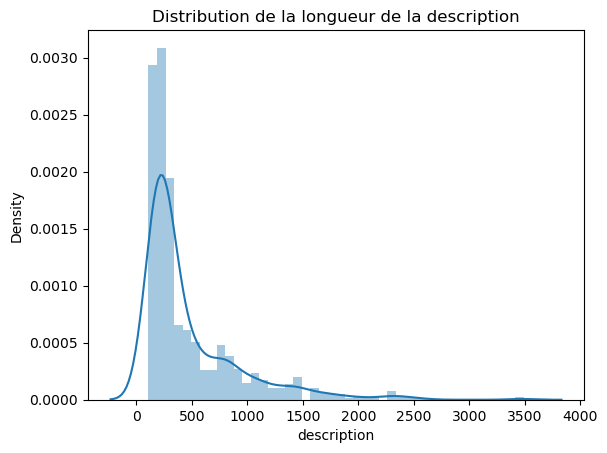

In [276]:
# Histogramme de la distribution de la longueur de la description
sns.distplot(tmp)
plt.title('Distribution de la longueur de la description')
plt.show()

In [277]:
# On crée une nouvelle colonne comptant la longueur de la description
data['len_text'] = tmp

In [278]:
# Sélection des variables de types numériques
float_columns = data.select_dtypes(include=['float64', 'int'])

<Axes: >

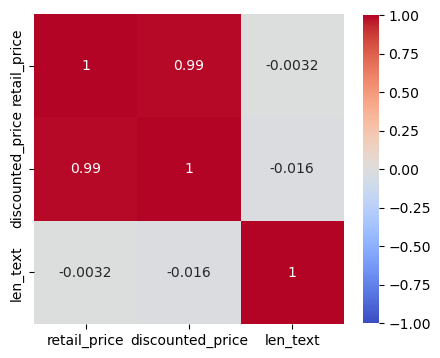

In [279]:
# Heatmap des corrélations

fig, ax = plt.subplots(figsize=(5, 5))
sns.heatmap(float_columns.corr(), annot=True, square=True, vmin=-1, vmax=+1,
            cmap=plt.cm.coolwarm, cbar_kws={"shrink": 0.8})

Pas de corrélation observée entre la longueur de la description et les prix.

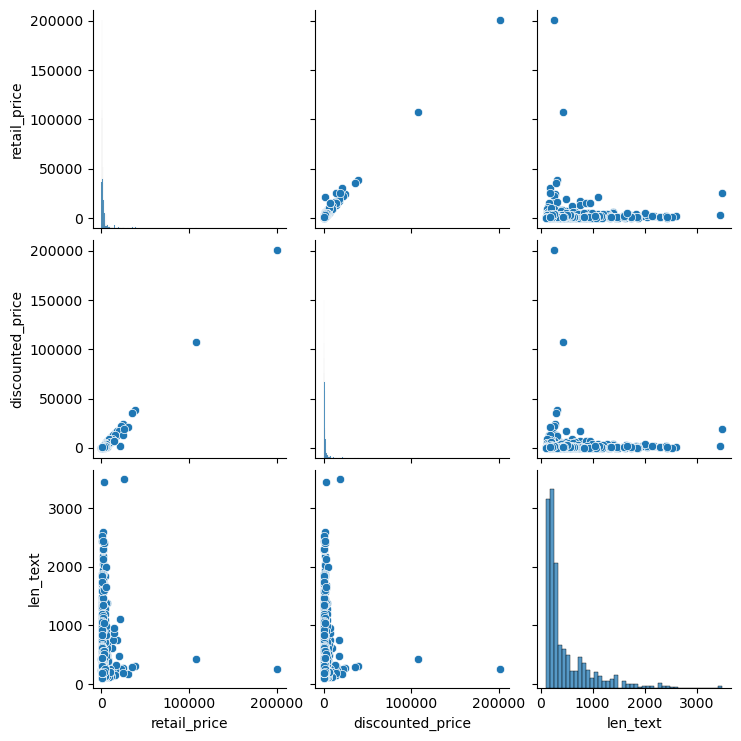

In [280]:
sns.pairplot(float_columns)

In [281]:
data.sort_values('len_text').head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,categ_generale,len_text
877,c943647eee4de99fc1b4e233b9a7f47d,2015-12-20 08:26:17+00:00,http://www.flipkart.com/nkp-cotton-bath-towel/...,Nkp Cotton Bath Towel,"[""Home Furnishing >> Bath Linen >> Towels""]",BTWEBZYHA6ZFBWK4,599.0,549.0,c943647eee4de99fc1b4e233b9a7f47d.jpg,False,Buy Nkp Cotton Bath Towel at Rs. 549 at Flipka...,No rating available,No rating available,Nkp,"{""product_specification""=>[{""key""=>""Material"",...",Home Furnishing,109
890,72db37ec42ee76d79cf395221e0f4cce,2015-12-20 08:26:17+00:00,http://www.flipkart.com/iws-cotton-bath-towel/...,IWS Cotton Bath Towel,"[""Home Furnishing >> Bath Linen >> Towels""]",BTWE88GQZKD6N3VX,599.0,299.0,72db37ec42ee76d79cf395221e0f4cce.jpg,False,Buy IWS Cotton Bath Towel at Rs. 299 at Flipka...,No rating available,No rating available,IWS,"{""product_specification""=>[{""key""=>""Machine Wa...",Home Furnishing,109
1030,4d6bf06ef01f80130a1ab28dfdeb7aa3,2016-03-03 06:06:42+00:00,http://www.flipkart.com/omrd-rd6697-hot-cold-p...,OMRD RD6697 Hot and cold Pack,"[""Beauty and Personal Care >> Health Care >> M...",HCPEFNFMYAUM6CNN,399.0,269.0,4d6bf06ef01f80130a1ab28dfdeb7aa3.jpg,False,Specifications of OMRD RD6697 Hot and cold Pac...,No rating available,No rating available,OMRD,"{""product_specification""=>[{""key""=>""Re-usable""...",Beauty and Personal Care,111
651,705b90361aeda1849a728d80625a78a9,2015-12-31 09:19:31+00:00,http://www.flipkart.com/marvel-cotton-bath-tow...,Marvel Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEE4HMGWFQPGWH,449.0,449.0,705b90361aeda1849a728d80625a78a9.jpg,False,Buy Marvel Cotton Bath Towel at Rs. 449 at Fli...,No rating available,No rating available,Marvel,"{""product_specification""=>[{""key""=>""Material"",...",Baby Care,112
892,6858fd9265d348803b18667fe43cd054,2015-12-20 08:26:17+00:00,http://www.flipkart.com/mb-cotton-set-towels/p...,MB Cotton Set of Towels,"[""Home Furnishing >> Bath Linen >> Towels""]",BTWEYFA942QUCJ6Q,1495.0,1195.0,6858fd9265d348803b18667fe43cd054.jpg,False,Buy MB Cotton Set of Towels at Rs. 1195 at Fli...,3.5,3.5,MB,"{""product_specification""=>[{""key""=>""Material"",...",Home Furnishing,112


In [282]:
data.sort_values('len_text').tail()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,categ_generale,len_text
589,621a88993a7033df3440ec816c2e386f,2016-05-10 11:57:25+00:00,http://www.flipkart.com/shopfloor-xyz-vacuum-c...,"Shopfloor.XYZ Vacuum Cleaner for Computers, La...","[""Computers >> Laptop Accessories >> Cleaning ...",CLKEGH4ADYDTQFHE,399.0,269.0,621a88993a7033df3440ec816c2e386f.jpg,False,"Shopfloor.XYZ Vacuum Cleaner for Computers, La...",No rating available,No rating available,Shopfloor.XYZ,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Computers,2436
916,c5c559012b742d9966df82182b90c6da,2016-06-20 11:04:25+00:00,http://www.flipkart.com/wallskart-floral-botan...,wallskart Floral & Botanical Wallpaper,"[""Home Decor & Festive Needs >> Wall Decor & C...",WLPEJ5VGMYBYGGX7,599.0,299.0,c5c559012b742d9966df82182b90c6da.jpg,False,Key Features of wallskart Floral & Botanical W...,No rating available,No rating available,wallskart,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Decor & Festive Needs,2529
715,d68b774e9529a4b94a5c6c8943a1b8b3,2016-01-01 19:37:22+00:00,http://www.flipkart.com/pioneer-pragati-floral...,Pioneer Pragati Floral Single Duvet Orange,"[""Home Furnishing >> Bed Linen >> Blankets, Qu...",BLAEDAN7HXG3CAHD,1999.0,1099.0,d68b774e9529a4b94a5c6c8943a1b8b3.jpg,False,Pioneer Pragati Floral Single Duvet Orange (1 ...,No rating available,No rating available,Pioneer Pragati,"{""product_specification""=>[{""key""=>""Machine Wa...",Home Furnishing,2594
639,aeb421e416716d5f037d50e8c3b14cd7,2016-06-22 20:52:57+00:00,http://www.flipkart.com/sunlast-16-inch-laptop...,Sunlast 16 inch Laptop Backpack,"[""Computers >> Laptop Accessories >> Laptop Ba...",LTBEJTHWEWWGGKUY,2600.0,2348.0,aeb421e416716d5f037d50e8c3b14cd7.jpg,False,Key Features of Sunlast 16 inch Laptop Backpac...,No rating available,No rating available,Sunlast,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Computers,3447
437,b6c339777814451815fe7950fd4c8536,2016-06-16 08:51:06+00:00,http://www.flipkart.com/homeedge-solid-wood-ki...,HomeEdge Solid Wood King Bed,"[""Beauty and Personal Care >> Health Care >> H...",BDDEH93ZEEZY7CHM,25499.0,18799.0,b6c339777814451815fe7950fd4c8536.jpg,False,Key Features of HomeEdge Solid Wood King Bed K...,No rating available,No rating available,HomeEdge,"{""product_specification""=>[{""key""=>""Installati...",Beauty and Personal Care,3490


# 6. Pré-traitement de la description des produits

## 6.1. Affichage nom images, titre et description

In [283]:
# Affichons pour 10 échantillons aléatoires

df = data.sample(10)
    
for idx, ser in df.iterrows():
    txt_1 = f"image : {ser['image']}\n"
    txt_2 = f"nom produit : {ser['product_name']}\n"
    print(txt_1 + txt_2, ser['description'] + '...' + '\n\n')

image : 26269fd0df12630eec4508c2cf3c94e1.jpg
nom produit : JewelKraft Designs Brown, Pink Table Linen Set
 Specifications of JewelKraft Designs Brown, Pink Table Linen Set General Brand JewelKraft Designs Design Code MN Style Code 411 Color Brown, Pink In the Box Sales Package 6 table mats 6 napkins...


image : 60efd61370e70267dc60b11ff2bf974c.jpg
nom produit : Prithish Abstract Design 40 Ceramic Mug
 Buy Prithish Abstract Design 40 Ceramic Mug for Rs.175 online. Prithish Abstract Design 40 Ceramic Mug at best prices with FREE shipping & cash on delivery. Only Genuine Products. 30 Day Replacement Guarantee....


image : e33795f66b2a42ac56095ae704ab25b6.jpg
nom produit : AntiqueShop ABKL_PL_PNK_PNK
 Key Features of AntiqueShop ABKL_PL_PNK_PNK Soft on the skin Rope loop for easy hanging Durable, long lasting material Great for liquid soaps and body wash With this soft sponge, you can have a comforting and relaxing warm shower,AntiqueShop ABKL_PL_PNK_PNK Price: Rs. 349 Brand New Nylon Bo

## 6.2. Travail sur un document spécifique

In [284]:
# Sélection d'un document aléatoire de notre corpus

doc = data.description.sample(1)
doc = doc.values[0]
doc

'Buy Lal Haveli Rajasthani Handcrafted Decorative Showpiece Statue Musicians Showpiece  -  17.18 cm for Rs.12399 online. Lal Haveli Rajasthani Handcrafted Decorative Showpiece Statue Musicians Showpiece  -  17.18 cm at best prices with FREE shipping & cash on delivery. Only Genuine Products. 30 Day Replacement Guarantee.'

In [285]:
print('La longueur initiale de la description est de :', len(doc))

La longueur initiale de la description est de : 321


### 6.2.1. Mise en minuscule

La mise en minuscule permet de le normaliser afin que les mots puissent être comparables entre eux car 2 mots identiques, mais dont l'un comporte une majuscule, sont traités comme des mots différents. 

In [286]:
doc_low = doc.lower()
print('La longueur de cette description est de :', len(doc_low))

La longueur de cette description est de : 321


In [287]:
# Exemple sur notre phrase prise au hasard
doc_low

'buy lal haveli rajasthani handcrafted decorative showpiece statue musicians showpiece  -  17.18 cm for rs.12399 online. lal haveli rajasthani handcrafted decorative showpiece statue musicians showpiece  -  17.18 cm at best prices with free shipping & cash on delivery. only genuine products. 30 day replacement guarantee.'

### 6.2.2. Tokenisation

On va décomposer notre texte en tokens (mots). Cette étape permet de séparer les mots entre eux, mais également les symboles, la ponctuation. 

In [288]:
import nltk
from nltk.tokenize import word_tokenize, wordpunct_tokenize

tokens = word_tokenize(doc_low)
print(tokens)

['buy', 'lal', 'haveli', 'rajasthani', 'handcrafted', 'decorative', 'showpiece', 'statue', 'musicians', 'showpiece', '-', '17.18', 'cm', 'for', 'rs.12399', 'online', '.', 'lal', 'haveli', 'rajasthani', 'handcrafted', 'decorative', 'showpiece', 'statue', 'musicians', 'showpiece', '-', '17.18', 'cm', 'at', 'best', 'prices', 'with', 'free', 'shipping', '&', 'cash', 'on', 'delivery', '.', 'only', 'genuine', 'products', '.', '30', 'day', 'replacement', 'guarantee', '.']


In [289]:
print(len(tokens), 'tokens présents initialement dans notre phrase.')

49 tokens présents initialement dans notre phrase.


On observe des caractères de ponctuations parmi nos tokens. 

In [290]:
# On va créer une fonction de tokenisation


def tokenisation(df):
    tokens = word_tokenize(df)
    return tokens

In [291]:
# Testons notre fonction sur notre document
tokenisation(doc_low)

['buy',
 'lal',
 'haveli',
 'rajasthani',
 'handcrafted',
 'decorative',
 'showpiece',
 'statue',
 'musicians',
 'showpiece',
 '-',
 '17.18',
 'cm',
 'for',
 'rs.12399',
 'online',
 '.',
 'lal',
 'haveli',
 'rajasthani',
 'handcrafted',
 'decorative',
 'showpiece',
 'statue',
 'musicians',
 'showpiece',
 '-',
 '17.18',
 'cm',
 'at',
 'best',
 'prices',
 'with',
 'free',
 'shipping',
 '&',
 'cash',
 'on',
 'delivery',
 '.',
 'only',
 'genuine',
 'products',
 '.',
 '30',
 'day',
 'replacement',
 'guarantee',
 '.']

On va vérifier que l'on retrouve des mots communs entre la description et le nom de chaque produit. 

In [292]:
# On applique notre fonction de tokenisation à nos deux colonnes à comparer

data_copy = data.copy()

data_copy['tokens_nom'] = data_copy['product_name'].apply(tokenisation)
data_copy['tokens_descr'] = data_copy['description'].apply(tokenisation)

# Création colonne des mots communs
data_copy['common_words'] = data_copy.apply(lambda row: set(row['tokens_nom']).intersection(set(row['tokens_descr'])), axis=1)

# Création colonne pour les booléens
data_copy['common_bool'] = data_copy['common_words'].apply(lambda x: bool(x))

In [293]:
# Nous allons maintenant vérifier s'il existe des "False"
print(data_copy[data_copy['common_bool'] == True].shape[0]*100/data_copy.shape[0],
      '% des produits ayant des mots en commun entre le nom et la description du produit.')

100.0 % des produits ayant des mots en commun entre le nom et la description du produit.


### 6.2.3. Suppression ponctuation

Les caractères de ponctuation ne sont pas des informations utiles pour la compréhension de notre contenu.

In [294]:
import string

exclude = set(string.punctuation)  #Création ensemble contenant les caractères de ponctuation du module 'string'
exclude.remove(".")  #Suppression du point de la liste de caractères

# Utilisation des caractères de ponctuation restants
# Remplacement de ces caractères par une chaine vide
for punctuation in exclude:
    doc_low = doc_low.replace(punctuation,"")
    
# Remplacement des points par des espaces
doc_low = doc_low.replace("."," ")
doc_low = doc_low.split()

In [295]:
print(doc_low)

['buy', 'lal', 'haveli', 'rajasthani', 'handcrafted', 'decorative', 'showpiece', 'statue', 'musicians', 'showpiece', '17', '18', 'cm', 'for', 'rs', '12399', 'online', 'lal', 'haveli', 'rajasthani', 'handcrafted', 'decorative', 'showpiece', 'statue', 'musicians', 'showpiece', '17', '18', 'cm', 'at', 'best', 'prices', 'with', 'free', 'shipping', 'cash', 'on', 'delivery', 'only', 'genuine', 'products', '30', 'day', 'replacement', 'guarantee']


In [296]:
print('La longueur de cette description après suppression de la ponctuation est de :', len(doc_low))

La longueur de cette description après suppression de la ponctuation est de : 45


### 6.2.4. Suppression des mots de liaison

Les mots de liaison sont généralement des mots très courants dans un texte, mais n'ayant pas de signification particulière. Leur suppression permet d'alléger le texte et d'identifier plus facilement les mots clés qui nous intéressent. 

In [297]:
# Comptage de la fréquence de chaque mot unique 
# et tri par fréquence décroissante
from collections import Counter

count = Counter(doc_low).most_common()

In [298]:
# Affichage des mots uniques et leur fréquence
for mot, frequence in count:
    print(f"{mot}: {frequence}")

showpiece: 4
lal: 2
haveli: 2
rajasthani: 2
handcrafted: 2
decorative: 2
statue: 2
musicians: 2
17: 2
18: 2
cm: 2
buy: 1
for: 1
rs: 1
12399: 1
online: 1
at: 1
best: 1
prices: 1
with: 1
free: 1
shipping: 1
cash: 1
on: 1
delivery: 1
only: 1
genuine: 1
products: 1
30: 1
day: 1
replacement: 1
guarantee: 1


In [299]:
# Affichons les stopwords/mots de liaison

from nltk.corpus import words
from nltk.corpus import stopwords

stop_words = set(stopwords.words('english'))
print(stop_words)

{'yourselves', 'can', "shan't", 'weren', 'in', 'themselves', 'what', 'few', 'ourselves', 'your', 'here', 'until', 'own', 'most', "haven't", 'mightn', 'any', 've', 'hers', 'below', 'them', 'didn', 'we', 'shan', 'some', 'yours', 'him', 'these', 'himself', 'out', 'should', 'does', "she's", 'whom', 'wouldn', 'just', 'd', "hasn't", 'needn', 'if', 'too', 'herself', 'hadn', 'ours', 'her', 'you', 'are', "don't", 'because', "that'll", 'an', 'being', 'nor', 'ain', 'for', "weren't", 'once', 'off', 'from', 'having', 'am', "doesn't", 'be', 'had', 'more', "isn't", 'myself', 'couldn', 'and', 'haven', 'their', 'about', "should've", 'been', 'did', 'wasn', 'itself', 'has', 'after', 'o', "you'd", 'at', 'during', 'doesn', "you'll", 're', 'but', 'above', "you're", 'over', 'now', 'theirs', 'his', 't', 'were', 'all', "shouldn't", 'very', 'or', 'why', 'who', 'was', 'to', 'm', 'other', 'up', 'of', 'she', 'they', 'the', 'not', 'than', 'ma', 'yourself', "wasn't", 'through', 'those', 'i', 'only', 'then', 'both', 

In [300]:
len(stop_words)

179

In [301]:
# Suppression des stopwords
doc_low = [x for x in doc_low if x not in stop_words]

In [302]:
print(doc_low)

['buy', 'lal', 'haveli', 'rajasthani', 'handcrafted', 'decorative', 'showpiece', 'statue', 'musicians', 'showpiece', '17', '18', 'cm', 'rs', '12399', 'online', 'lal', 'haveli', 'rajasthani', 'handcrafted', 'decorative', 'showpiece', 'statue', 'musicians', 'showpiece', '17', '18', 'cm', 'best', 'prices', 'free', 'shipping', 'cash', 'delivery', 'genuine', 'products', '30', 'day', 'replacement', 'guarantee']


In [303]:
print('La longueur de cette description après suppression des mots de liaison est de :', len(doc_low))

La longueur de cette description après suppression des mots de liaison est de : 40


### 6.2.5. Création d'une fonction de nettoyage des champs de texte (mise en minuscule, suppression ponctuation et mots de liaison)

In [304]:
def clean_champs(df):

    # Mise en minuscule
    doc = df.lower()
    
    # Suppression poncutation
    exclude = set(string.punctuation)
    exclude.remove(".")

    for punctuation in exclude:
        doc = doc.replace(punctuation,"")

    doc = doc.replace("."," ")
    doc = doc.split()

    # Suppression mots de liaison
    stop_words = set(stopwords.words('english'))
    doc = [x for x in doc if x not in stop_words]
    
    return doc

In [305]:
# Vérifions notre fonction pour un document aléatoire

doc_2 = data.description.sample(1)
doc_2 = doc_2.values[0]
print('Document avant nettoyage des champs de texte :\n', doc_2)

print('------------------')
doc_2_clean = clean_champs(doc_2)
print('Document après nettoyage des champs de texte :\n', ' '.join(doc_2_clean))

Document avant nettoyage des champs de texte :
 Buy Casa Copenhagen Set of Towels at Rs. 800 at Flipkart.com. Only Genuine Products. Free Shipping. Cash On Delivery!
------------------
Document après nettoyage des champs de texte :
 buy casa copenhagen set towels rs 800 flipkart com genuine products free shipping cash delivery


### 6.2.6. Racinisation (stemming)

On va réduire chaque mot à sa racine, c'est-à-dire à la partie restante du mot une fois que l'on a enlevé son radical (préfixe et suffixe).  

In [306]:
from nltk.stem import PorterStemmer

stemmer = PorterStemmer()
stemmer_text = [stemmer.stem(word) for word in doc_low]
print(stemmer_text)

['buy', 'lal', 'have', 'rajasthani', 'handcraft', 'decor', 'showpiec', 'statu', 'musician', 'showpiec', '17', '18', 'cm', 'rs', '12399', 'onlin', 'lal', 'have', 'rajasthani', 'handcraft', 'decor', 'showpiec', 'statu', 'musician', 'showpiec', '17', '18', 'cm', 'best', 'price', 'free', 'ship', 'cash', 'deliveri', 'genuin', 'product', '30', 'day', 'replac', 'guarante']


In [307]:
# On va créer une fonction pour "stemmer" notre phrase


def stemmer_func(cleaned_words):
    stemmer = PorterStemmer()
    stemmer_text = [stemmer.stem(word) for word in cleaned_words]
    return stemmer_text

In [308]:
# Vérifions notre fonction pour le document précédent.

print('Document avant nettoyage des champs de texte :\n', doc)

print('------------------')
doc_stemm_clean = stemmer_func(doc_low)
print('Document après nettoyage des champs de texte et racinisation:\n', ' '.join(doc_stemm_clean))

# Affichage de la différence entre les mots avant et après la stemmisation
print('-------------------------------')
print('Mots avant et après racinisation :')
print("{:15} | {}".format("Original", "Stemmed"))
print("-" * 30)
for i in range(len(doc_low)):
    print("{:15} | {}".format(doc_low[i], doc_stemm_clean[i]))

Document avant nettoyage des champs de texte :
 Buy Lal Haveli Rajasthani Handcrafted Decorative Showpiece Statue Musicians Showpiece  -  17.18 cm for Rs.12399 online. Lal Haveli Rajasthani Handcrafted Decorative Showpiece Statue Musicians Showpiece  -  17.18 cm at best prices with FREE shipping & cash on delivery. Only Genuine Products. 30 Day Replacement Guarantee.
------------------
Document après nettoyage des champs de texte et racinisation:
 buy lal have rajasthani handcraft decor showpiec statu musician showpiec 17 18 cm rs 12399 onlin lal have rajasthani handcraft decor showpiec statu musician showpiec 17 18 cm best price free ship cash deliveri genuin product 30 day replac guarante
-------------------------------
Mots avant et après racinisation :
Original        | Stemmed
------------------------------
buy             | buy
lal             | lal
haveli          | have
rajasthani      | rajasthani
handcrafted     | handcraft
decorative      | decor
showpiece       | showpiec
s

### 6.2.7. Lemmatisation

On utilise la technique de lemmatisation pour réduire les mots à leur base, leur forme canonique (verbe à l'infinitif, adjectif, singulier masculin, ...). 

In [309]:
import nltk
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\evaro\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\evaro\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

In [310]:
from nltk.stem import WordNetLemmatizer

lemmatizer = WordNetLemmatizer()
lemmatizer_text = [lemmatizer.lemmatize(word) for word in doc_low]
print(lemmatizer_text)

['buy', 'lal', 'haveli', 'rajasthani', 'handcrafted', 'decorative', 'showpiece', 'statue', 'musician', 'showpiece', '17', '18', 'cm', 'r', '12399', 'online', 'lal', 'haveli', 'rajasthani', 'handcrafted', 'decorative', 'showpiece', 'statue', 'musician', 'showpiece', '17', '18', 'cm', 'best', 'price', 'free', 'shipping', 'cash', 'delivery', 'genuine', 'product', '30', 'day', 'replacement', 'guarantee']


In [311]:
# On crée une fonction pour "lemmatiser" notre phrase


def lemmatizer_func(cleaned_word):
    lemmatizer = WordNetLemmatizer()
    lemmatizer_text = [lemmatizer.lemmatize(word) for word in cleaned_word]
    return lemmatizer_text

In [312]:
# Vérifions notre fonction pour le document précédent.

print('Document avant nettoyage des champs de texte :\n', doc)

print('------------------')
doc_lemm_clean = lemmatizer_func(doc_low)
print('Document après nettoyage des champs de texte et racinisation:\n', ' '.join(doc_lemm_clean))

# Affichage de la différence entre les mots avant et après la lemmatisation
print('-------------------------------')
print('Mots avant et après lemmatisation :')
print("{:15} | {}".format("Original", "Lemmed"))
print("-" * 30)
for i in range(len(doc_low)):
    print("{:15} | {}".format(doc_low[i], doc_lemm_clean[i]))

Document avant nettoyage des champs de texte :
 Buy Lal Haveli Rajasthani Handcrafted Decorative Showpiece Statue Musicians Showpiece  -  17.18 cm for Rs.12399 online. Lal Haveli Rajasthani Handcrafted Decorative Showpiece Statue Musicians Showpiece  -  17.18 cm at best prices with FREE shipping & cash on delivery. Only Genuine Products. 30 Day Replacement Guarantee.
------------------
Document après nettoyage des champs de texte et racinisation:
 buy lal haveli rajasthani handcrafted decorative showpiece statue musician showpiece 17 18 cm r 12399 online lal haveli rajasthani handcrafted decorative showpiece statue musician showpiece 17 18 cm best price free shipping cash delivery genuine product 30 day replacement guarantee
-------------------------------
Mots avant et après lemmatisation :
Original        | Lemmed
------------------------------
buy             | buy
lal             | lal
haveli          | haveli
rajasthani      | rajasthani
handcrafted     | handcrafted
decorative   

Nous continuons notre nettoyage de texte en gardant la technique de **lemmatisation** qui prend en compte la signification des mots tandis que la racinisation coupe la fin de certains mots, ce qui est plus difficile à interpréter.

### 6.2.8. Création d'une fonction de nettoyage des champs de texte + lemmatisation

In [313]:
def clean_text(df):

    # Mise en minuscule
    doc = df.lower()

    # Tokenisation
    tokens = word_tokenize(doc)
    
    # Suppression ponctutation
    exclude = set(string.punctuation)
    exclude.remove(".")

    for punctuation in exclude:
        doc = doc.replace(punctuation,"")

    doc = doc.replace("."," ")
    doc = doc.split()

    # Suppression mots de liaison
    stop_words = set(stopwords.words('english'))
    doc = [x for x in doc if x not in stop_words]

    # Lemmatisation
    lemmatizer = WordNetLemmatizer()
    lemmatizer_text = [lemmatizer.lemmatize(word) for word in doc]

    return doc

In [314]:
# On teste notre nouvelle fonction

doc_test = data.description.sample(1)
doc_test = doc_test.values[0]
print('Document avant nettoyage des champs de texte :\n', doc_test)

print('------------------')
doc_test_cleaned = clean_text(doc_test)
print('Document après nettoyage des champs de texte :\n', ' '.join(doc_test_cleaned))

Document avant nettoyage des champs de texte :
 Alfajr WY16B Youth Digital Watch  - For Men, Boys - Buy Alfajr WY16B Youth Digital Watch  - For Men, Boys  WY16B Online at Rs.4995 in India Only at Flipkart.com. Azan Times ( For All Cities Around The World ), Prayer Reminders, Qibla Direction, Hijri And Gregorian Calnedars, Qur'An Bookmark, Daily Alrams - Great Discounts, Only Genuine Products, 30 Day Replacement Guarantee, Free Shipping. Cash On Delivery!
------------------
Document après nettoyage des champs de texte :
 alfajr wy16b youth digital watch men boys buy alfajr wy16b youth digital watch men boys wy16b online rs 4995 india flipkart com azan times cities around world prayer reminders qibla direction hijri gregorian calnedars quran bookmark daily alrams great discounts genuine products 30 day replacement guarantee free shipping cash delivery


## 6.3. Travail sur le corpus

### 6.3.1. Construction du corpus

In [315]:
# On construit notre corpus

corpus = "".join(data.description.values)
corpus[:2000]

'Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you

In [316]:
# Longueur totale de notre corpus

len(corpus)

497512

In [317]:
# On applique la tokenisation sur notre corpus

corpus_tokens = tokenisation(corpus)
print('Nombre de tokens avant traitement:', len(corpus_tokens))

Nombre de tokens avant traitement: 90712


In [318]:
# On applique notre nettoyage sur notre corpus
# puis on compte le nombre tokens
corpus_clean = clean_text(corpus)
print(f"nb tokens {len(corpus_clean)}, nb tokens uniques {len(set(corpus_clean))}")
print(corpus_clean[:30])

nb tokens 59786, nb tokens uniques 6585
['key', 'features', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'curtainelegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', '213', 'cm', 'height', 'pack', '2', 'price', 'rs', '899', 'curtain', 'enhances', 'look', 'interiors', 'curtain']


In [319]:
# On compte le nombre de mots uniques

tmp = pd.Series(corpus_clean).value_counts()
tmp

rs            911
products      635
free          613
genuine       564
cash          564
             ... 
mpeg4           1
pragatibuy      1
638             1
pompom          1
bullshit        1
Length: 6585, dtype: int64

In [320]:
# Affichons les 30 tokens les plus nombreux 

tmp.head(30)

rs             911
products       635
free           613
genuine        564
cash           564
shipping       564
replacement    559
day            538
cm             504
30             495
guarantee      471
com            468
1              439
flipkart       398
online         396
features       395
buy            391
price          351
watch          329
color          317
pack           317
baby           316
mug            310
material       306
type           303
set            301
general        288
box            288
cotton         287
5              273
dtype: int64

In [321]:
# Affichons les 30 tokens les moins nombreux

tmp.tail(30)

deliverycraftartz      1
mudra                  1
wma                    1
rmvb                   1
h264                   1
canonbuy               1
hut                    1
666btpxn               1
633btpyx3k             1
mov                    1
cc0070001              1
spangle                1
279                    1
sweethearts            1
mp4                    1
mpeg1                  1
glassspecifications    1
643                    1
multipurposeocean      1
finefinish             1
surfacebuy             1
mpeg2                  1
1529                   1
dune                   1
519                    1
mpeg4                  1
pragatibuy             1
638                    1
pompom                 1
bullshit               1
dtype: int64

<Axes: >

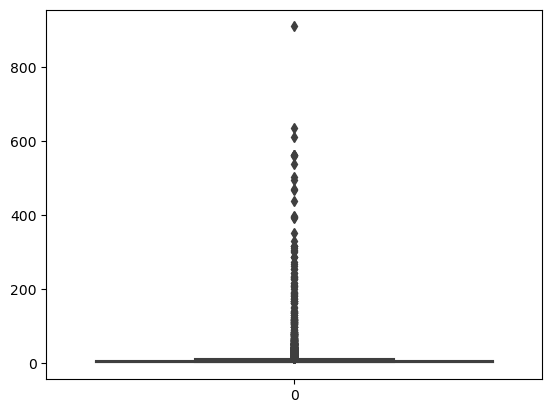

In [322]:
# Affichons la répartition de ces mots. 
sns.boxplot(tmp)

On observe un certain nombre de valeurs extrêmes. 

### 6.3.2. Liste des tokens rares/uniques

On considère que les tokens rares ne sont pas utiles pour la suite, on va donc les intégrer dans une liste. 

In [323]:
# Création de notre liste de tokens uniques
liste_unique_tokens = tmp[tmp == 1]
print(len(liste_unique_tokens), 'tokens uniques')
liste_unique_tokens = list(liste_unique_tokens.index)

2486 tokens uniques


In [324]:
# On enregistre dans un dataframe
unique_tokens = pd.DataFrame({"words" : liste_unique_tokens})
unique_tokens.head()

,words
0,library
1,compaingns
2,textured
3,coming
4,tiny


### 6.3.3. Liste de mots courts (< 3 lettres)

In [325]:
# Création de notre df comptant la longueur des mots
len_words = pd.Series(corpus_clean).apply(len)
len_words = pd.DataFrame({"words" : pd.Series(corpus_clean),
                          "longueur" : pd.Series(corpus_clean).apply(len)})
len_words.head()

,words,longueur
0,key,3
1,features,8
2,elegance,8
3,polyester,9
4,multicolor,10


In [326]:
# Création de notre liste de mots courts (< 3 lettres)
len_inf_3 = len_words[len_words['longueur'] < 3]
display(len_inf_3.head())
print(len_inf_3.shape[0], 'mots sont inférieurs à 3 lettres')

liste_tokens_courts = len_inf_3['words'].tolist()

,words,longueur
18,cm,2
21,2,1
23,rs,2
118,cm,2
121,2,1


5544 mots sont inférieurs à 3 lettres


### 6.3.4. Liste de mots non alphabétiques

In [327]:
# Sélection des mots non alphabétiques

mots_non_alpha = [mot for mot in corpus_clean if not mot.isalpha()]
print(len(mots_non_alpha), 'mots non alphabétiques')

5925 mots non alphabétiques


### 6.3.5. Wordcloud

#### a. Corpus global

In [88]:
corpus_final = clean_text(corpus)

In [89]:
pip install wordcloud

Note: you may need to restart the kernel to use updated packages.


In [90]:
from wordcloud import WordCloud

# Instantiation / création d'un wordcloud.
def wordcloud (texte):
    wordcloud = WordCloud(
    random_state = 8,
    normalize_plurals = False,
    width = 600,
    height= 300,
    max_words = 300,
    stopwords = []
    )

    # On applique le wordcloud au texte que l'on souhaite
    wordcloud.generate(texte)
    
    # Création de la figure
    fig, ax = plt.subplots(1,1, figsize = (9,6))


    # Ajout interpolation = bilinear
    plt.imshow(wordcloud, interpolation='bilinear')

    # On enlève les axes
    plt.axis("off")

In [91]:
# convertir la liste en une chaîne de caractères
corpus_final = ' '.join(corpus_final)
corpus_final[:2000]

'key features elegance polyester multicolor abstract eyelet door curtain floral curtainelegance polyester multicolor abstract eyelet door curtain 213 cm height pack 2 price rs 899 curtain enhances look interiors curtain made 100 high quality polyester fabric features eyelet style stitch metal ring makes room environment romantic loving curtain ant wrinkle anti shrinkage elegant apparance give home bright modernistic appeal designs surreal attention sure steal hearts contemporary eyelet valance curtains slide smoothly draw apart first thing morning welcome bright sun rays want wish good morning whole world draw close evening create special moments joyous beauty given soothing prints bring home elegant curtain softly filters light room get right amount sunlight specifications elegance polyester multicolor abstract eyelet door curtain 213 cm height pack 2 general brand elegance designed door type eyelet model name abstract polyester door curtain set 2 model id duster25 color multicolor di

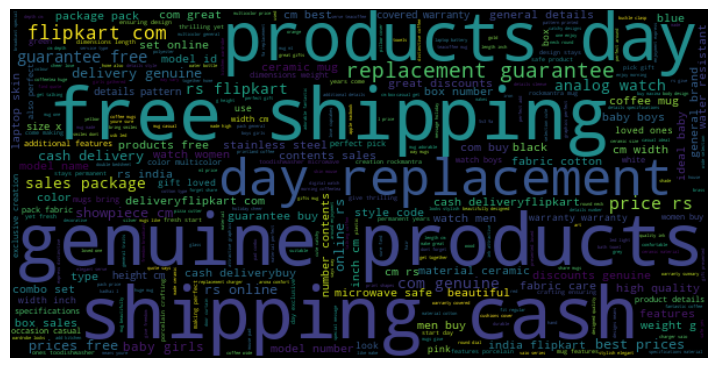

In [92]:
wordcloud(corpus_final)

Nous observons dans notre wordcloud, que les mots qui apparaissent semblent être des mots assez **généralistes** (free, shipping, genuine, products, ...). On va donc reprendre notre liste des mots les plus fréquents : 

In [93]:
# Affichons les 30 tokens les plus nombreux 

most_freq = pd.DataFrame(tmp.head(30))
most_freq.reset_index()

,index,0
0,rs,911
1,products,635
2,free,613
3,genuine,564
4,cash,564
5,shipping,564
6,replacement,559
7,day,538
8,cm,504
9,30,495


On va supprimer les 18 mots les plus fréquents en les ajoutant dans une liste. Les mots apparaissant ensuite, à partir de watch, pourraient être utiles pour les catégories. 

In [94]:
# Ajout des 18 mots les plus fréquents à une liste
most_freq_words = most_freq.head(18).index.tolist()
most_freq_words

['rs',
 'products',
 'free',
 'genuine',
 'cash',
 'shipping',
 'replacement',
 'day',
 'cm',
 '30',
 'guarantee',
 'com',
 '1',
 'flipkart',
 'online',
 'features',
 'buy',
 'price']

In [95]:
# Création de notre fonction de nettoyage finale

def final_clean(df):

    # Mise en minuscule
    doc = df.lower()

    # Tokenisation
    tokens = word_tokenize(doc)
    
    # Suppression ponctutation
    exclude = set(string.punctuation)
    exclude.remove(".")
    
    for punctuation in exclude:
        doc = doc.replace(punctuation,"")

    doc = doc.replace("."," ")
    doc = doc.split()

    # Suppression mots de liaison
    stop_words = set(stopwords.words('english')) # ANaltica
    doc = [x for x in doc if x not in stop_words]

    # Lemmatisation
    lemmatizer = WordNetLemmatizer()
    lemmatizer_text = [lemmatizer.lemmatize(word) for word in doc]

    # Suppression des mots fréquents
    doc = [word for word in lemmatizer_text if word not in most_freq_words]
    
    # Suppression des mots rares/uniques
    doc = [word for word in doc if word not in liste_unique_tokens]
    
    # Suppression des mots courts (< 3 lettres)
    len_words = pd.Series(doc).apply(len)
    len_words = pd.DataFrame({"words" : pd.Series(doc),
                              "longueur" : pd.Series(doc).apply(len)})
    len_inf_3 = len_words[len_words['longueur'] < 3]
    liste_tokens_courts = len_inf_3['words'].tolist()
    doc = [x for x in doc if x not in liste_tokens_courts]

    # Suppression des mots non alphabétiques
    doc = [x for x in doc if x.isalpha()]

    return doc

In [96]:
# Regardons à nouveau notre nombre de tokens
corpus_clean = final_clean(corpus)
print(f"nb tokens {len(corpus_clean)}, nb tokens uniques {len(set(corpus_clean))}")
print(corpus_clean[:30])

nb tokens 43152, nb tokens uniques 3252
['key', 'feature', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'height', 'pack', 'curtain', 'enhances', 'look', 'interior', 'curtain', 'made', 'high', 'quality', 'polyester', 'fabric', 'feature', 'eyelet']


In [328]:
# On applique notre nettoyage en créant une nouvelle variable
data['description_clean'] = data['description'].apply(final_clean)
data['description_clean'] = data['description_clean'].apply(' '.join)

In [98]:
# On crée à nouveau notre corpus final
corpus_final = "".join(data.description_clean.values)

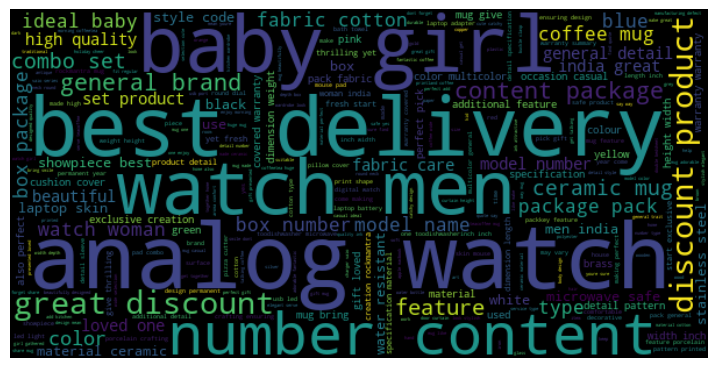

In [99]:
wordcloud(corpus_final)

Après suppression des 18 mots les plus fréquents, des mots rares et des mots non alphabétiques, on obtient un nouveau wordcloud. Les mots semblent déjà moins généralistes et donnent plus d'informations sur les différents produits. 

#### b. Corpus par catégorie

Nous allons maintenant regarder le wordcloud pour chaque **catégorie générale**.

------------------------
Dataframe des produits de la catégorie: Home Furnishing


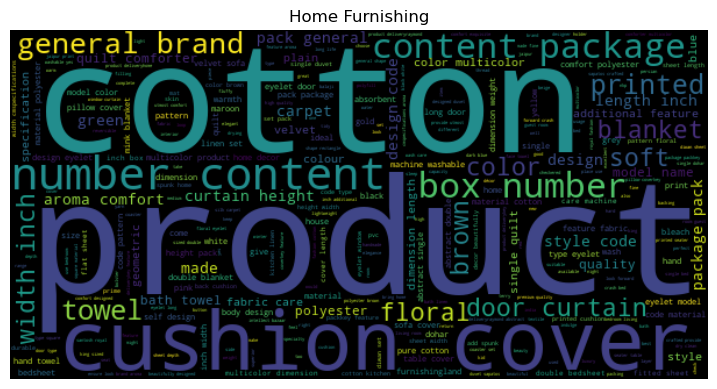

------------------------
Dataframe des produits de la catégorie: Baby Care


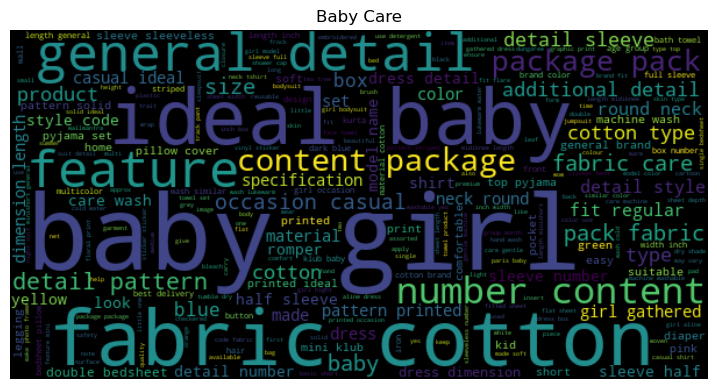

------------------------
Dataframe des produits de la catégorie: Watches


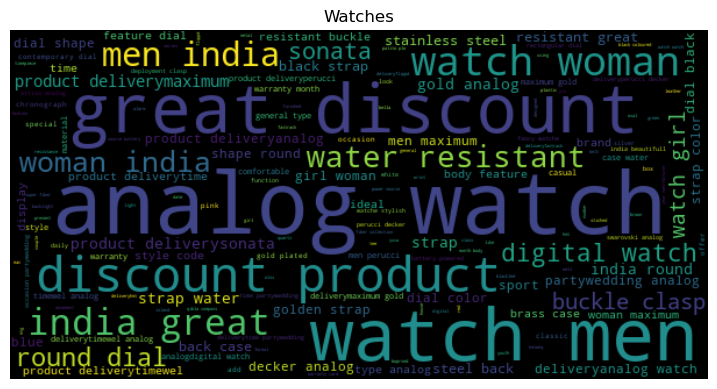

------------------------
Dataframe des produits de la catégorie: Home Decor & Festive Needs


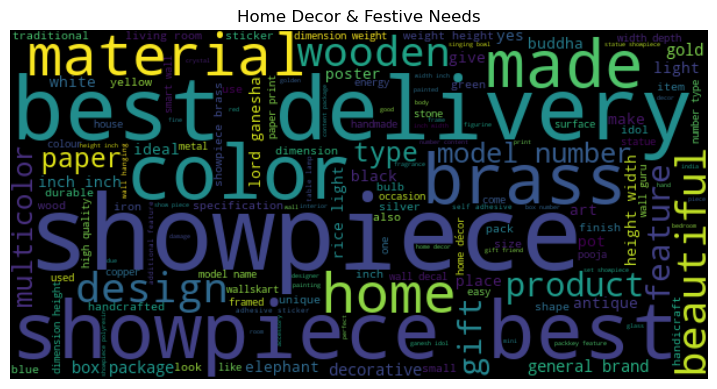

------------------------
Dataframe des produits de la catégorie: Kitchen & Dining


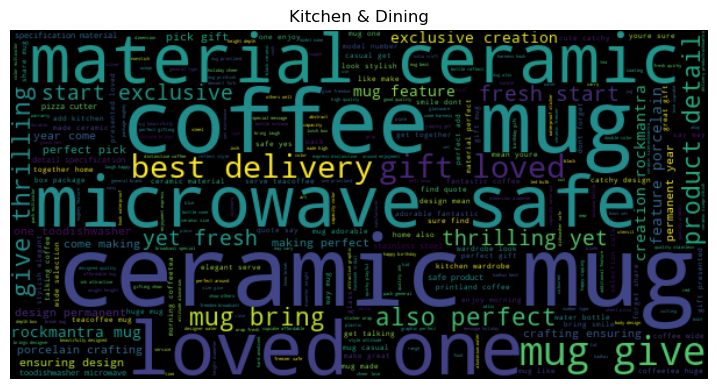

------------------------
Dataframe des produits de la catégorie: Beauty and Personal Care


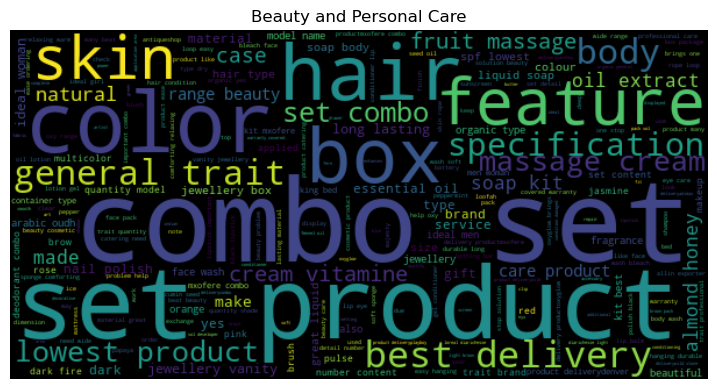

------------------------
Dataframe des produits de la catégorie: Computers


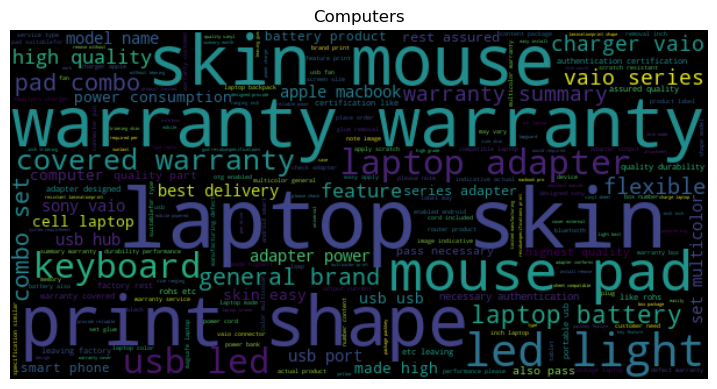

In [100]:
# On crée une liste de nos différentes catégories
categ = data['categ_generale'].unique().tolist()

# On crée un dataframe par catégorie
for i in categ:
    df_categ = data[data['categ_generale'] == i]
    print('------------------------')
    print('Dataframe des produits de la catégorie:', i)

    # Pour chaque DataFrame, on crée notre corpus
    corpus_categ = "".join(df_categ.description_clean.values)
    
    # On affiche le wordcloud de chaque catégorie
    wordcloud(corpus_categ)
    plt.title(i)
    plt.show()

Pour chaque catégorie, nous pouvons déjà observer des mots-clés caractéristiques qui ressortent :
- <u>Home furnishing</u> : cotton, cushion, cover, aroma, comfort, ... 
- <u>Baby care</u> : baby, girl, fabric, cotton, package, ...
- <u>Watches</u> : watch, men, analog, discount, woman, ...
- <u>Home Decor & Festive Needs</u> : material, delivery, showpiece, home, brass, ...
- <u>Kitchen & Dining</u> : coffee, mug, loved, weramic, microwave, ...
- <u>Beauty and Personal Care</u> : hair, product, box, set, skin, ...
- <u>Computers</u> : mouse, laptop, warranty, shape, skin, pad, led, light, ...

### 6.3.7. Features construction de type bag-of-words (CountVectorizer, Tf-idf)

Avant d'utiliser des modèles de Machine Learning ou Deep Learning, il est nécessaire de **transformer les données textuelles en données numériques** afin de les utiliser pour les tâches de traitement du langage naturel (NLP).  

La construction de features de type Bag-Of-Words et la création d'embeddings de mots sont des approches complémentaires. 

Le modèle Bag-of-Words possède des outils de vectorisation du texte en représentant des "sacs de mots" à partir d'un corpus de texte. Les outils que l'on va utiliser sont **CountVectorizer** et **Tf-idf** qui ont des fonctions presque similaires, ils vont convertir de le corpus de texte en une matrice d'occurrence de mots, chaque ligne correspondant à un document et chaque colonne correspondant à un mot. La différence entre CountVectorizer et Tf-idf réside dans le fait que CountVectorizer va uniquement compter le nombre d'occurrence de chaque mot alors que Tf-idf va donner une importance aux mots en fonction de leur fréquence dans le document et dans l'ensemble du corpus. Il va donner plus de poids aux mots importants dans un documents donné en réduisant le poids des mots communs présents dans le corpus.
Les mots très fréquents ont un faible score Tf-idf car ils ne sont pas spécifiques à un document particulier, alors que les mots peu fréquents ont un Tf-idf plus élevé car ils ont une plus grande influence sur la représentation du document.



### a. CountVectorizer

**CountVectorizer** convertit chaque document en une liste de mots, puis créer une matrice où chaque ligne correspond à un document et chaque colonne correspond à un mot du document. La valeur obtenue dans chaque cellule de la matrice représente le nombre d'occurrences du mot dans le document associé. 

<u>Hyperparamètres</u> : 

- **max_df** : seuil de fréquence maximal (en proportion) au-dela duquel un mot est considéré comme trop fréquent. 
- **min_df** : seuil de fréquence minimal (en nombre de documents) en-dessous duquel un mot sera ignoré.
- **stop_words** : mots à ignorer dans une liste prédéfinie en anglais. 

In [239]:
# On récupère une liste des différentes catgéories générales

l_cat = list(set(data['categ_generale']))
print("catégories : ", l_cat)
y_cat_num = [(1-l_cat.index(data.iloc[i]['categ_generale'])) for i in range(len(data))]

catégories :  ['Computers', 'Home Decor & Festive Needs', 'Baby Care', 'Kitchen & Dining', 'Beauty and Personal Care', 'Home Furnishing', 'Watches']


In [240]:
from sklearn import manifold, decomposition
from sklearn import cluster, metrics
import time


# Calcul Tsne, détermination des clusters et calcul ARI entre vraies catégories et n° de clusters
def ARI_fct(features) :
    time1 = time.time()
    num_labels=len(l_cat)
    tsne = manifold.TSNE(n_components=2, perplexity=30, n_iter=2000, 
                                 init='random', learning_rate=200, random_state=42)
    X_tsne = tsne.fit_transform(features)
    
    # Détermination des clusters à partir des données après Tsne 
    cls = cluster.KMeans(n_clusters=num_labels, n_init=100, random_state=42)
    cls.fit(X_tsne)
    ARI = np.round(metrics.adjusted_rand_score(y_cat_num, cls.labels_),4)
    time2 = np.round(time.time() - time1,0)
    print("ARI : ", ARI, "time : ", time2)
    
    return ARI, X_tsne, cls.labels_, y_cat_num

In [329]:
# On veut récupérer la fréquence d'apparition de chaque mot dans une matrice
# avec CountVectorizer

from sklearn.feature_extraction.text import CountVectorizer

# On va ignorer les mots qui apparaissent dans plus de 95% des documents et les mots qui 
# apparaissent dans moins de 2 documents

cv = CountVectorizer(max_df=0.95, min_df=1,
                     stop_words='english')
cv.fit(data['description_clean'])
print ("Taille: {}",  len (cv.vocabulary_))
print ("Contenu: {}",  cv.vocabulary_)

Taille: {} 3118
Contenu: {} {'key': 1501, 'feature': 1034, 'elegance': 898, 'polyester': 2094, 'multicolor': 1800, 'abstract': 13, 'eyelet': 997, 'door': 836, 'curtain': 692, 'floral': 1089, 'height': 1288, 'pack': 1947, 'enhances': 922, 'look': 1618, 'interior': 1427, 'high': 1296, 'quality': 2210, 'fabric': 1000, 'style': 2702, 'stitch': 2668, 'metal': 1732, 'ring': 2348, 'make': 1668, 'room': 2365, 'environment': 940, 'ant': 108, 'anti': 110, 'shrinkage': 2517, 'elegant': 899, 'home': 1317, 'bright': 348, 'appeal': 126, 'design': 764, 'attention': 178, 'sure': 2741, 'heart': 1285, 'contemporary': 605, 'slide': 2561, 'smoothly': 2579, 'draw': 841, 'apart': 120, 'thing': 2817, 'morning': 1782, 'welcome': 3038, 'sun': 2720, 'ray': 2248, 'want': 3004, 'wish': 3070, 'good': 1209, 'world': 3084, 'evening': 957, 'create': 664, 'special': 2619, 'moment': 1773, 'beauty': 250, 'given': 1187, 'soothing': 2604, 'print': 2153, 'bring': 354, 'filter': 1059, 'light': 1585, 'right': 2347, 'sunlight

Le vocabulaire de notre corpus est constitué de 3118 mots apparaissant dans moins de 95% des documents et apparaissant dans plus d'1 document. 

In [331]:
# Comptage sur la liste de documents en construisant une matrice de fréquence de mots
# Chaque ligne correspond à un document et chaque colonne correspond à un mot. 

cv_transform = cv.fit_transform(data['description_clean']).toarray() #Comptage sur la liste de documents

# Affichage de la matrice
print(cv_transform)

# On récupère le nom des colonnes
feature_names = cv.get_feature_names_out()

# On créer notre dataframe
df_cv_transform = pd.DataFrame(cv_transform,
                               columns = feature_names)
df_cv_transform.head()

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


,aapno,aari,ability,abklgrngrngrn,abklplplpnk,abklplpnkpnk,able,abode,abrasion,abroad,...,youth,youthful,yuva,zero,zinc,zingalalaa,zipper,zone,zora,zyxel
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


On vérifie en sélectionnant un document aléatoire.

In [339]:
# Sélection d'un document au hasard
document = data.description_clean.sample(1)
print(document.values)

# On obtient les valeurs des features bag-of-words correspondantes
bow_features_cv = cv.transform(document).toarray()[0]

# On affiche les valeurs des features bag-of-words
for i, feature in enumerate(cv.get_feature_names_out()):
    print(f"{feature}: {bow_features_cv[i]}")

['mesleep abstract cushion cover product delivery']
aapno: 0
aari: 0
ability: 0
abklgrngrngrn: 0
abklplplpnk: 0
abklplpnkpnk: 0
able: 0
abode: 0
abrasion: 0
abroad: 0
absorbency: 0
absorbent: 0
absorbing: 0
abstract: 1
accent: 0
access: 0
accessory: 0
accident: 0
accidental: 0
according: 0
ache: 0
acid: 0
acne: 0
acrylic: 0
act: 0
active: 0
actual: 0
adaa: 0
adapter: 0
adaptor: 0
add: 0
adding: 0
addition: 0
additional: 0
adhesive: 0
adi: 0
adidas: 0
adjustable: 0
adjusts: 0
admiration: 0
admired: 0
adorable: 0
adorn: 0
adorned: 0
adorning: 0
adsl: 0
advance: 0
advice: 0
aero: 0
affect: 0
affordable: 0
afternoon: 0
age: 0
agrasen: 0
agromech: 0
aid: 0
aiding: 0
air: 0
airtex: 0
airtight: 0
akshaj: 0
akup: 0
alarm: 0
alarmhour: 0
aleo: 0
alfajr: 0
aline: 0
alinespecifications: 0
allin: 0
allow: 0
allowed: 0
allowing: 0
allows: 0
alloy: 0
allpurpose: 0
alluring: 0
ally: 0
almond: 0
aloe: 0
aloevera: 0
alphabet: 0
alternative: 0
alternatively: 0
aluminium: 0
amaze: 0
amazed: 0
amazing: 0


In [340]:
ARI, X_tsne, labels, y_cat_num = ARI_fct(cv_transform)

ARI :  -0.0023 time :  65.0


### b. Tf-idf

**TfidfVectorizer** convertit chaque document en une liste de mots, puis créer une matrice où chaque ligne correspond à un document et chaque colonne correspond à un mot du document, comme le fait CountVectorizer. Mais elle va utiliser la méthode Tf-idf (Term Frequency - Inverse Document Frequency) afin d'obtenir une représentation vectorielle des documents prenant en compte la fréquence des mots dans les documents, en accordant plus de poids aux mots apparaissant fréquemment dans le document en question, et en diminuant le poids des mots apparaissant fréquemment dans le corpus. 

In [107]:
from sklearn.feature_extraction.text import TfidfVectorizer

ctf = TfidfVectorizer(max_df=0.95, min_df=1,
                     stop_words='english')

ctf_transform = ctf.fit_transform(data['description_clean'])

# On affiche la matrice
print(ctf_transform.toarray())

# On récupère le nom des colonnes
feature_names = ctf.get_feature_names_out()

# On créer notre dataframe
df_ctf_transform = pd.DataFrame(ctf_transform.toarray(),
                               columns = feature_names)
df_ctf_transform.head()

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


,aapno,aari,ability,abklgrngrngrn,abklplplpnk,abklplpnkpnk,able,abode,abrasion,abroad,...,youth,youthful,yuva,zero,zinc,zingalalaa,zipper,zone,zora,zyxel
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


On va vérifier en sélectionnant un document aléatoire.

In [108]:
# Sélection d'une ligne au hasard
document = data.description_clean.sample(1)
print(document.values)

# Obtenir les valeurs des features bag-of-words correspondantes pour le document sélectionné
bow_features = ctf.transform(document).toarray()[0]
bow_features

# Afficher les valeurs des features bag-of-words
for i, feature in enumerate(ctf.get_feature_names_out()):
    print(f"{feature}: {bow_features[i]}")

['printland ceramic mug printland ceramic mug best delivery product']
aapno: 0.0
aari: 0.0
ability: 0.0
abklgrngrngrn: 0.0
abklplplpnk: 0.0
abklplpnkpnk: 0.0
able: 0.0
abode: 0.0
abrasion: 0.0
abroad: 0.0
absorbency: 0.0
absorbent: 0.0
absorbing: 0.0
abstract: 0.0
accent: 0.0
access: 0.0
accessory: 0.0
accident: 0.0
accidental: 0.0
according: 0.0
ache: 0.0
acid: 0.0
acne: 0.0
acrylic: 0.0
act: 0.0
active: 0.0
actual: 0.0
adaa: 0.0
adapter: 0.0
adaptor: 0.0
add: 0.0
adding: 0.0
addition: 0.0
additional: 0.0
adhesive: 0.0
adi: 0.0
adidas: 0.0
adjustable: 0.0
adjusts: 0.0
admiration: 0.0
admired: 0.0
adorable: 0.0
adorn: 0.0
adorned: 0.0
adorning: 0.0
adsl: 0.0
advance: 0.0
advice: 0.0
aero: 0.0
affect: 0.0
affordable: 0.0
afternoon: 0.0
age: 0.0
agrasen: 0.0
agromech: 0.0
aid: 0.0
aiding: 0.0
air: 0.0
airtex: 0.0
airtight: 0.0
akshaj: 0.0
akup: 0.0
alarm: 0.0
alarmhour: 0.0
aleo: 0.0
alfajr: 0.0
aline: 0.0
alinespecifications: 0.0
allin: 0.0
allow: 0.0
allowed: 0.0
allowing: 0.0
allows: 

In [109]:
print("CountVectorizer : ")
print("-----------------")
ARI_cv, X_tsne_cv, labels_cv, y_cat_num_cv = ARI_fct(cv_transform)

print("Tf-idf : ")
print("--------")
ARI_ctf, X_tsne_ctf, labels_ctf, y_cat_num_ctf = ARI_fct(ctf_transform)

CountVectorizer : 
-----------------
ARI :  0.497 time :  81.0
Tf-idf : 
--------
ARI :  0.5074 time :  79.0


<u>Nécessité de réduction de dimension</u> : 

La matrice obtenue après features extraction étant très grande, il est utile d'effectuer une réduction de dimension de cette matrice afin de conserver les informations les plus pertinentes. L'idée étant de créer de nouvelles features permettant de gagner en temps de calcul et de conserver l'information utile à la classification. On va utiliser 2 techniques de réduction de dimension : **ACP et t-SNE**. 

#### c. Réduction en 2 dimensions

- **<u>T-SNE</u>**

La méthode **<u>t-SNE</u>** (t-distributed Stochastic Neighbor Embedding) est une technique de réduction de dimension non linéaire pouvant être représenté dans un espace à 2 dimensions. Il se base sur une distribution de probabilités représentant les similarités entre voisins. Les points proches ont une forte probabilité d'être choisis, tandis que des points éloignés ont une faible probabilité d'être choisis. 

Le calcul du **<u>score ARI</u>** (Adjusted Rand Index) va permettre d'évaluer la **qualité des clusters** après la vectorisation du texte par CountVectorizer et TfidfVectorizer. Il va comparer les clusters obtenus avec des groupes/clusters de référence (vraies étiquettes) et fournir un score de similitude entre les deux. La fonction ARI permet de déterminer les clusters après T-SNE entre les vraies catégories et les clusters. 

Nous allons donc visualiser le T-SNE entre les vraies catégories et les clusters:

In [110]:
# visualisation du Tsne selon les vraies catégories et selon les clusters
def TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI) :
    fig = plt.figure(figsize=(15,6))
    
    ax = fig.add_subplot(122)
    scatter = ax.scatter(X_tsne[:,0],X_tsne[:,1], c=y_cat_num, cmap='Set1')
    ax.legend(handles=scatter.legend_elements()[0], labels=l_cat,
              bbox_to_anchor=(1, 1), loc='upper left', title="Categorie")
    plt.title('Représentation des produits par catégories générales')
    
    ax = fig.add_subplot(121)
    scatter = ax.scatter(X_tsne[:,0],X_tsne[:,1], c=labels, cmap='Set1')
    ax.legend(handles=scatter.legend_elements()[0], labels=set(labels),
              bbox_to_anchor=(1, 1), loc='upper left', title="Clusters")
    plt.title('Représentation des produits par clusters')
    
    plt.show()
    print("ARI : ", ARI)

CountVectorizer : 


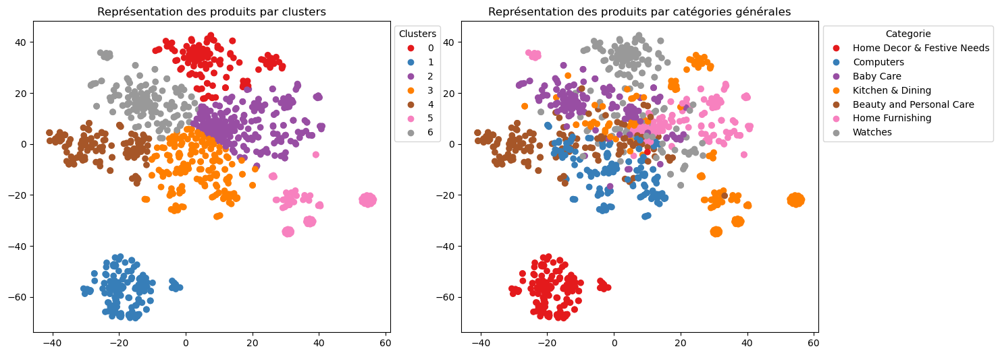

ARI :  0.497
------------------------
Tf-idf : 


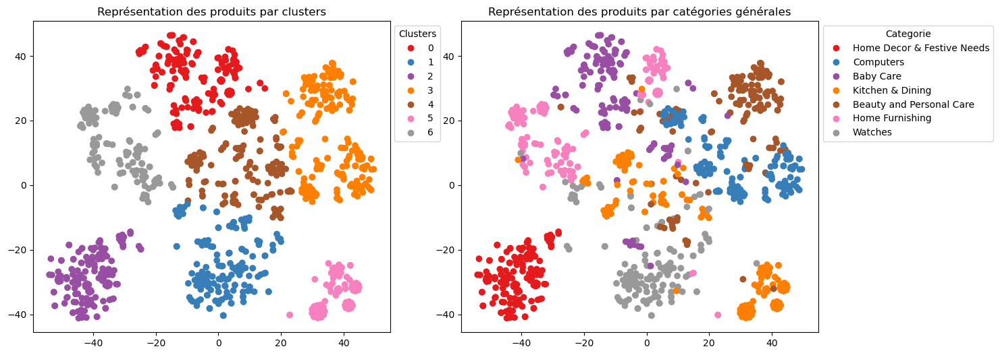

ARI :  0.5074


In [111]:
# Affichons les graphiques des produits par clusters et par catégories générales
print("CountVectorizer : ")
TSNE_visu_fct(X_tsne_cv, y_cat_num, labels_cv, ARI_cv)
print('------------------------')
print("Tf-idf : ")
TSNE_visu_fct(X_tsne_ctf, y_cat_num, labels_ctf, ARI_ctf)

Les graphiques montrent les différents clusters obtenus par le modèle et des catégories réelles par la réduction de dimension T-SNE.

- **<u>ACP</u>**

L'**<u>ACP</u>** (Analyse en Composantes Principales) est une méthode de réduction de dimension transformant des variables corrélées en variables décorrélées les unes des autres, l'idée étant de conserver au mieux la variance des données. 

In [112]:
from matplotlib.collections import LineCollection
from sklearn.decomposition import PCA
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from matplotlib.collections import LineCollection
from sklearn.metrics import silhouette_score

def ACP(matrice, n_components, val_PC1, val_PC2):

    # Instanciation
    sc = StandardScaler()

    # Transformation – centrage-réduction
    Z = sc.fit_transform(matrice)
    
    # Instanciation
    acp = PCA(svd_solver='full')

    # Calculs
    coord = acp.fit_transform(Z)

    # Nombre de composantes calculées
    n = acp.n_components_
    print('Nombre de composantes calculées :', n)

    # Variance expliquée
    eigval = (n-1)/n*acp.explained_variance_

    # Proportion de variance expliquée
    p = acp.explained_variance_ratio_
    
    # Cumul de variance expliquée
    plt.figure(figsize = (8,5))
    plt.grid()
    plt.bar(range(1, n+1), acp.explained_variance_ratio_)
    plt.plot(range(1, n+1), np.cumsum(acp.explained_variance_ratio_).round(2),
             c='red', marker='o')
    plt.ylabel('Eboulis des valeurs propres')
    plt.xlabel('Composantes principales')
    plt.title('Pourcentage de la variance')
    
    # Trace de la droite pour 80% de la variance expliquée
    lc1 = LineCollection([[(0, 0.8), (n, 0.8)]], colors='green', linestyles='dashed')
    plt.gca().add_collection(lc1)

    # Trace de la droite pour 90% de la variance expliquée
    lc2 = LineCollection([[(0, 0.9), (n, 0.9)]], colors='orange', linestyles='dashed')
    plt.gca().add_collection(lc2)

    # Indice du premier élément de la liste >= 0.8
    index_80 = np.where(np.cumsum(p) >= 0.8)[0][0]
    print("Nombre de composantes pour 80% de la variance expliquée :", index_80 + 1)
    plt.axvline(x=index_80+1, color='green', linestyle='dashed')
    
    # Indice du premier élément de la liste >= 0.8
    index_90 = np.where(np.cumsum(p) >= 0.9)[0][0]
    print("Nombre de composantes pour 90% de la variance expliquée :", index_90 + 1)
    plt.axvline(x=index_90+1, color='orange', linestyle='dashed')

    plt.show(block=False)
    
    # Contribution des individus dans l'inertie totale
    di = np.sum(Z**2, axis=1)
    di = pd.DataFrame({'ID': matrice.index, 'd_i': di})

    # Racine carrée des valeurs propres
    sqrt_eigval = np.sqrt(eigval)
    
    # Corrélation des variables avec les axes
    corvar = np.zeros((n, n))
    for k in range(n):
        corvar[:, k] = acp.components_[:n_components, k] * sqrt_eigval[k]
    
    # Cercle des corrélations
    fig, axes = plt.subplots(figsize=(8, 8))
    axes.set_xlim(-1, 1)
    axes.set_ylim(-1, 1)

    # On affiche les plans (0, 1) correspondent par exemple à F1 et F2
    x, y = (val_PC1, val_PC2)

    # Affichage des étiquettes (noms des variables)
    for j in range(n):
        plt.annotate(matrice.columns[j], (corvar[j, x], corvar[j, y]))

    # Ajouter les axes
    plt.plot([-1, 1], [0, 0], color='silver', linestyle='-', linewidth=1)
    plt.plot([0, 0], [-1, 1], color='silver', linestyle='-', linewidth=1)

    # Pour chaque composante :
    for i in range(0, acp.components_.shape[1]):

        # Les flèches
        axes.arrow(0, 0, acp.components_[x, i], acp.components_[y, i],
                   head_width=0.07, head_length=0.07, width=0.02)

    # Si la variable pca a été fournie, on peut calculer le % de variance
    # de chaque axe
    if acp:
        v1 = str(round(100*p[x], 1)) + " %"
        v2 = str(round(100*p[y], 1)) + " %"
    else:
        v1 = v2 = ''

    # Nom des axes, avec le pourcentage d'inertie expliqué
    axes.set_xlabel(f'F{x+1} {v1}', size=13)
    axes.set_ylabel(f'F{y+1} {v2}', size=13)

    # Titre
    plt.title("Cercle des corrélations (F{} et F{})".format(x+1, y+1), size=15)

    # Ajouter un cercle
    cercle = plt.Circle((0, 0), 1, color='blue', fill=False)
    axes.add_artist(cercle)

    # Affichage
    plt.show()
    
    # Cosinus carré des variables
    cos2var = corvar**2
    
    # Contributions
    ctrvar = cos2var
    for k in range(n):
        ctrvar[:,k] = ctrvar[:,k]/eigval[k]
    
    # Traitement de la variable 'catégories' supplémentaire
    categ = data.loc[:, data.columns == 'categ_generale']
    
    # Modalités de la variable qualitative
    modalites = np.unique(categ)
    
    # Liste des couleurs
    couleurs = ['green', 'blue','gold', 'darkorange', 'red', 'black', 'pink']
    
    # Faire un graphique en coloriant les points
    fig, axes = plt.subplots(figsize=(15,10))

    x, y = (val_PC1, val_PC2)
    
    # Liste vide pour stocker les points de la légende
    legend_points = []

    ## Pour afficher les points en couleur
    # pour chaque modalité de la var. illustrative
    for c in range(len(modalites)):
     # Numéro des individus concernés
        numero = np.where(categ == modalites[c])
        # Créer un point proxy pour la légende
        legend_point = plt.Line2D([0], [0], linestyle="none", marker="o",
                                  alpha=0.8, markersize=10, markerfacecolor=couleurs[c])
        # Ajouter le point proxy à la liste des points de la légende
        legend_points.append(legend_point)
        # Les passer en revue pour affichage
        for i in numero[0]:
            plt.scatter(coord[i,x],coord[i,y], color=couleurs[c])

    # Traçage des axes
    axes.axvline(x=0, color='gray', linestyle='--', linewidth=1)
    axes.axhline(y=0, color='gray', linestyle='--', linewidth=1)

        # Si la variable pca a été fournie, on peut calculer le % de variance de chaque axe 
    if acp : 
        v1 = str(round(100*p[x], 1))  + " %"
        v2 = str(round(100*p[y], 1))  + " %"
    else : 
        v1=v2= ''

        # Nom des axes, avec le pourcentage d'inertie expliqué
    axes.set_xlabel(f'F{x+1} {v1}', size = 15)
    axes.set_ylabel(f'F{y+1} {v2}', size = 15)

    # Titre et display
    plt.title(f"Projection des individus (sur F{x+1} et F{y+1})", size = 18)
    
    # Légende
    plt.legend(legend_points, modalites, loc='upper right')

    #affichage
    plt.show()

In [113]:
def ACP_ari(nb_comp, features):
    time1 = time.time()
    num_labels=len(l_cat)
    
    pca = PCA(n_components=nb_comp, random_state=42)
    features_pca = pca.fit_transform(features)
    
    # Détermination des clusters à partir des données après ACP
    cls = cluster.KMeans(n_clusters=num_labels, n_init=100, random_state=42)
    cls.fit(features_pca)
    ARI = np.round(metrics.adjusted_rand_score(y_cat_num, cls.labels_),4)
    time2 = np.round(time.time() - time1,0)
    print("ARI : ", ARI, "time : ", time2)
    
    return ARI, features_pca, cls.labels_

In [114]:
# visualisation de l'ACP selon les vraies catégories et selon les clusters
def ACP_visu_fct(features_pca, y_cat_num, labels, ARI) :
    fig = plt.figure(figsize=(15,6))
    
    ax = fig.add_subplot(122)
    scatter = ax.scatter(features_pca[:,0],features_pca[:,1], c=y_cat_num, cmap='Set1')
    ax.legend(handles=scatter.legend_elements()[0], labels=l_cat,
              bbox_to_anchor=(1, 1), loc='upper left', title="Categorie")
    plt.title('Représentation des produits par catégories générales')
    
    ax = fig.add_subplot(121)
    scatter = ax.scatter(features_pca[:,0],features_pca[:,1], c=labels, cmap='Set1')
    ax.legend(handles=scatter.legend_elements()[0], labels=set(labels),
              bbox_to_anchor=(1, 1), loc='upper left', title="Clusters")
    plt.title('Représentation des produits par clusters')
    
    plt.show()
    print("ARI : ", ARI)

ACP CountVectorizer
Nombre de composantes calculées : 1050
Nombre de composantes pour 80% de la variance expliquée : 249
Nombre de composantes pour 90% de la variance expliquée : 372


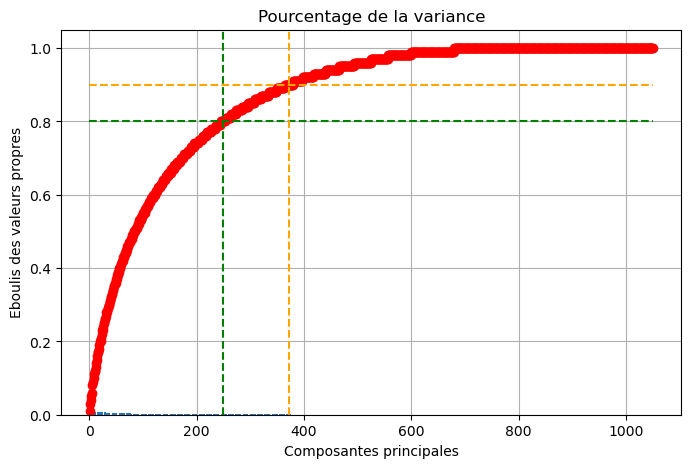

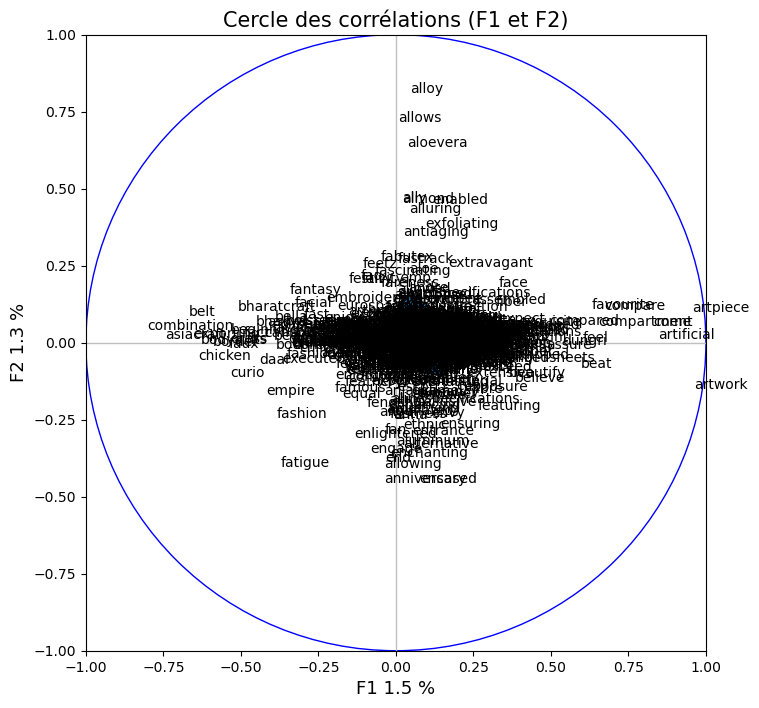

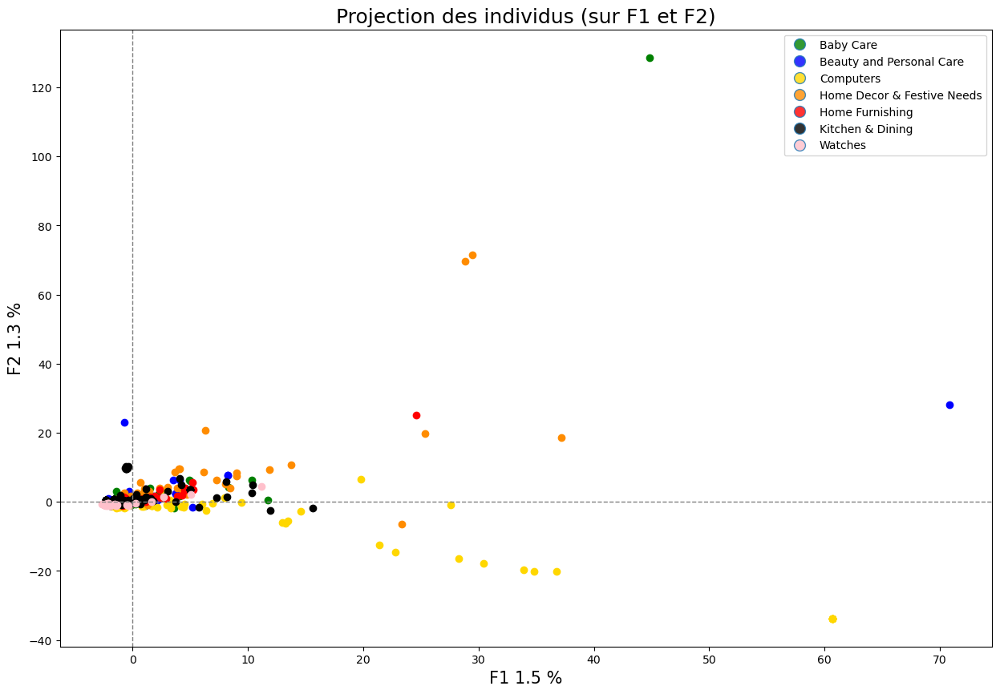

ACP Tf-idf
Nombre de composantes calculées : 1050
Nombre de composantes pour 80% de la variance expliquée : 318
Nombre de composantes pour 90% de la variance expliquée : 456


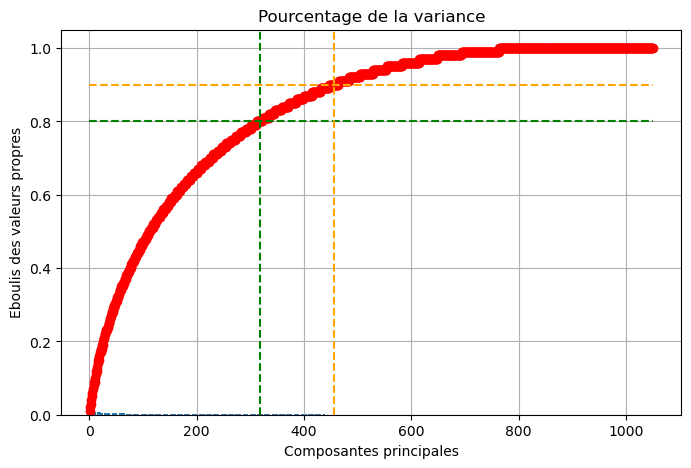

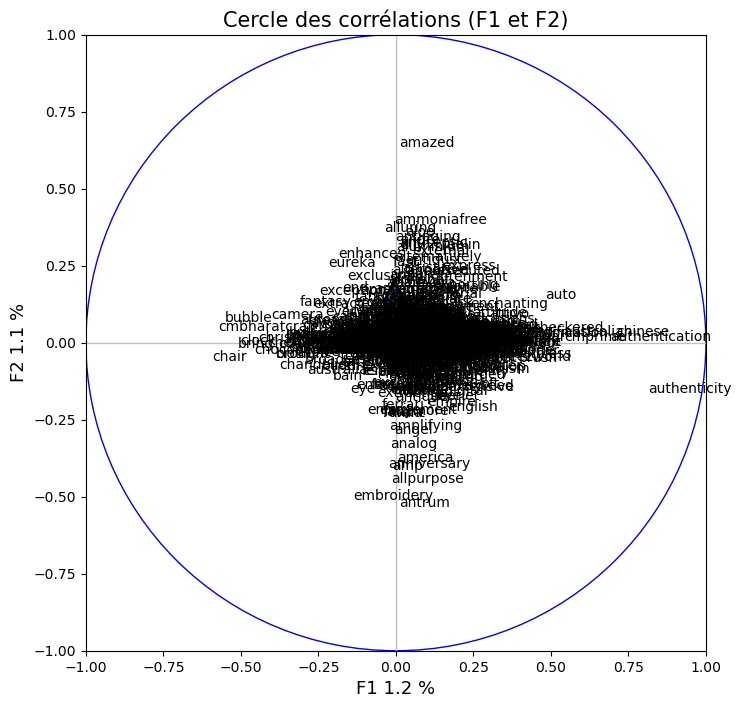

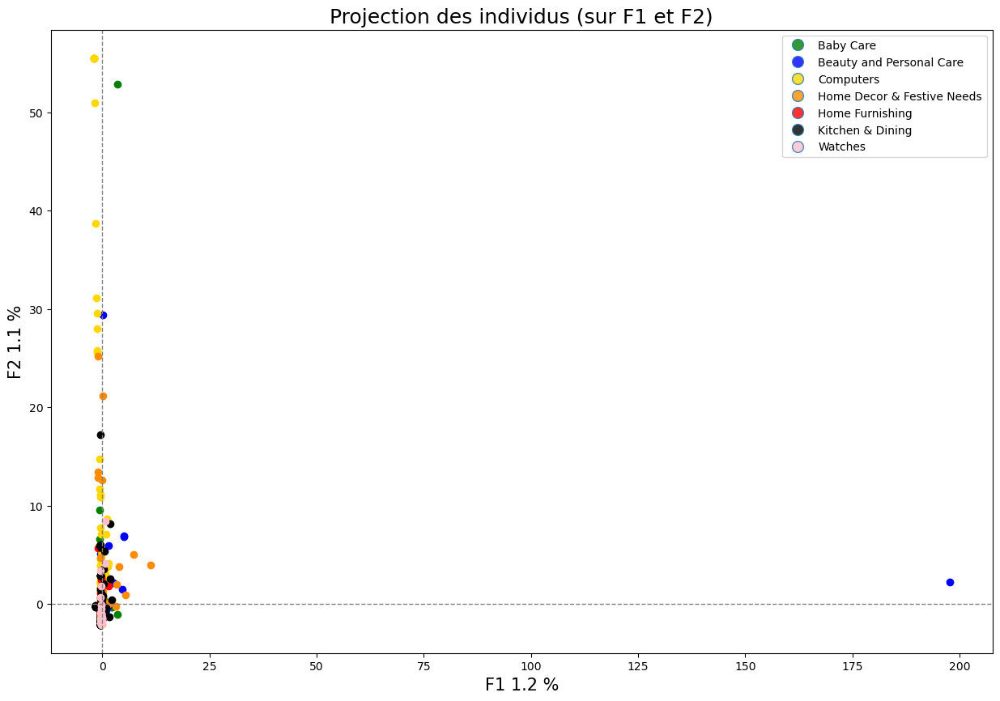

In [115]:
# Création de notre ACP avec cercle des corrélations
# et projection des points (colorés selon leur catégorie)
print('ACP CountVectorizer')
ACP(df_cv_transform, 1050, 0, 1)

print('ACP Tf-idf')
ACP(df_ctf_transform, 1050, 0, 1)

In [116]:
print("CountVectorizer : ")
print("-----------------")
ARI_cv_acp, features_pca_cv, labels_cv_acp = ACP_ari(372, cv_transform.toarray())

print('Silhouette score : ', silhouette_score(cv_transform.toarray(), labels))

print()
print("Tf-idf : ")
print("--------")
ARI_ctf_acp, features_pca_ctf, labels_ctf_acp = ACP_ari(456, ctf_transform.toarray())
print('Silhouette score : ', silhouette_score(ctf_transform.toarray(), labels))

CountVectorizer : 
-----------------
ARI :  0.0495 time :  66.0
Silhouette score :  -0.0777684754325314

Tf-idf : 
--------
ARI :  0.2209 time :  67.0
Silhouette score :  0.05846138178117476


CountVectorizer : 


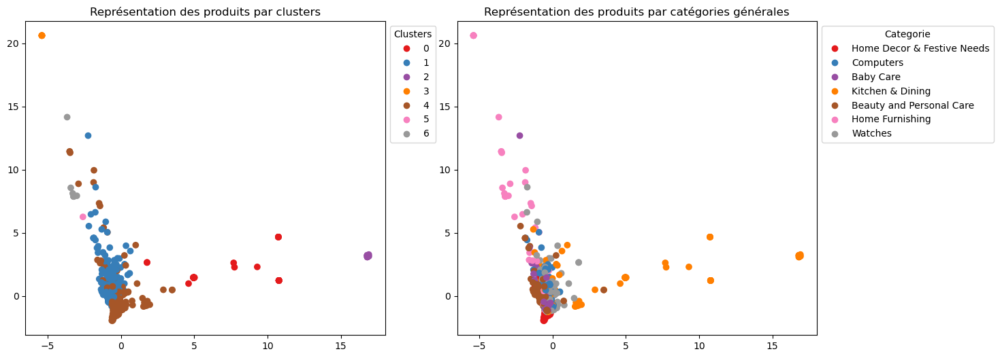

ARI :  0.0495
Tf-idf : 


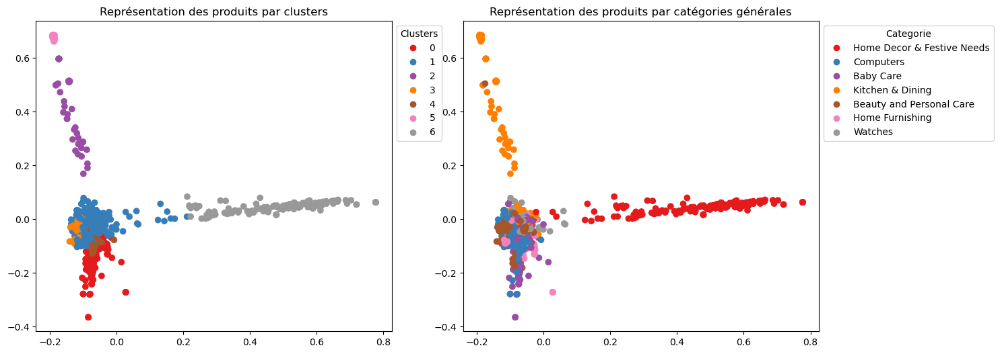

ARI :  0.2209


In [117]:
# Affichons les graphiques des produits par clusters et par catégories générales
print("CountVectorizer : ")
ACP_visu_fct(features_pca_cv, y_cat_num, labels_cv_acp, ARI_cv_acp)
print("Tf-idf : ")
ACP_visu_fct(features_pca_ctf, y_cat_num, labels_ctf_acp, ARI_ctf_acp)

On va maintenant associer **ACP et t-SNE** afin de réduire la dimensionnalité des données dans un premier temps, avant d'effectuer notre t-SNE sur les données transformées par l'ACP. 

- **<u>ACP + t-SNE</u>**

In [118]:
def ACP_TSNE(nb_comp, features):
    # ACP
    nb_comp = nb_comp # Nombre de composantes principales à conserver
    pca = PCA(n_components=nb_comp, random_state=42)
    features_pca = pca.fit_transform(features)

    # t-SNE
    tsne = manifold.TSNE(n_components=2, perplexity=30, n_iter=2000, 
                     init='random', learning_rate=200, random_state=42)
    X_tsne_ACP = tsne.fit_transform(features_pca)
    
    # Clustering et visualisation
    ARI, X_tsne, labels, y_cat_num = ARI_fct(features_pca)
    TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

CountVectorizer :
ARI :  0.4283 time :  77.0


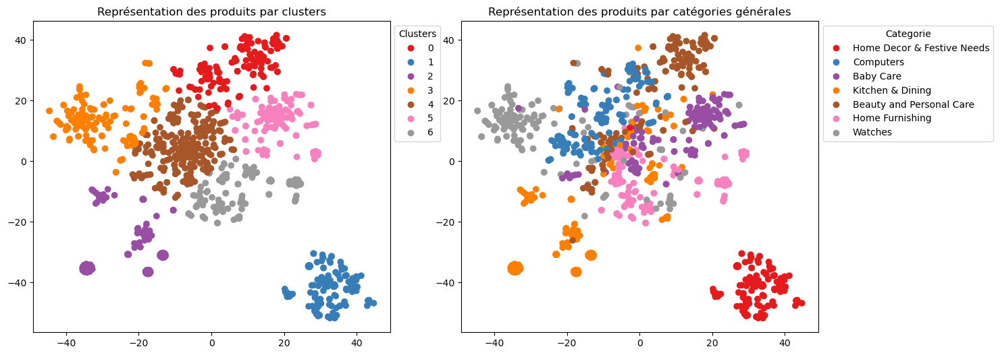

ARI :  0.4283
-------------------
Tf-idf : 
ARI :  0.4598 time :  77.0


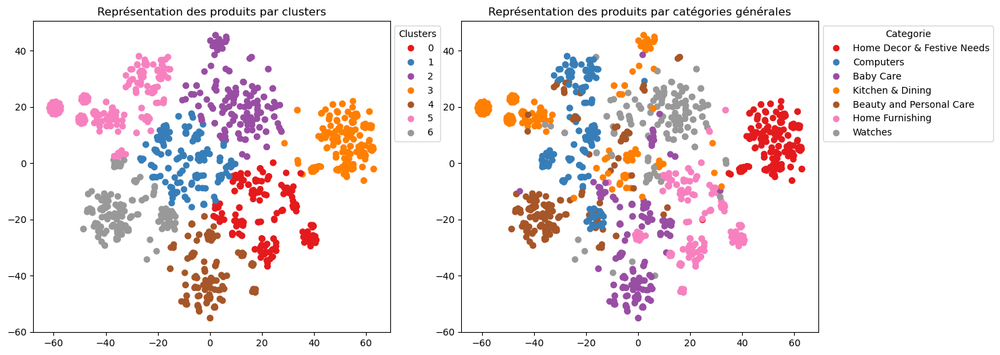

ARI :  0.4598


In [119]:
# Visualisation de nos clusters
print('CountVectorizer :')
ACP_TSNE(372, cv_transform.toarray())
print('-------------------')
print('Tf-idf : ')
ACP_TSNE(456, ctf_transform.toarray())

### 6.3.8. Word/sentence embedding

**<u>Word Embedding</u>** : technique de représentation des mots sous forme de vecteurs de nombres dans un espace vectoriel (méthode d'encodage). Il construit des vecteurs de taille fixe prenant en compte le **contexte des mots**. Nous allons mettre en oeuvre 3 techniques de Word Embedding : 
- Word2Vec
- BERT 
- USE

### a. Word2Vec

**Word2Vec** va identifier les similarités et relations linguistiques entre les mots en utilisant des méthodes de traitement automatique du langage naturel (NLP : Natural Language Processing).

2 techniques d'entrainement de réseaux de neurones : 
- **CBOW (Continuous Bag-Of-Words)** : prédit le mot selon le contexte. On choisit un mot, et par la suite on sélectionne un certain nombre de voisins et on cherche à entrainer le modèle pour qu'il soit capable de prédire le mot dans le cas où on lui fournit uniquement ses voisins. 
- **Skip-gram** : prédit le contexte, selon le mot. A l'inverse de la méthode CBOW, à partir d'un mot, le modèle va chercher à déterminer le contexte associé. 

<img src="CBOW.jpg">

<img src="Skip_gram.jpg">

On crée notre fonction, de la création du modèle Word2Vec à son exécution, utilisant la technique CBOW ou Skip-gram.

In [120]:
pip install tensorflow==2.9.1

In [121]:
import tensorflow as tf
import tensorflow.keras
from tensorflow.keras import backend as K

from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import metrics as kmetrics
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model

In [122]:
import gensim
import numpy as np
from keras.layers import Embedding, Input, GlobalAveragePooling1D
from keras.models import Model
from tensorflow.keras.preprocessing.sequence import pad_sequences
from keras.preprocessing.text import Tokenizer

def train_word2vec_model(data, model_type):

    # Hyperparamètres
    w2v_size = len(cv.vocabulary_)  # Dimensionnalité des vecteurs de mots
    w2v_window = 5  # Taille de la fenêtre de contexte pour apprendre les relations entre les mots
    w2v_min_count = 1  # Nombre min d'occurrences d'un mot pour être pris en compte dans le vocabulaire
    w2v_epochs = 100  # Nombre d'itérations sur le corpus d'entrainement
    maxlen = 24  # Longueur max d'une séquence de mots

    # Création du modèle Word2Vec
    sentences = data.to_list()
    sentences = [gensim.utils.simple_preprocess(text) for text in sentences]

    # Entrainement du modèle Word2Vec
    print("Build & train Word2Vec model ...")
    if model_type == 'cbow':
        w2v_model = gensim.models.Word2Vec(min_count=w2v_min_count, window=w2v_window,
                                           vector_size=w2v_size, seed=42, workers=1, sg=0)
    elif model_type == 'skip-gram':
        w2v_model = gensim.models.Word2Vec(min_count=w2v_min_count, window=w2v_window,
                                           vector_size=w2v_size, seed=42, workers=1, sg=1)
    w2v_model.build_vocab(sentences)  # Construction du vocabulaire
    w2v_model.train(sentences, total_examples=w2v_model.corpus_count, epochs=w2v_epochs)
    model_vectors = w2v_model.wv  # Entrainement du modèle
    w2v_words = model_vectors.index_to_key  # Mots et vecteurs de mots extraits pour l'analyse
    print("Vocabulary size: %i" % len(w2v_words))
    print("Word2Vec trained")

    # Préparation des sentences (tokenization)
    print("Fit Tokenizer ...")
    tokenizer = Tokenizer()
    tokenizer.fit_on_texts(sentences)  # Conversion de chaque phrase en liste de tokens
    x_sentences = pad_sequences(tokenizer.texts_to_sequences(sentences),
                                maxlen=maxlen,
                                padding='post')
    num_words = len(tokenizer.word_index) + 1  # Nombre de mots uniques calculé à partir de la taille du dictionnaire
    print("Number of unique words: %i" % num_words)

    # Création de la matrice d'embedding
    print("Create Embedding matrix ...")
    word_index = tokenizer.word_index  # Dictionnaire de mots et leur index correspondant à partir de la tokenisation
    vocab_size = len(word_index) + 1  # Taille du vocabulaire (nombre de mots uniques dans le corpus)
    embedding_matrix = np.zeros((vocab_size, w2v_size))  # Initialisation de la matrice embedding
    i = 0
    j = 0
    
    # Boucle vérifiant si, pour chaque mot du dictionnaire "word_index", le mot est présent
    # dans le vocabulaire du modèle w2v_words_cbow. S'il est présent, le vecteur est récupéré
    # à partir de model_vectors et assigné à la ligne correspondante de "embedding matrix", sinon
    # la ligne reste nulle
    for word, idx in word_index.items():
        i += 1
        if word in w2v_words:
            j += 1
            embedding_vector = model_vectors[word]
            if embedding_vector is not None:
                embedding_matrix[idx] = model_vectors[word]
                np.append(feature_names, word)  # Ajout du nom de chaque mot si un vecteur est dispo

    # Taux d'embedding calculé : 
    # (nombre de mots où vecteur d'embedding disponible/nombre total de mots dans dictionnaire)
    word_rate = np.round(j/i, 4)
    print("Word embedding rate : ", word_rate)
    print("Embedding matrix: %s" % str(embedding_matrix.shape))

      # Création du modèle

    # Couche d'entrée (phrases prétraitées et tokenisées)
    input=Input(shape=(len(x_sentences),maxlen),dtype='float64')
    word_input=Input(shape=(maxlen,),dtype='float64')  

    # Couche d'embedding créée convertissant chaque mot d'une phrase en un vecteur
    word_embedding=Embedding(input_dim=vocab_size,
                             output_dim=w2v_size,
                             weights = [embedding_matrix],
                             input_length=maxlen)(word_input)

    # Couche de Pooling calculant la moyenne des vecteurs d'embedding 
    word_vec=GlobalAveragePooling1D()(word_embedding)  

    # Couche d'entrée reliée à la couche de pooling
    embed_model = Model([word_input],word_vec)

    embed_model.summary()

    # Exécution du modèle
    embeddings = embed_model.predict(x_sentences)
    print(embeddings.shape)
    return embeddings, feature_names

#### - CBOW

In [123]:
# On applique notre fonction de création et exécution de notre modèle Word2Vec
embeddings_cbow, feature_names_cbow = train_word2vec_model(data['description_clean'], 'cbow')

Build & train Word2Vec model ...
Vocabulary size: 3174
Word2Vec trained
Fit Tokenizer ...
Number of unique words: 3175
Create Embedding matrix ...
Word embedding rate :  1.0
Embedding matrix: (3175, 3118)
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 24)]              0         
                                                                 
 embedding (Embedding)       (None, 24, 3118)          9899650   
                                                                 
 global_average_pooling1d (G  (None, 3118)             0         
 lobalAveragePooling1D)                                          
                                                                 
Total params: 9,899,650
Trainable params: 9,899,650
Non-trainable params: 0
_________________________________________________________________
33/33 [==============================] - 0s 

In [124]:
# Création dataframe à partir de la matrice d'embeddings
df_embedding_cbow = pd.DataFrame(data=embeddings_cbow, columns=feature_names_cbow)

#### - Skip-Gram

In [125]:
# On applique notre fonction de création et exécution de notre modèle Word2Vec
embeddings_sg, feature_names_sg = train_word2vec_model(data['description_clean'], 'skip-gram')

Build & train Word2Vec model ...
Vocabulary size: 3174
Word2Vec trained
Fit Tokenizer ...
Number of unique words: 3175
Create Embedding matrix ...
Word embedding rate :  1.0
Embedding matrix: (3175, 3118)
Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 24)]              0         
                                                                 
 embedding_1 (Embedding)     (None, 24, 3118)          9899650   
                                                                 
 global_average_pooling1d_1   (None, 3118)             0         
 (GlobalAveragePooling1D)                                        
                                                                 
Total params: 9,899,650
Trainable params: 9,899,650
Non-trainable params: 0
_________________________________________________________________
33/33 [==============================] - 0

In [126]:
# Création dataframe à partir de la matrice d'embeddings
df_embedding_sg = pd.DataFrame(data=embeddings_sg, columns=feature_names_sg)

#### - Calcul score ARI

- **<u>T-SNE</u>**

In [127]:
# On calcule notre score ARI sur la technique CBOW et Skip-Gram

print("Word2Vec (CBOW) : ")
print("-----------------")
ARI_cbow, X_tsne_cbow, labels_cbow, y_cat_num_cbow = ARI_fct(embeddings_cbow)
print()
print("Word2Vec (Skip-Gram) : ")
print("--------")
ARI_sg, X_tsne_sg, labels_sg, y_cat_num_sg = ARI_fct(embeddings_sg)

Word2Vec (CBOW) : 
-----------------
ARI :  0.3962 time :  113.0

Word2Vec (Skip-Gram) : 
--------
ARI :  0.3554 time :  115.0


#### - Réduction en 2 dimensions
- **<u>T-SNE</u>**

On cherche à nouveau à visualiser le T-SNE entre les vraies catégories et les clusters.

Représentation graphique par T-SNE de la méthode Word2Vec (CBOW)


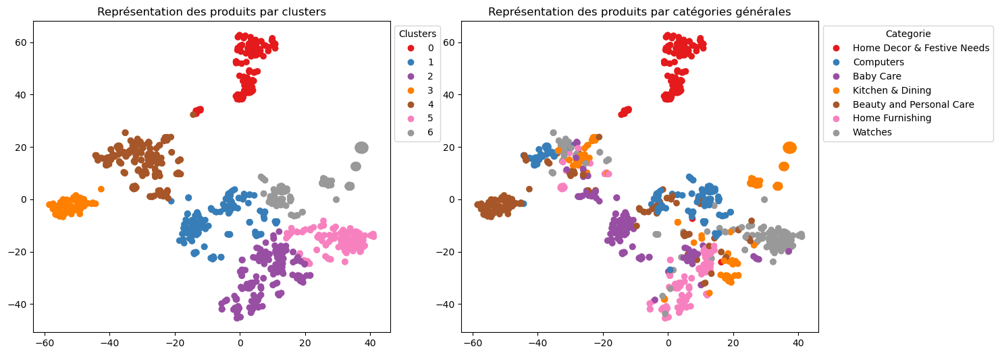

ARI :  0.3962
-------------------------------
Représentation graphique par T-SNE de la méthode Word2Vec (Skip-gram)


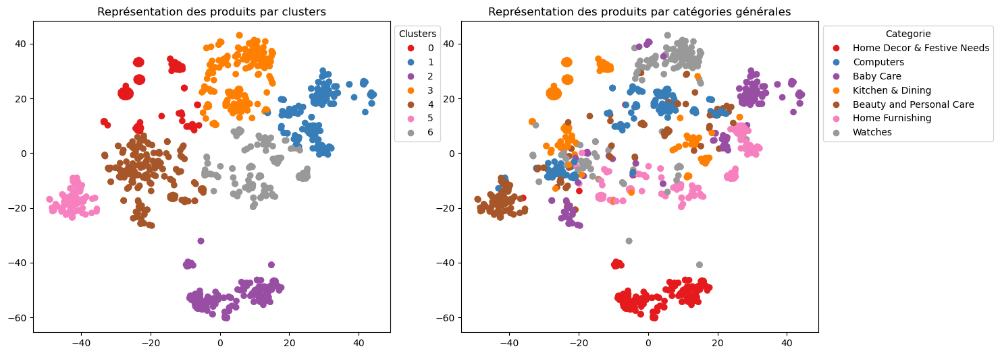

ARI :  0.3554


In [128]:
# Affichons les graphiques des produits par clusters et par catégories générales
print('Représentation graphique par T-SNE de la méthode Word2Vec (CBOW)')
TSNE_visu_fct(X_tsne_cbow, y_cat_num, labels_cbow, ARI_cbow)
print('-------------------------------')
print('Représentation graphique par T-SNE de la méthode Word2Vec (Skip-gram)')
TSNE_visu_fct(X_tsne_sg, y_cat_num, labels_sg, ARI_sg)

- **<u>ACP</u>**

ACP Word2Vec (CBOW)
Nombre de composantes calculées : 1050
Nombre de composantes pour 80% de la variance expliquée : 13
Nombre de composantes pour 90% de la variance expliquée : 21


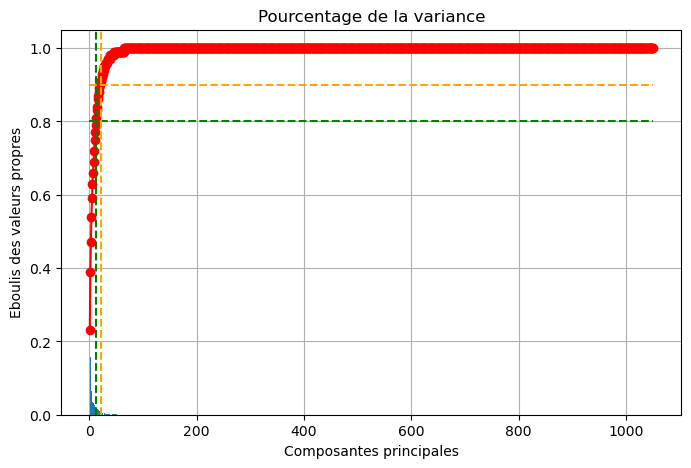

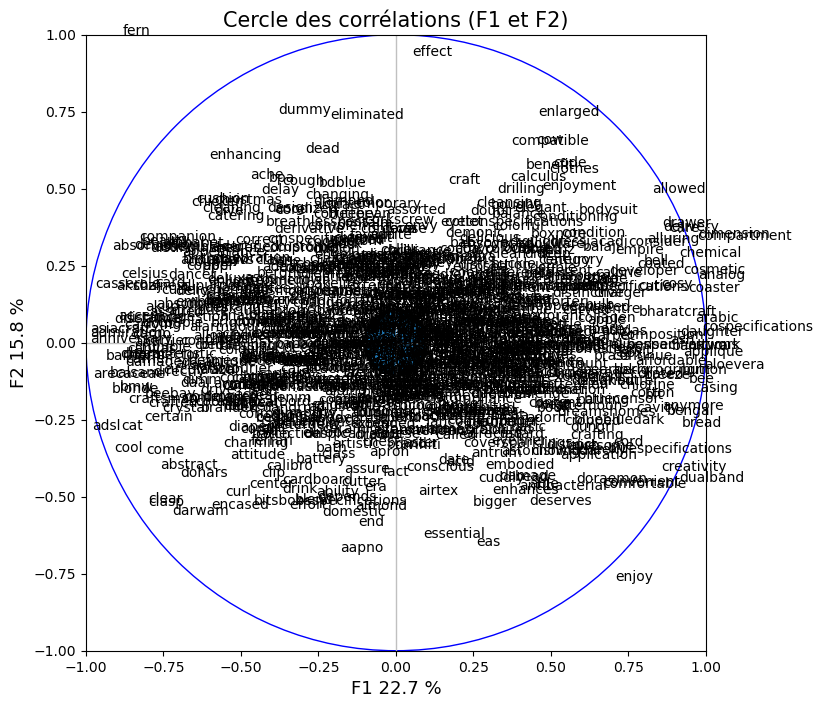

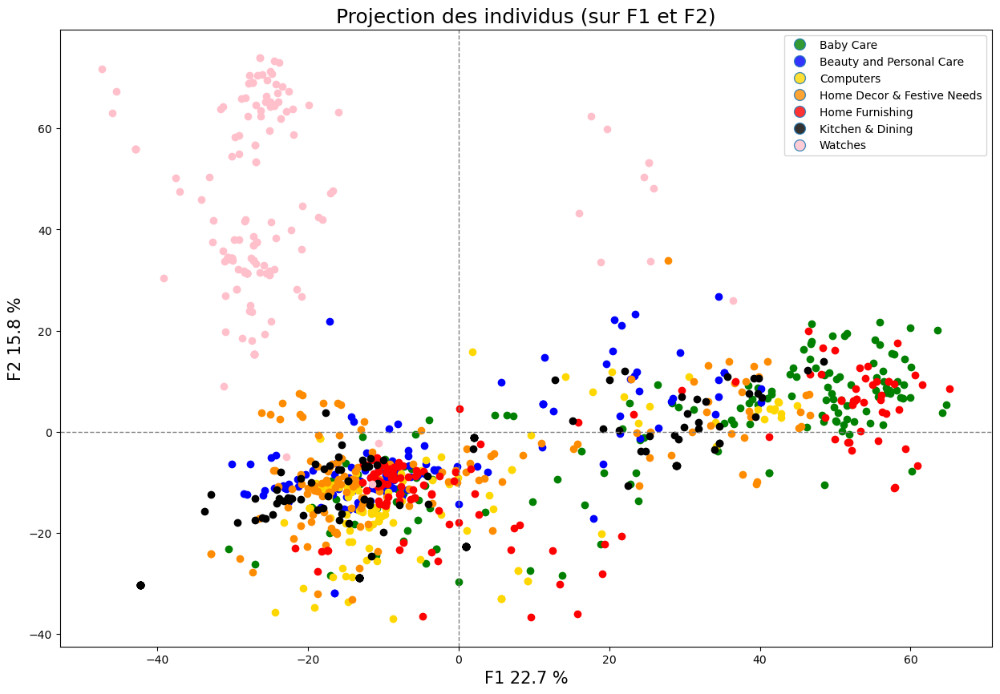

ACP Word2Vec (Skip-gram)
Nombre de composantes calculées : 1050
Nombre de composantes pour 80% de la variance expliquée : 27
Nombre de composantes pour 90% de la variance expliquée : 45


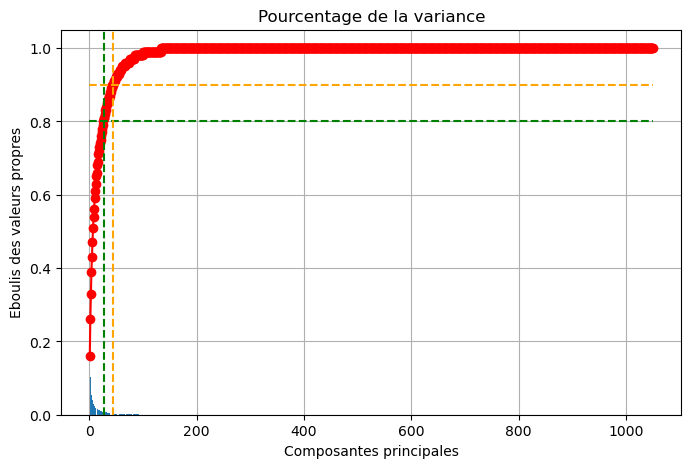

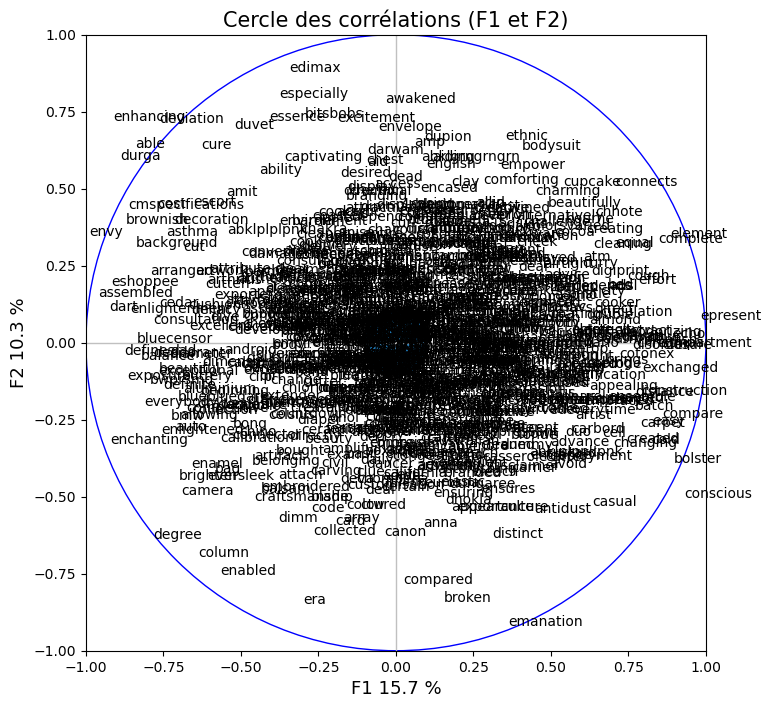

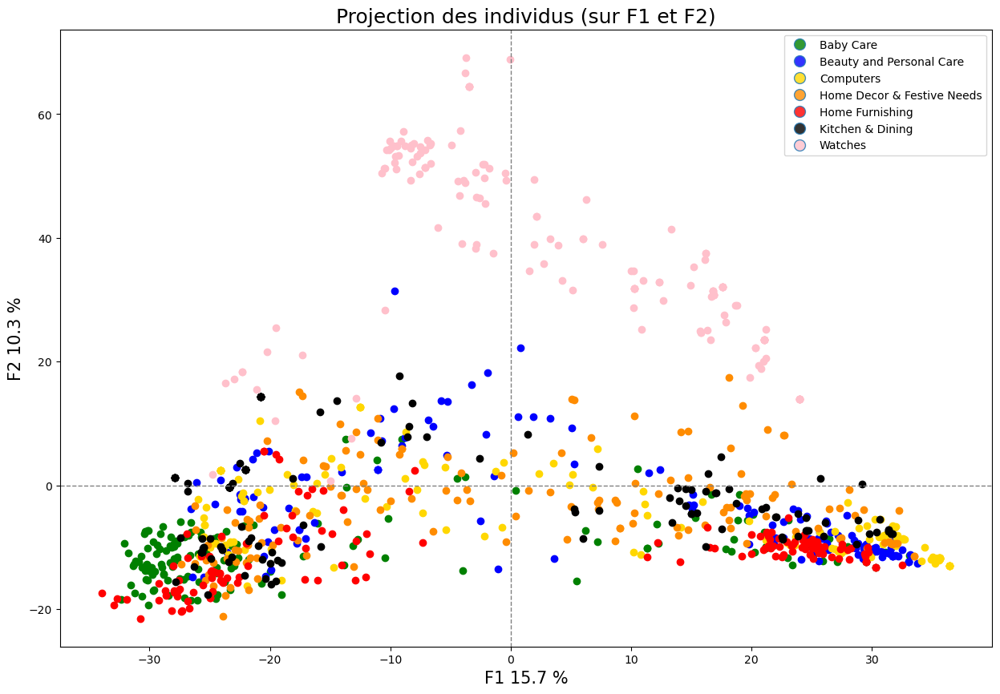

In [129]:
# Création de notre ACP avec cercle des corrélations
# et projection des points (colorés selon leur catégorie)
print('ACP Word2Vec (CBOW)')
ACP(df_embedding_cbow, 1050, 0, 1)

print('ACP Word2Vec (Skip-gram)')
ACP(df_embedding_sg, 1050, 0, 1)

In [130]:
# On calcule notre score ARI sur la technique CBOW et Skip-Gram

print("Word2Vec (CBOW) : ")
print("-----------------")
ARI_cbow_acp, features_pca_cbow, labels_cbow_acp = ACP_ari(21, embeddings_cbow)
print()
print("Word2Vec (Skip-Gram) : ")
print("--------")
ARI_sg_acp, features_pca_sg, labels_sg_acp = ACP_ari(45, embeddings_sg)

Word2Vec (CBOW) : 
-----------------
ARI :  0.2043 time :  106.0

Word2Vec (Skip-Gram) : 
--------
ARI :  0.19 time :  100.0


Représentation graphique par ACP de la méthode Word2Vec (CBOW)


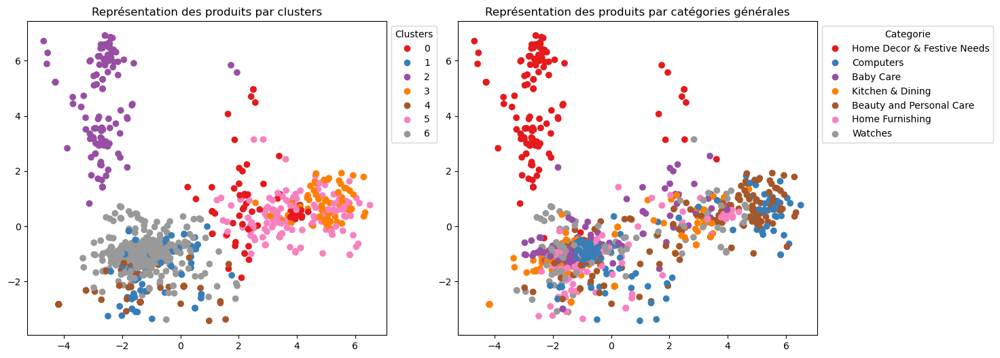

ARI :  0.2043
-------------------------------
Représentation graphique par ACP de la méthode Word2Vec (Skip-gram)


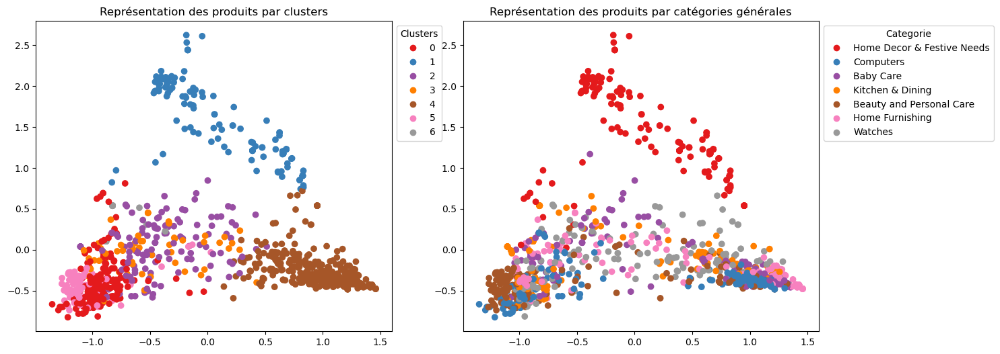

ARI :  0.19


In [131]:
# Affichons les graphiques des produits par clusters et par catégories générales
print('Représentation graphique par ACP de la méthode Word2Vec (CBOW)')
ACP_visu_fct(features_pca_cbow, y_cat_num, labels_cbow_acp, ARI_cbow_acp)
print('-------------------------------')
print('Représentation graphique par ACP de la méthode Word2Vec (Skip-gram)')
TSNE_visu_fct(features_pca_sg, y_cat_num, labels_sg_acp, ARI_sg_acp)

- **<u>ACP + t-SNE</u>**

Word2Vec (CBOW) :
ARI :  0.3732 time :  110.0


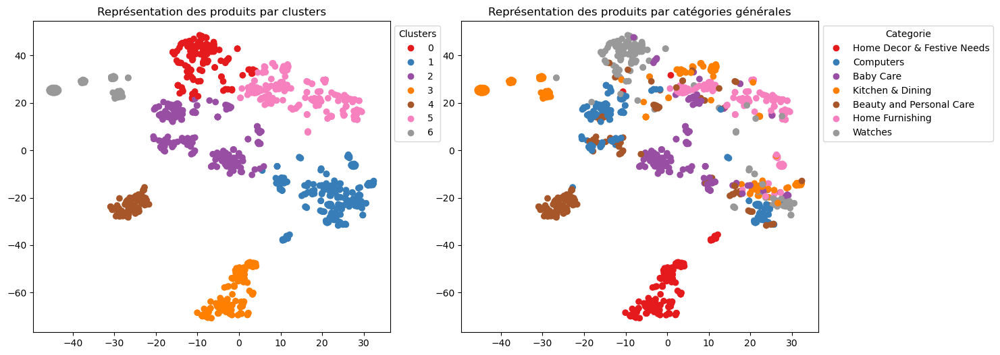

ARI :  0.3732
-------------------
Word2Vec (Skip-gram) : 
ARI :  0.3035 time :  111.0


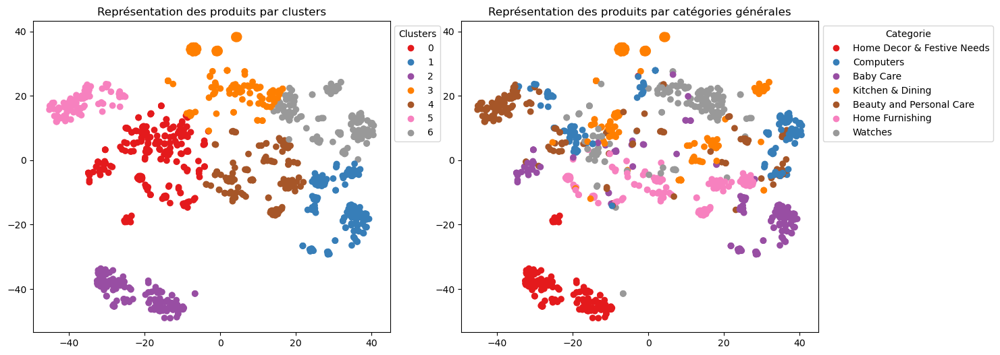

ARI :  0.3035


In [132]:
# Visualisation de nos clusters
print('Word2Vec (CBOW) :')
ACP_TSNE(21, embeddings_cbow)
print('-------------------')
print('Word2Vec (Skip-gram) : ')
ACP_TSNE(45, embeddings_sg)

### b. BERT

Le modèle **BERT** (Bidirectional Encoder Representations from Transformers), comme son nom l'indique, est un modèle de langage bidirectionnel et pré-entrainé de type Transformers, c'est-à-dire qu'il utilise des réseaux de neurones (transformers) pour comprendre les relations entre les mots d'une phrase. Il va identifier la signification des mots dans un contexte donné en prenant en compte le contexte précédent ET le contexte suivant (bidirectionnel). 

Les embeddings (chaque token de la phrase) sont agrégés pour obtenir une représentation vectorielle pour chaque phrase.

In [133]:
import os

In [134]:
os.environ["TF_KERAS"]='1'
print(tf.__version__)
print(tensorflow.__version__)
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
print(tf.test.is_built_with_cuda())

2.9.1
2.9.1
Num GPUs Available:  0
True


On crée deux fonctions : 
- L'une transforme les données textuelles, chaque phrase de la liste (sentences) est encodée par la fonction "bert_tokenizer.encode_plus".
- Le seconde permet d'extraire les features à partir d'un modèle pré-entrainé et d'une liste de phrases. 

In [135]:
# Fonction de préparation des phrases (sentences)
def bert_inp_fct(sentences, bert_tokenizer, max_length) :
    input_ids=[]
    token_type_ids = []
    attention_mask=[]
    bert_inp_tot = []

    for sent in sentences:
        bert_inp = bert_tokenizer.encode_plus(sent,
                                              add_special_tokens = True,
                                              max_length = max_length,
                                              padding='max_length',
                                              return_attention_mask = True, 
                                              return_token_type_ids=True,
                                              truncation=True,
                                              return_tensors="tf")
    
        input_ids.append(bert_inp['input_ids'][0])
        token_type_ids.append(bert_inp['token_type_ids'][0])
        attention_mask.append(bert_inp['attention_mask'][0])
        bert_inp_tot.append((bert_inp['input_ids'][0], 
                             bert_inp['token_type_ids'][0], 
                             bert_inp['attention_mask'][0]))

    input_ids = np.asarray(input_ids)
    token_type_ids = np.asarray(token_type_ids)
    attention_mask = np.array(attention_mask)
    
    return input_ids, token_type_ids, attention_mask, bert_inp_tot
    

# Fonction de création des features
def feature_BERT_fct(model, model_type, sentences, max_length, b_size, mode='HF'):
    batch_size = b_size
    batch_size_pred = b_size
    bert_tokenizer = AutoTokenizer.from_pretrained(model_type)
    time1 = time.time()
    last_hidden_states_tot = []  # Liste pour stocker les last_hidden_states de chaque batch

    for step in range(len(sentences) // batch_size):
        idx = step * batch_size
        input_ids, token_type_ids, attention_mask, bert_inp_tot = bert_inp_fct(
            sentences[idx : idx + batch_size], bert_tokenizer, max_length
        )

        if mode == "HF":  # Bert HuggingFace
            outputs = model.predict(
                [input_ids, attention_mask, token_type_ids], batch_size=batch_size_pred
            )
            last_hidden_states = outputs.last_hidden_state

        if mode == "TFhub":  # Bert Tensorflow Hub
            text_preprocessed = {
                "input_word_ids": input_ids,
                "input_mask": attention_mask,
                "input_type_ids": token_type_ids,
            }
            outputs = model(text_preprocessed)
            last_hidden_states = outputs["sequence_output"]

        last_hidden_states_tot.append(last_hidden_states)

    # Concaténer les last_hidden_states de tous les batches
    last_hidden_states_tot = np.concatenate(last_hidden_states_tot, axis=0)
    features_bert = np.mean(last_hidden_states_tot, axis=1)

    time2 = np.round(time.time() - time1, 0)
    print("temps traitement : ", time2)

    return features_bert, last_hidden_states_tot

#### - BERT HuggingFace

In [136]:
from transformers import TFAutoModel, AutoTokenizer
import numpy as np

# Chargement du modèle BERT pré-entrainé
model_type = 'bert-base-uncased'
model = TFAutoModel.from_pretrained(model_type)

# Liste de phrases
sentences = data['description_clean'].to_list()

# Longueur maximale de séquence et taille de batch
max_length = 64
batch_size = 10

# Obtention des caractéristiques BERT pour chaque phrase
# en utilisant la méthode "Hidden States" de BERT
features_bert_HF, last_hidden_states_tot_HF = feature_BERT_fct(model, model_type,
                                                         sentences, max_length,
                                                         batch_size, mode='HF')


Some layers from the model checkpoint at bert-base-uncased were not used when initializing TFBertModel: ['mlm___cls', 'nsp___cls']
- This IS expected if you are initializing TFBertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
All the layers of TFBertModel were initialized from the model checkpoint at bert-base-uncased.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertModel for predictions without further training.


1/1 [==============================] - 1s 832ms/step
temps traitement :  110.0


#### - Calcul score ARI

In [137]:
ARI_HF, X_tsne_HF, labels_HF, y_cat_num_HF = ARI_fct(features_bert_HF)

ARI :  0.3098 time :  117.0


#### - Réduction en 2 dimensions
- **<u>T-SNE</u>**

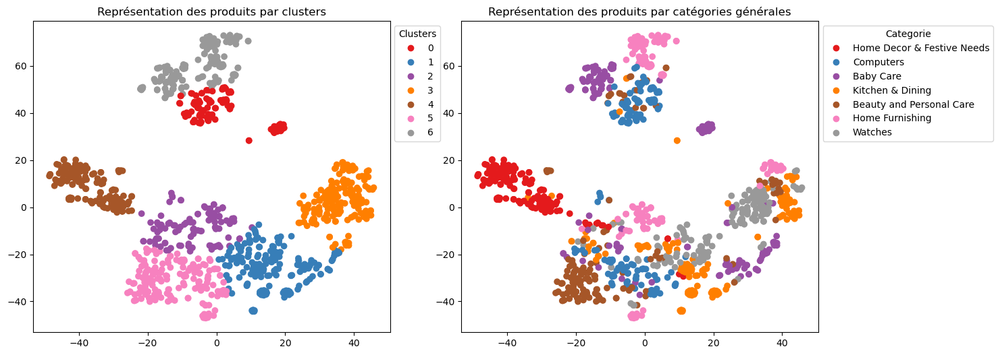

ARI :  0.3098


In [138]:
TSNE_visu_fct(X_tsne_HF, y_cat_num_HF, labels_HF, ARI_HF)

#### - Optimisation hyperparamètres 

In [139]:
# from sklearn.metrics import adjusted_rand_score
# import itertools

# # Définir les valeurs à tester pour chaque hyperparamètre
# max_length_values = [32, 64, 128]
# batch_size_values = [16, 32, 64]

# best_score = 0
# best_params = {}

# # Boucle sur toutes les combinaisons possibles d'hyperparamètres
# for max_length, batch_size in itertools.product(max_length_values, batch_size_values):
#     # Obtention des caractéristiques BERT avec les hyperparamètres actuels
#     features_bert, last_hidden_states_tot = feature_BERT_fct(model, model_type, sentences,
#                                                              max_length, batch_size,
#                                                              mode='HF')
#     # Calcul des clusters et du score ARI avec les nouvelles caractéristiques
#     ari_score, X_tsne, labels_pred, labels_true = ARI_fct(features_bert)
    
#     # Affichage de la combinaison d'hyperparamètres et du score ARI correspondant
#     print("Hyperparameters:", {'max_length': max_length, 'batch_size': batch_size})
#     print("ARI Score:", ari_score)
#     print("---")

#     # Évaluation des performances avec le score ARI
#     ari_score = adjusted_rand_score(y_cat_num_HF, labels_HF)
    
#     # Mettre à jour les meilleurs hyperparamètres si le score ARI est amélioré
#     if ari_score > best_score:
#         best_score = ari_score
#         best_params = {'max_length': max_length, 'batch_size': batch_size}

# # Afficher les meilleurs hyperparamètres et le meilleur score ARI
# print("Best Hyperparameters:", best_params)
# print("Best ARI Score:", best_score)

En optimisant nos hyperparamètres, on obtient un score ARI identique à celui obtenu précédemment (= 0.3098). 

#### - BERT hub Tensorflow

In [140]:
pip install tensorflow-hub

Note: you may need to restart the kernel to use updated packages.


In [141]:
pip install -U tensorflow-text==2.9

Note: you may need to restart the kernel to use updated packages.


In [142]:
import tensorflow_hub as hub
import tensorflow_text 

# Guide sur le Tensorflow hub : https://www.tensorflow.org/text/tutorials/classify_text_with_bert
model_url = 'https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4'
bert_layer = hub.KerasLayer(model_url, trainable=True)

In [143]:
# Liste de phrases
sentences = data['description_clean'].to_list()

In [144]:
# Longueur maximale de séquence et taille de batch
max_length = 64
batch_size = 10

# Chargement du modèle BERT pré-entrainé (model_type)
# et model chargé à partir de l'url
model_type = 'bert-base-uncased'
model = bert_layer

# Obtention des caractéristiques BERT pour chaque phrase
# en utilisant la méthode à l'aide d'un modèle BERT chargé depuis TensorFlowHub
features_bert, last_hidden_states_tot = feature_BERT_fct(model, model_type, sentences, 
                                                         max_length, batch_size, mode='TFhub')

temps traitement :  104.0


#### - Calcul score ARI

In [145]:
ARI_TFhub, X_tsne_TFhub, labels_TFhub, y_cat_num_TFhub = ARI_fct(features_bert)

ARI :  0.3209 time :  134.0


#### - Réduction en 2 dimensions
- **<u>T-SNE</u>**

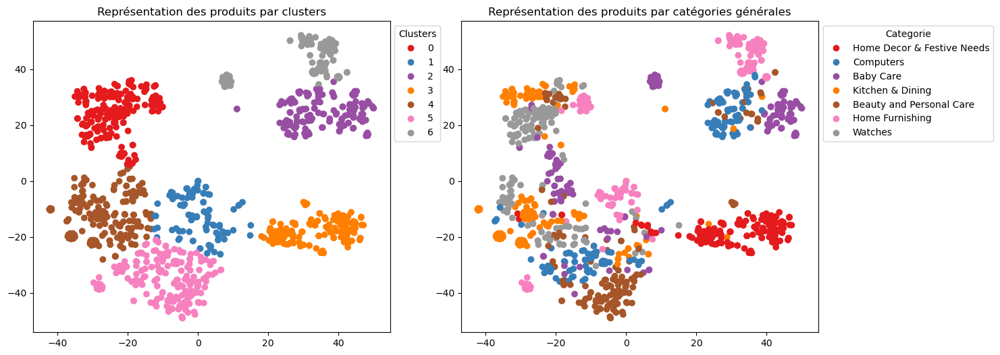

ARI :  0.3209


In [146]:
TSNE_visu_fct(X_tsne_TFhub, y_cat_num_TFhub, labels_TFhub, ARI_TFhub)

### c. USE

Le modèle **USE** (Universal Sentence Encoder) produit des sentence embeddings. Un encodeur résume chaque phrase à une phrase en 512 dimensions de longueur fixe. L'idée est d'utiliser une phrase pour prédire la suivante ou la précédente. 

In [147]:
!pip install sentencepiece

In [148]:
embed = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")

In [149]:
# Encodage des phrases de la liste sentences
# en vecteurs de 512 dimensions 
def feature_USE_fct(sentences, b_size) :
    batch_size = b_size  #Découpage de la liste de sentences en plusieurs batches
    time1 = time.time()

    for step in range(len(sentences)//batch_size) :
        idx = step*batch_size
        feat = embed(sentences[idx:idx+batch_size])

        if step ==0 :
            features = feat
        else :
            features = np.concatenate((features,feat))

    time2 = np.round(time.time() - time1,0)
    return features

In [150]:
batch_size = 10

In [151]:
features_USE = feature_USE_fct(sentences, batch_size)

In [152]:
ARI_use, X_tsne_use, labels_use, y_cat_num_use = ARI_fct(features_USE)

ARI :  0.3966 time :  129.0


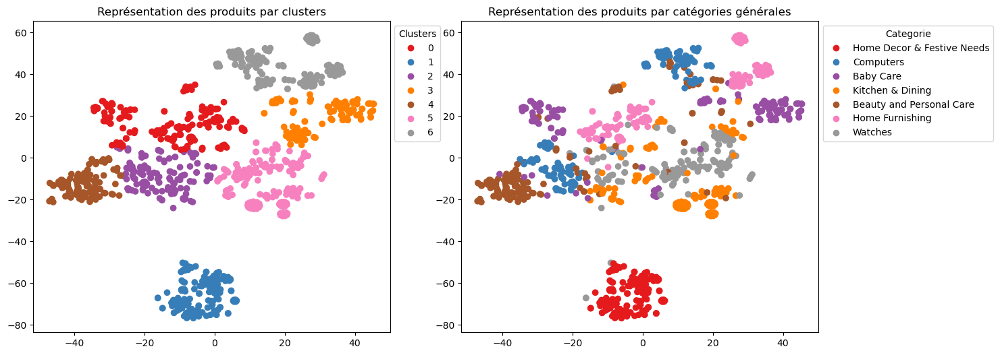

ARI :  0.3966


In [153]:
TSNE_visu_fct(X_tsne_use, y_cat_num_use, labels_use, ARI_use)

In [154]:
# On va tester sur plusieurs valeurs de batch_size
# afin de voir si le score évolue ou non
batch_sizes = [5, 10, 15]
ari_scores = []

for batch_size in batch_sizes:
    features_USE = feature_USE_fct(sentences, batch_size)
    ARI_use, X_tsne_use, labels_use, y_cat_num_use = ARI_fct(features_USE)
    ari_scores.append(ARI_use)
    print(f"Batch size : {batch_size}, ARI score : {ARI_use:.4f}")

ARI :  0.3863 time :  136.0
Batch size : 5, ARI score : 0.3863
ARI :  0.3966 time :  130.0
Batch size : 10, ARI score : 0.3966
ARI :  0.4031 time :  126.0
Batch size : 15, ARI score : 0.4031


On obtient une valeur de ARI meilleure avec un batch_size = 15. 

<u>Analyse graphique de la faisabilité de regroupement automatique</u> :

Une différence est observée dans la réduction de dimension entre l'ACP et la t-SNE. Effectivement, on peut noter un **regroupement plus évident pour la t-SNE** pour les données appartenant au même cluster, ce qui n'est pas vraiment le cas pour l'**ACP** où les différentes catégories semblent se superposer et **moins évidentes à distinguer**. 

Néanmoins, pour la t-SNE, on observe que les produits d'une même catégorie se regroupent de manière assez peu compacte, bien que les clusters semblent homogènes, une dispersion est observée pour les produits d'une même catégorie. De plus, concernant l'ACP, les premières composantes n'expliquent pas une grande partie de la variance. Néanmoins, certaines catégories sont relativement bien séparées. Cette première analyse graphique montre la **faisabilité** de regrouper automatiquement des produits d'une même catégorie. 

Ensuite, les scores ARI calculés permettent dans un premier temps de dire que les données semblent mieux représentées dans l'espace de projection obtenu par la t-SNE et que les clusters semblent mieux séparés pour cette technique. En plus de cela, nous observons que les meilleurs scores ARI sont obtenus avec les deux méthodes de bag-of-words CountVectorizer et Tf-idf, la dernière ayant le meilleur score ARI. 

En associant l'ACP à la t-SNE, on a pu réduire les dimensions au préalable avant d'effectuer notre t-SNE. Il est en effet intéressant de travailler sur des composantes principales qui ont été décorrélées entre elles. De plus, pour certaines techniques de traitement de texte (Tf-idf, Word2Vec (CBOW)) ont obtenu des scores ARI légèrement meilleurs après cette réduction de dimension en associant ACP et t-SNE. 

# DONNEES IMAGES

In [344]:
# Importation des images
import os
from os import listdir

path = 'C:\\Users\\evaro\\OneDrive\\Images\\OpenClassRooms\\Projet_6\\Images\\'
list_photos = [file for file in listdir(path)]
print(len(list_photos))

1050


# 1. Récupération des labels des photos à partir du nom des images

In [345]:
from sklearn import preprocessing

# On récupère notre dataframe et on garde les informations qui nous intéressent
col = ['image', 'categ_generale']
data_img = data[col]

# On va attribuer un numéro de label selon la catégorie
le = preprocessing.LabelEncoder()
data_img["label"] = le.fit_transform(data_img["categ_generale"])
data_img

,image,categ_generale,label
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,4
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,0
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,0
3,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,4
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,4
...,...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc.jpg,Baby Care,0
1046,fd6cbcc22efb6b761bd564c28928483c.jpg,Baby Care,0
1047,5912e037d12774bb73a2048f35a00009.jpg,Baby Care,0
1048,c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,Baby Care,0


In [346]:
# Regardons le nombre de labels et la répartition des images
data_img.groupby("label").count()

,image,categ_generale
label,,
0,150,150
1,150,150
2,150,150
3,150,150
4,150,150
5,150,150
6,150,150


Chaque label (catégorie) est constitué de 150 produits (150 images). 

In [347]:
# On affiche le nom de chaque catégorie
list_categ = data_img['categ_generale'].unique().tolist()
list_categ

['Home Furnishing',
 'Baby Care',
 'Watches',
 'Home Decor & Festive Needs',
 'Kitchen & Dining',
 'Beauty and Personal Care',
 'Computers']

In [348]:
data_img.head(10)

,image,categ_generale,label
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,4
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,0
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,0
3,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,4
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,4
5,893aa5ed55f7cff2eccea7758d7a86bd.jpg,Watches,6
6,f355cc1ccb08bd0d283ed979b7ee7515.jpg,Watches,6
7,dd0e3470a7e6ed76fd69c2da27721041.jpg,Watches,6
8,41384da51732c0b4df3de8f395714fbb.jpg,Watches,6
9,710ed5f2393a4b9e8823aa0029f71f93.jpg,Watches,6


# 2. Affichage d'exemples d'images par label

In [349]:
# On trie la liste des noms de fichiers d'images
# par ordre alphabétique 
list_photos = sorted(list_photos)
len(list_photos)

1050

In [350]:
data_img

,image,categ_generale,label
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,4
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,0
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,0
3,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,4
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,4
...,...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc.jpg,Baby Care,0
1046,fd6cbcc22efb6b761bd564c28928483c.jpg,Baby Care,0
1047,5912e037d12774bb73a2048f35a00009.jpg,Baby Care,0
1048,c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,Baby Care,0


In [351]:
# On trie les données du DataFrame en fonction des noms de fichiers d'images
data_img = data_img.set_index('image').loc[list_photos].reset_index()
data_img.head()

,image,categ_generale,label
0,009099b1f6e1e8f893ec29a7023153c4.jpg,Watches,6
1,0096e89cc25a8b96fb9808716406fe94.jpg,Kitchen & Dining,5
2,00cbbc837d340fa163d11e169fbdb952.jpg,Home Furnishing,4
3,00d84a518e0550612fcfcba3b02b6255.jpg,Beauty and Personal Care,1
4,00e966a5049a262cfc72e6bbf68b80e7.jpg,Computers,2


Home Furnishing


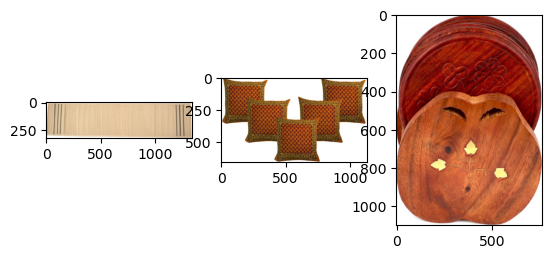

Baby Care


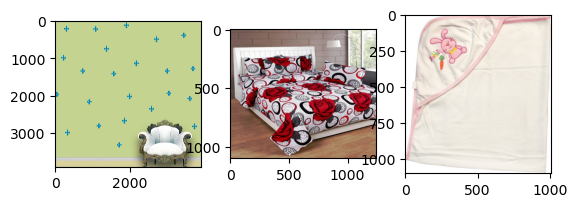

Watches


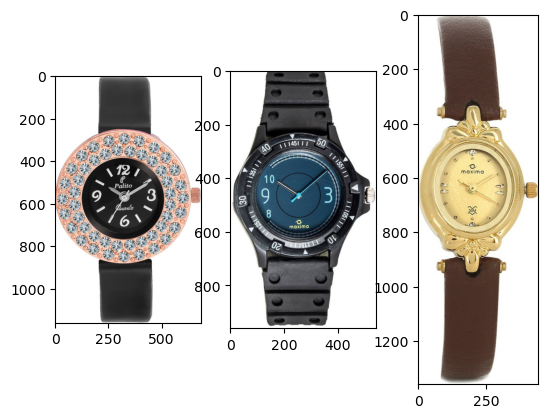

Home Decor & Festive Needs


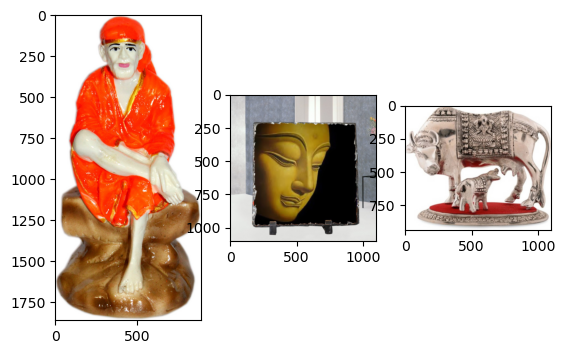

Kitchen & Dining


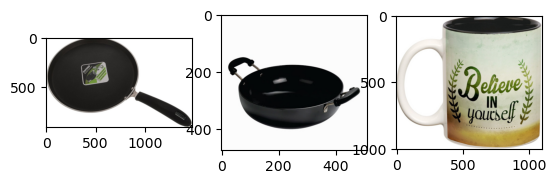

Beauty and Personal Care


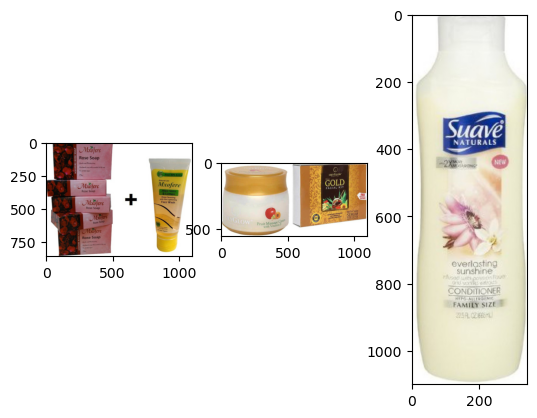

Computers


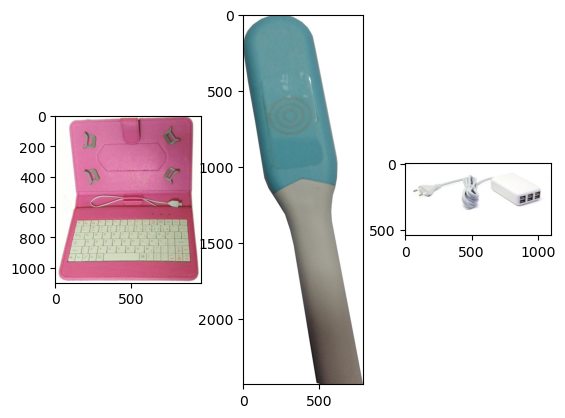

In [352]:
from matplotlib.image import imread

def list_fct(name) :
    list_image_name = [(list_photos[i], data_img['categ_generale'][i]) for i in range(len(data_img)) if data_img["categ_generale"][i]==name]
    return list_image_name

list_furnishing=[list_photos[i] for i in range(len(data_img)) if data_img["categ_generale"][i]=="Home Furnishing"]
list_baby=[list_photos[i] for i in range(len(data_img)) if data_img["categ_generale"][i]=="Baby Care"]
list_watches=[list_photos[i] for i in range(len(data_img)) if data_img["categ_generale"][i]=="Watches"]
list_decor=[list_photos[i] for i in range(len(data_img)) if data_img["categ_generale"][i]=="Home Decor & Festive Needs"]
list_kitchen=[list_photos[i] for i in range(len(data_img)) if data_img["categ_generale"][i]=="Kitchen & Dining"]
list_beauty=[list_photos[i] for i in range(len(data_img)) if data_img["categ_generale"][i]=="Beauty and Personal Care"]
list_computer=[list_photos[i] for i in range(len(data_img)) if data_img["categ_generale"][i]=="Computers"]

for name in list_categ :
    print(name)
    for i in range(3):
        plt.subplot(131 + i)
        filename = os.path.join(path, list_fct(name)[i][0])
        image = imread(filename)
        plt.imshow(image)
    plt.show()

Les images s'affichent sur des dimensions différentes. Les réseaux de neurones prenant par défaut des **images 224x224**, nous allons les redimensionner afin qu'elles soient toutes de même taille. 

## 2.1. Redimensionnement images

### a. Test sur une image

Nous allons, dans un premier temps, sélectionner une image afin de visualiser les changements lors du redimensionnement. 

In [165]:
pip install opencv-python

  Using cached opencv_python-4.7.0.72-cp37-abi3-win_amd64.whl (38.2 MB)
Note: you may need to restart the kernel to use updated packages.


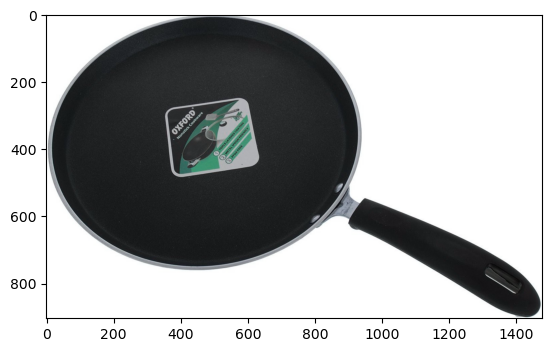

L'image est de dimensions: 1478 x 904


In [353]:
import cv2

# Affichage de l'image de base 'en couleur'
image = cv2.imread(path+list_photos[1])
plt.imshow(image)
plt.show()

# Calcul dimensions de l'image actuelle 
hauteur, largeur, _ = image.shape

# Affichage des dimensions de l'image
print('L\'image est de dimensions: {} x {}'.format(largeur, hauteur))

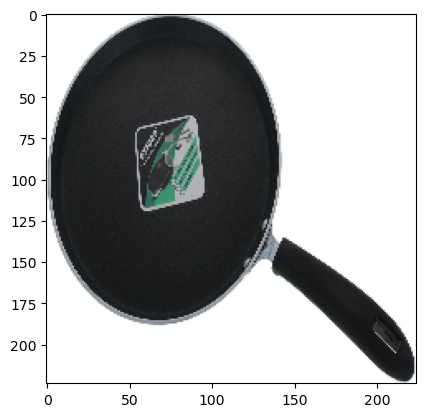

In [354]:
# Redimensionner l'image en 224x224
image_resized = cv2.resize(image, (224, 224))

# Afficher l'image redimensionnée
plt.imshow(image_resized)
plt.show()

Nous avons réussi à redimensionner l'image en 224x224, néanmoins, des **déformations** de l'image d'origine sont observées. Nous allons donc appliquer une fonction de redimensionnement qui tiendra compte des proportions initiales de l'image. 

In [355]:
from PIL import Image

# Fonction de redimensionnement tenant compte des proportions initiales de l'image. 
def redim_image(chemin_image):
    
    # On charge l'image d'origine
    img = Image.open(chemin_image)
    file_dir=os.path.split(chemin_image)
    
    # On récupère les dimensions initiales de l'image
    width, height = img.size
    
    # On regarde si l'image est en format portrait (height > width)
    # ou paysage (height < width)
    # On récupère le côté le plus grand (height ou width), puis on calcule
    # le rapport de l'aspect de l'image 
    # Les nouvelles dimension sont calculées en utilisant le rapport de l'aspect
    # et la taille souhaitée pour la dimension la plus grande (224)
    if height > width:
    
        aspect = height / 224
        new_size = (int(width/aspect), 224)
    elif width > height:
        
        aspect = width / 224
        new_size = (224, int(height/aspect))
    else:
        
        new_size = (224, 224)
    
    # On utilise la méthode "resize" pour redimensionner l'image sur
    # la nouvelle taille qui est enregistrée dans un nouveau dossier
    img_resized = img.resize(new_size)
    img_resized.show()
    new_folder_path = "C:\\Users\\evaro\\OneDrive\\Images\\OpenClassRooms\\Projet_6\\"
    os.makedirs(new_folder_path, exist_ok=True)
    img_resized.save(os.path.join(new_folder_path, file_dir[1]))
    
    # On crée une image blanche de taille 224x224 et on utilise la méthode
    # "paste" pour coller notre image sur l'image blanche pour remplir les
    # dimensions restantes par du blanc, puis on enregistre dans le même dossier
    img = Image.open("Images_redim/"+file_dir[1])
    
    width, height = img.size
    
    if height > width:
        new_img = Image.new('RGB', (224, 224),(255,255,255)) # white
        
        pos_lrg = int((height - width) / 2)
        new_img.paste(img, box=(pos_lrg,0))
        
        new_folder_path = "C:\\Users\\evaro\\OneDrive\\Images\\OpenClassRooms\\Projet_6\\"
        os.makedirs(new_folder_path, exist_ok=True)
        img_resized.save(os.path.join(new_folder_path, file_dir[1]))
        
    elif width > height:
        new_img = Image.new('RGB', (224, 224),(255,255,255)) # white
        
        pos_ht = int((width - height) / 2)
        new_img.paste(img, box=(0, pos_ht))

        new_folder_path = "C:\\Users\\evaro\\OneDrive\\Images\\OpenClassRooms\\Projet_6\\"
        os.makedirs(new_folder_path, exist_ok=True)
        img_resized.save(os.path.join(new_folder_path, file_dir[1]))
    
    
    return "Images_redim/"+file_dir[1]


In [356]:
# On applique notre fonction sur notre image
img_redim = redim_image(path+list_photos[1])

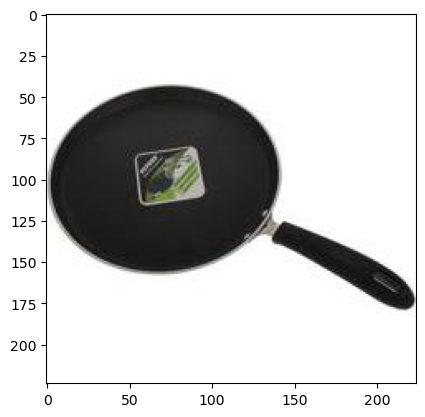

In [170]:
# On affiche notre image nouvellement redimensionnée
img = plt.imread(img_redim)
plt.imshow(img)
plt.show()

L'image obtenue est désormais redimensionnée et centrée de manière à avoir conservé ses proportions. 

Nous allons maintenant appliquer cette transformation sur toutes les images. 

### b. Transformation sur toutes les images

In [171]:
# On parcourt tous les fichiers dans le dossier
for filename in os.listdir(path):
    # On vérifie que le fichier est une image en vérifiant l'extension
    if filename.endswith('.jpg') or filename.endswith('.png'):
        # On construit le chemin d'accès au fichier
        file_path = os.path.join(path, filename)
        # Redimensionnement des images
        redim_image(file_path)

In [357]:
# On importe à nouveau nos images
new_path = 'C:\\Users\\evaro\\Images_redim\\'
list_photos_redim = [file for file in listdir(new_path)]
print(len(list_photos_redim))

1050


In [358]:
# On trie la liste des noms de fichiers d'images
# par ordre alphabétique 
list_photos_redim = sorted(list_photos_redim)

In [359]:
# On trie les données du DataFrame en fonction des noms de fichiers d'images
data_img = data_img.set_index('image').loc[list_photos_redim].reset_index()
data_img.head()

,image,categ_generale,label
0,009099b1f6e1e8f893ec29a7023153c4.jpg,Watches,6
1,0096e89cc25a8b96fb9808716406fe94.jpg,Kitchen & Dining,5
2,00cbbc837d340fa163d11e169fbdb952.jpg,Home Furnishing,4
3,00d84a518e0550612fcfcba3b02b6255.jpg,Beauty and Personal Care,1
4,00e966a5049a262cfc72e6bbf68b80e7.jpg,Computers,2


Home Furnishing


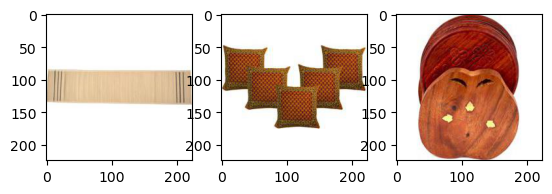

Baby Care


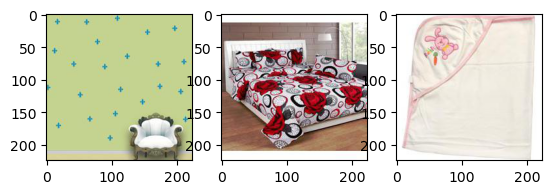

Watches


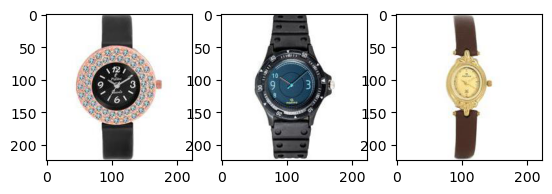

Home Decor & Festive Needs


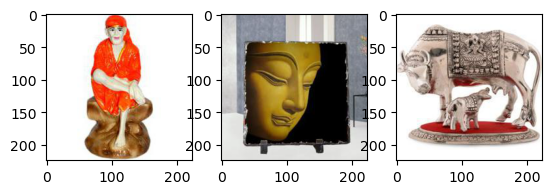

Kitchen & Dining


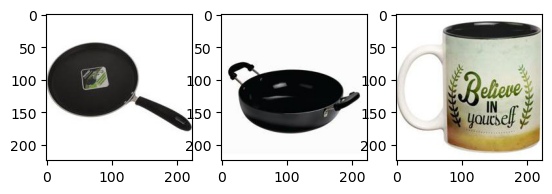

Beauty and Personal Care


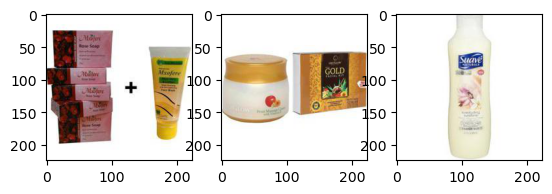

Computers


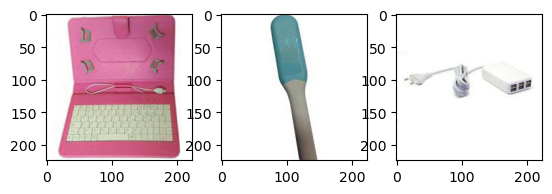

In [360]:
def list_fct(name) :
    list_image_name = [(list_photos_redim[i], data_img['categ_generale'][i]) for i in range(len(data_img)) if data_img["categ_generale"][i]==name]
    return list_image_name

list_furnishing=[list_photos_redim[i] for i in range(len(data_img)) if data_img["categ_generale"][i]=="Home Furnishing"]
list_baby=[list_photos_redim[i] for i in range(len(data_img)) if data_img["categ_generale"][i]=="Baby Care"]
list_watches=[list_photos_redim[i] for i in range(len(data_img)) if data_img["categ_generale"][i]=="Watches"]
list_decor=[list_photos_redim[i] for i in range(len(data_img)) if data_img["categ_generale"][i]=="Home Decor & Festive Needs"]
list_kitchen=[list_photos_redim[i] for i in range(len(data_img)) if data_img["categ_generale"][i]=="Kitchen & Dining"]
list_beauty=[list_photos_redim[i] for i in range(len(data_img)) if data_img["categ_generale"][i]=="Beauty and Personal Care"]
list_computer=[list_photos_redim[i] for i in range(len(data_img)) if data_img["categ_generale"][i]=="Computers"]

for name in list_categ :
    print(name)
    for i in range(3):
        plt.subplot(131 + i)
        filename = os.path.join(new_path, list_fct(name)[i][0])
        image = imread(filename)
        plt.imshow(image)
    plt.show()

Nos images sont toutes redimensionnées et semblent bien proportionnées. 

# 3. Détermination et affichage des descripteurs SIFT

L'algorithme **<u>SIFT</u>** (Scale-Invariant Feature Transform) va permettre d'extraire les features (points d'intérêt) de l'image et de calculer leurs descripteurs.  Il va, dans un premier temps, détecter les features de l'image (zone circulaire), et dans un second temps, construire des descripteurs SIFT.

In [176]:
pip install opencv-python

Note: you may need to restart the kernel to use updated packages.


## 3.1. Pré-traitement : sur une image

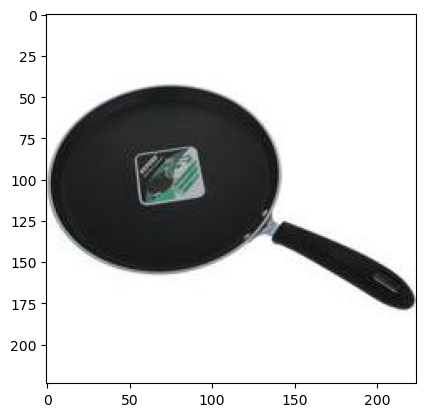

In [361]:
# Affichage de l'image de base 'en couleur'
image = cv2.imread(new_path+list_photos_redim[1])
plt.imshow(image)
plt.show()

Nous avons d'abord sélectionné une image que nous avons affichée en couleurs (image originale). 

Nous utilisons la méthode **CLAHE** (Contrast Limited Adaptive Histogram Equalization) afin d'améliorer les contrastes de notre image. On lui applique le pramètres "clipLimit" afin de limiter le bruit pour éviter d'avoir sur notre image une augmentation trop forte du bruit. 

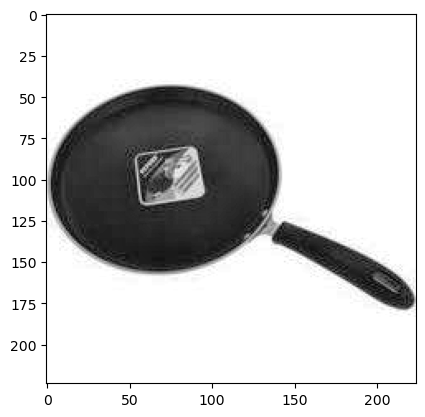

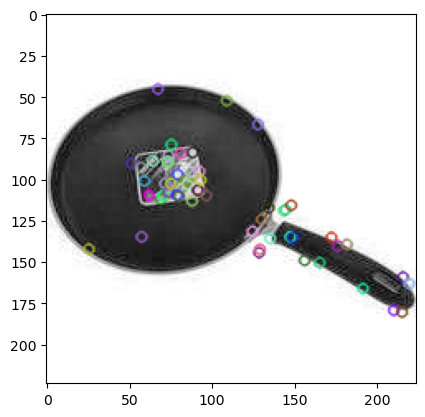

Descripteurs :  (58, 128)

[[  8.   1.   1. ...   0.   0.  18.]
 [  0.   1.  11. ...  33.  65.  88.]
 [  6.   0.   0. ...  98.   8.   0.]
 ...
 [ 27. 168.  39. ...   0.   0.   1.]
 [ 65.  10.   1. ...   1.   0.   0.]
 [ 89.  15.   0. ...   0.   0.   0.]]
---------------------
58 descripteurs de longueur 128


In [362]:
# On affiche maintenant l'image convertie en gris et dont les contrastes sont augmentés  
sift = cv2.SIFT_create()
image = cv2.imread(new_path+list_photos_redim[1],0) # Chargement de l'image en niveaux de gris
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))  # Création de l'objet CLAHE pour augmentation des contrastes
image = clahe.apply(image)  # Egalisation de l'histogramme avec CLAHE à l'image
kp, des = sift.detectAndCompute(image, None)  # Détection des points d'intérêts et calcul des descripteurs de l'image

# Affichage de l'image en niveaux de gris
plt.imshow(image, cmap='gray')
plt.axis('on')
plt.show()

# Affichage des points d'intérêts sur l'image
img=cv2.drawKeypoints(image,kp,image)

# Affichage de l'image avec les descripteurs
plt.imshow(img)
plt.show()
print("Descripteurs : ", des.shape)
print()
print(des)
print('---------------------')
print(des.shape[0], 'descripteurs de longueur', des.shape[1])

Sur notre image, après son chargement en niveaux de gris, puis de l'augmentation des contrastes des pixels, on obtient une image comportant 58 descripteurs (vecteurs de longueur 128).

## 3.2. Pré-traitement : entre 2 images d'une même catégorie

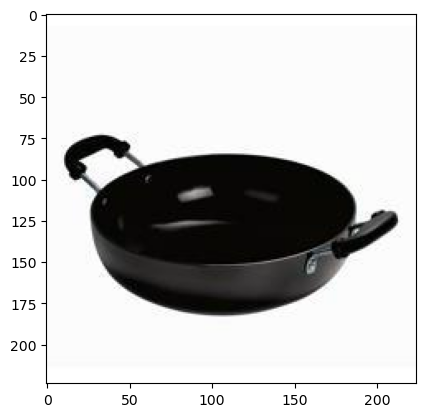

In [363]:
# On sélectionne une image de la même catégorie 
# Catégorie de notre première image
categ_image = data_img.loc[1, 'categ_generale']

# Sélection des images de la même catégorie
meme_categ = data_img[data_img['categ_generale'] == categ_image]

# Recherche de l'indice de l'image suivante dans la catégorie
image_suivante = (0 + 1) % len(meme_categ)

# Chemin de l'image suivante
chemin_image_suivante = new_path + meme_categ.iloc[image_suivante]['image']

# Chargement et affichage de l'image sélectionnée
image_selectionnee = cv2.imread(chemin_image_suivante)
plt.imshow(image_selectionnee)
plt.show()

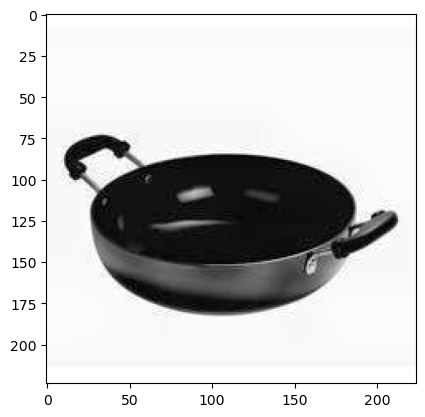

In [364]:
# On affiche maintenant l'image convertie en gris et dont les contrastes sont augmentés
image_selectionnee = cv2.imread(chemin_image_suivante,0) # Chargement de l'image en niveaux de gris
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))  # Création de l'objet CLAHE
image_selectionnee = clahe.apply(image_selectionnee)  # Egalisation de l'histogramme avec CLAHE à l'image
kp, des = sift.detectAndCompute(image_selectionnee, None)  # Détection des points d'intérêts et calcul des descripteurs de l'image

# Affichage de l'image en niveaux de gris
plt.imshow(image_selectionnee, cmap='gray')
plt.axis('on')
plt.show()

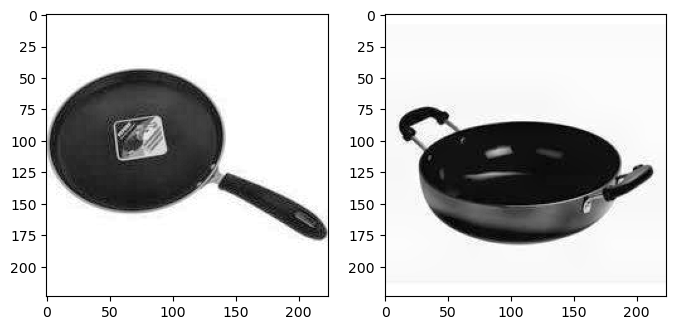

In [365]:
# On affiche nos deux images côte à côte
figure, ax = plt.subplots(1, 2, figsize=(8, 8))

ax[0].imshow(image, cmap='gray')
ax[1].imshow(image_selectionnee, cmap='gray')

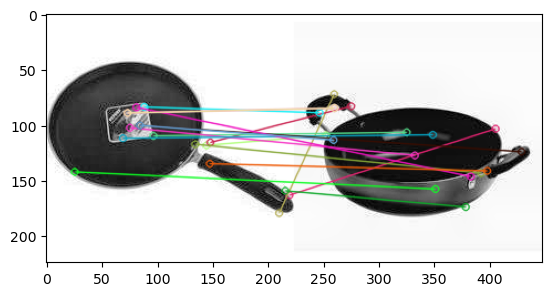

17 correspondances entre les deux images.


In [366]:
# On fait correspondre les caractéristiques de la première image avec les caractéristiques
# de la seconde image

keypoints_1, descriptors_1 = sift.detectAndCompute(image,None)
keypoints_2, descriptors_2 = sift.detectAndCompute(image_selectionnee,None)

# Feature matching
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)

matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)

img3 = cv2.drawMatches(image, keypoints_1, image_selectionnee, keypoints_2, matches, image_selectionnee, flags=2)
plt.imshow(img3),plt.show()
print(len(matches), 'correspondances entre les deux images.')

## 3.3. Pré-traitement : sur toutes les images

### 3.3.1. Création des descripteurs pour chaque image

In [367]:
import time
sift_keypoints = []  # Création d'une liste où stocker nos descripteurs
temps1 = time.time()
sift = cv2.SIFT_create() 
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))  # Création de l'objet CLAHE
no_descriptors_count = 0  # Compteur des images sans descripteurs détectés

# Pour chaque image, conversion en niveaux de gris et application de CLAHE,
# puis détection des points d'intérêt et calcul des descripteurs
for image_num in range(len(list_photos_redim)):
    if image_num % 100 == 0:
        print(image_num)
    image = cv2.imread(new_path + list_photos_redim[image_num], 0)
    res = clahe.apply(image)  # Application de CLAHE à l'image
    kp, des = sift.detectAndCompute(res, None)
    if des is not None:
        sift_keypoints.append(des)
    else:
        no_descriptors_count += 1
        sift_keypoints.append(np.empty((0, 128)))  # Ajout d'un descripteur vide
        
print(no_descriptors_count, 'image(s) ne contient pas de descripteurs SIFT détectés')
# Concaténation des descripteurs pour toutes les images dans un tableau
sift_keypoints_by_img = np.asarray(sift_keypoints)  # Liste de descripteurs par image pour les histogrammes
sift_keypoints_all = np.concatenate(sift_keypoints_by_img, axis=0)  # Liste descripteurs des images pour les clusters

print()
print("Nombre de descripteurs : ", sift_keypoints_all.shape)

duration1 = time.time() - temps1
print("temps de traitement SIFT descriptor : ", "%15.2f" % duration1, "secondes")


0
100
200
300
400
500
600
700
800
900
1000
1 image(s) ne contient pas de descripteurs SIFT détectés

Nombre de descripteurs :  (312423, 128)
temps de traitement SIFT descriptor :            11.45 secondes


312 423 descripteur au total pour toutes les images (vecteurs de longueur 128). 

### 3.3.2. Création des clusters des descripteurs

In [368]:
from sklearn import cluster, metrics

# Détermination du nombre de clusters par la racine carrée
# du nombre total de descripteurs
temps1=time.time()

k1 = int(round(np.sqrt(len(sift_keypoints_all)),0))
print("Nombre de clusters estimés (racine carrée descripteurs) : ", k1)
print("Création de",k1, "clusters de descripteurs ...")

# Détermination du nombre de clusters en multipliant par 10
# le nombre de catégories
k2 = len(list_categ) * 10
print("Nombre de clusters estimés (multiplication nb clusters) : ", k2)
print("Création de",k2, "clusters de descripteurs ...")

Nombre de clusters estimés (racine carrée descripteurs) :  559
Création de 559 clusters de descripteurs ...
Nombre de clusters estimés (multiplication nb clusters) :  70
Création de 70 clusters de descripteurs ...


Dans un premier temps, on va choisir de travailler sur un nombre **k = 559** (méthode de la racine carrée). Néanmoins, nous allons tester ultérieurement plusieurs valeurs de k (situées entre 70 et 559).

Pour le clustering, nous allons utiliser **MiniBatchKmeans** qui est une version plus simplifiée du Kmeans qui va utiliser de petits échantillons de données à chaque itération. L'idée étant de réduire le temps de calcul. 

In [369]:
# Clustering
kmeans = cluster.MiniBatchKMeans(n_clusters=k1, init_size=3*k1, random_state=0)
kmeans.fit(sift_keypoints_all)

duration1=time.time()-temps1
print("temps de traitement kmeans : ", "%15.2f" % duration1, "secondes")

temps de traitement kmeans :            12.47 secondes


### 3.3.3. Création des features des images

In [370]:
temps1=time.time()

# Fonction de création d'histogrammes
def build_histogram(kmeans, des, image_num):
    if len(des) ==0:
        print('Aucun descripteur SIFT pour l\'image :', image_num)
        return np.zeros(len(kmeans.cluster_centers_))
    res = kmeans.predict(des.astype(float))  # Prédiction appartenance cluster pour chaque descripteur
    hist = np.zeros(len(kmeans.cluster_centers_))  # Histogramme initialisé à un tableau que le nb de clusters
    nb_des=len(des)  # Nb de descripteurs des images
    for i in res:
        hist[i] += 1.0/nb_des
    return hist


# Création d'une matrice d'histogrammes
hist_vectors=[]

for i, image_desc in enumerate(sift_keypoints_by_img) :
    if i%100 == 0 : print(i)  
    hist = build_histogram(kmeans, image_desc, i) # Création des histogrammes
    hist_vectors.append(hist)

im_features = np.asarray(hist_vectors)  # Ajout des histogrammes à la matrice

duration1=time.time()-temps1
print("temps de création histogrammes : ", "%15.2f" % duration1, "secondes")

0
100
200
300
400
500
600
Aucun descripteur SIFT pour l'image : 635
700
800
900
1000
temps de création histogrammes :           524.13 secondes


### 3.3.4. Réduction de dimensions

On va commencer par réduire les dimensions des données par ACP avant d'effectuer notre t-SNE. 

- **<u>ACP</u>**

In [371]:
from sklearn import manifold, decomposition

print("Dimensions dataset avant réduction PCA : ", im_features.shape)
pca = decomposition.PCA(n_components=0.99)  # On conserve 99% de la variance expliquée
feat_pca= pca.fit_transform(im_features)
print("Dimensions dataset après réduction PCA : ", feat_pca.shape)

Dimensions dataset avant réduction PCA :  (1050, 559)
Dimensions dataset après réduction PCA :  (1050, 458)


Aprèr réduction du dataset avec l'ACP, nous passons de 541 features à 456 en conservant 99% de la variance expliquée. 

- **<u>t-SNE</u>**

In [372]:
# Réduction de dimensions en 2 composantes

tsne = manifold.TSNE(n_components=2, perplexity=30, 
                     n_iter=2000, init='random', random_state=6)
X_tsne = tsne.fit_transform(feat_pca)

df_tsne = pd.DataFrame(X_tsne[:,0:2], columns=['tsne1', 'tsne2'])
df_tsne["class"] = data_img["categ_generale"]
print(df_tsne.shape)

(1050, 3)


In [373]:
# Création de clusters à partir du t-SNE

cls = cluster.KMeans(n_clusters=7, random_state=6)
cls.fit(X_tsne)

df_tsne["cluster"] = cls.labels_
print(df_tsne.shape)

(1050, 4)


### 3.3.5. Analyse visuelle et numérique : affichage t-SNE selon les catégories d'images

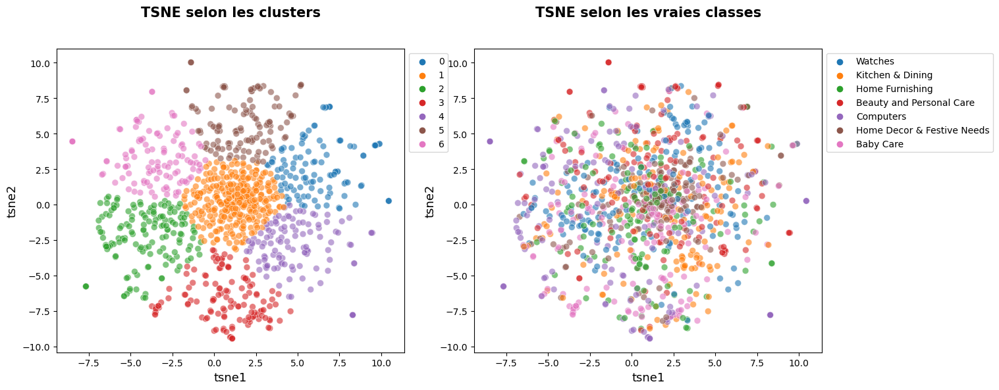

In [374]:
fig, (ax1, ax2) = plt.subplots(figsize=(15,6), ncols=2)

sns.scatterplot(
    x="tsne1", y="tsne2", hue="class", data=df_tsne, legend="brief",
    palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6, ax=ax2)

ax2.set_title('TSNE selon les vraies classes', fontsize=15, pad=35, fontweight='bold')
ax2.set_xlabel('tsne1', fontsize=13)
ax2.set_ylabel('tsne2', fontsize=13)
legend = ax2.legend(prop={'size': 10}, bbox_to_anchor=(1, 1), loc='upper left')

sns.scatterplot(
    x="tsne1", y="tsne2", hue="cluster", palette=sns.color_palette('tab10', n_colors=7),
    s=50, alpha=0.6, data=df_tsne, legend="brief", ax=ax1)

ax1.set_title('TSNE selon les clusters', fontsize=15, pad=35, fontweight='bold')
ax1.set_xlabel('tsne1', fontsize=13)
ax1.set_ylabel('tsne2', fontsize=13)
legend = ax1.legend(prop={'size': 10}, bbox_to_anchor=(1, 1), loc='upper left')


plt.show()

Les différentes catégories semblent avoir du mal à être correctement séparées les unes des autres en comparaison avec le t-SNE selon les clusters.  

In [375]:
# Calcul du score ARI pour vérifier la similarité entre les catégories des images et des clusters
labels = data_img["label"]
print("ARI : ", metrics.adjusted_rand_score(labels, cls.labels_))

ARI :  0.05285277262014724


Le score ARI obtenu (très faible) confirme notre observation concernant les résultats de notre t-SNE pour les vraies catégories.

On va tester à nouveau plusieurs valeurs de k lors de la création des clusters afin de voir si cela peut impacter la similarité. 

In [192]:
# from sklearn import cluster, metrics
# from sklearn import manifold, decomposition
# from sklearn.metrics import davies_bouldin_score, silhouette_score

# # Liste des valeurs de k à tester
# k_values = range(70, 3010, 100)

# # Création d'une matrice pour stocker les scores ARI pour chaque valeur de k
# ari_scores = np.zeros(len(k_values))

# # Création d'une matrice pour stocker les scores Davies Bouldin pour chaque valeur de k
# db_scores = np.zeros(len(k_values))

# # Création d'une matrice pour stocker les scores Silhouette pour chaque valeur de k
# s_scores = np.zeros(len(k_values))

# # Boucle sur les différentes valeurs de k
# for i, k in enumerate(k_values):
#     print(f"Clustering pour k={k} ...")
    
#     # Clustering
#     kmeans = cluster.MiniBatchKMeans(n_clusters=k, random_state=0)
#     kmeans.fit(sift_keypoints_all)

#     # Création des histogrammes
#     hist_vectors=[]
#     for j, image_desc in enumerate(sift_keypoints_by_img):
#         hist = build_histogram(kmeans, image_desc, j)
#         hist_vectors.append(hist)
#     im_features = np.asarray(hist_vectors)

#     # Réduction de dimensions avec PCA
#     pca = decomposition.PCA(n_components=0.99)
#     feat_pca = pca.fit_transform(im_features)

#     # Réduction de dimensions avec t-SNE
#     tsne = manifold.TSNE(n_components=2, perplexity=30, n_iter=2000, init='random', random_state=6)
#     X_tsne = tsne.fit_transform(feat_pca)
    
#     # Clustering avec k-means sur les features réduites
#     cls = cluster.KMeans(n_clusters=7, random_state=6)
#     cls.fit(X_tsne)
    
#     # Calcul du score ARI
#     labels = data_img["label"]
#     ari_scores[i] = metrics.adjusted_rand_score(labels, cls.labels_)
#     print(f"Score ARI pour k={k} : {ari_scores[i]:.4f}")

#     # Calcul du score Davies Bouldin
#     db_scores[i] = davies_bouldin_score(X_tsne, cls.labels_)
#     print(f"Score Davies Bouldin pour k={k} : {db_scores[i]:.4f}")
    
#     # Calcul du score Silhouette
#     s_scores[i] = silhouette_score(X_tsne, cls.labels_)
#     print(f"Score Silhouette pour k={k} : {s_scores[i]:.4f}")

In [193]:
# # Affichage des scores en barres

# plt.figure(figsize=(12, 6))
# plt.bar(k_values, ari_scores, width=20, label="ARI", color="b")
# plt.title('Score ARI en fonction du nombre de clusters optimal pour les descripteurs')
# plt.xlabel("Nombre de clusters (k)")
# plt.ylabel("Score ARI")
# plt.show()

Les résultats des scores ARI pour les différentes valeurs de k ne sont pas extraordinairement meilleures. Dans le meilleur des cas, le score ARI maximal obtenu est de 0.0772 pour k = 1770.

In [376]:
# On va effectuer une analyse par classe
# Regroupement des clusters en comptant les classes
df_tsne.groupby("cluster").count()["class"]

cluster
0    111
1    305
2    151
3    129
4    118
5    123
6    113
Name: class, dtype: int64

In [377]:
conf_mat = metrics.confusion_matrix(labels, cls.labels_)
print(conf_mat)

[[12 44 23 40 13  5 13]
 [20 31 12  5 19 42 21]
 [14 14 30 30 11 19 32]
 [16 96 17  6  5  5  5]
 [14 55 15 28 13  7 18]
 [21 35 15 16 39 16  8]
 [14 30 39  4 18 29 16]]


In [378]:
def conf_mat_transform(y_true,y_pred) :
    conf_mat = metrics.confusion_matrix(y_true,y_pred)
    
    corresp = [5, 2, 1, 3, 0, 4, 6]
    print ("Correspondance des clusters : ", corresp)
    # y_pred_transform = np.apply_along_axis(correspond_fct, 1, y_pred)
    labels = pd.Series(y_true, name="y_true").to_frame()
    labels['y_pred'] = y_pred
    labels['y_pred_transform'] = labels['y_pred'].apply(lambda x : corresp[x]) 
    
    return labels['y_pred_transform']

In [379]:
cls_labels_transform = conf_mat_transform(labels, cls.labels_)
conf_mat = metrics.confusion_matrix(labels, cls_labels_transform)
print(conf_mat)
print()
print(metrics.classification_report(labels, cls_labels_transform))

Correspondance des clusters :  [5, 2, 1, 3, 0, 4, 6]
[[13 23 44 40  5 12 13]
 [19 12 31  5 42 20 21]
 [11 30 14 30 19 14 32]
 [ 5 17 96  6  5 16  5]
 [13 15 55 28  7 14 18]
 [39 15 35 16 16 21  8]
 [18 39 30  4 29 14 16]]

              precision    recall  f1-score   support

           0       0.11      0.09      0.10       150
           1       0.08      0.08      0.08       150
           2       0.05      0.09      0.06       150
           3       0.05      0.04      0.04       150
           4       0.06      0.05      0.05       150
           5       0.19      0.14      0.16       150
           6       0.14      0.11      0.12       150

    accuracy                           0.08      1050
   macro avg       0.10      0.08      0.09      1050
weighted avg       0.10      0.08      0.09      1050



<Axes: >

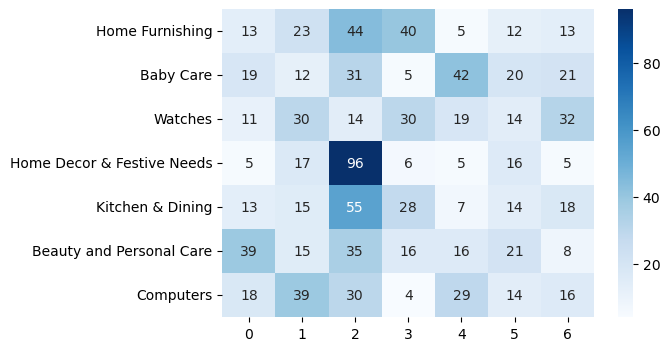

In [380]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_categ],
                     columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")

La matrice de confusion montre effectivement qu'il est difficile pour certaines catégories réelles d'identifier à quel cluster elles peuvent correspondre. La catégorie la mieux prédite est "Home Decor & Festive Needs", mais elle est tout de même confondue avec "Computers".

In [381]:
# On enregistre nos données
data_img.to_csv('data_img.csv', sep = ';')

In [382]:
# Importation de notre fichier
data = pd.read_csv('data_img.csv', sep=';')

# 4. Feature extraction par un algorithme de type CNN Transfer Learning

Les résultats obtenus après extraction des features par l'algorithme SIFT n'étant pas satisfaisants, nous allons effectuer une extraction de features par un algorithme de Transfer Learning, le CNN. Dans un premier temps, nous cherchons à étudier la faisabilité de regrouper automatiquement. Puis, nous allons chercher à prédire les catégories, nous allons donc effectuer de la classification supervisée. 

Le **<u>Transfer Learning</u>** est une méthode d'apprentissage automatique consistant à utiliser un modèle pré-entrainé afin d'initialiser le réseau de neurone de notre nouveau modèle, afin d'éviter de commencer à partir de 0.  

Les **<u>CNN</u>** (Convolutional Neural Network) = réseaux de neurones convolutifs (sous-catégorie des réseaux de neurones), sont des modèles de classification d'images. Ils ont la particularité d'être constitués de couches de convolution, de pooling et de couches connectées. L'idée étant d'améliorer la précision de la prédiction. 

## 4.1. VGG16

Etant donné les résultats peu concluants pour l'algorithme de type SIFT, nous allons utiliser cette fois-ci un algorithme de type CNN. Pour commencer, le modèle que l'on va créer se base sur l'architecture **<u>VGG16</u>** qui est une version du réseau de neurones convolutif de VGG-Net (modèle de réseau de neurones convolutif). 

VGG16 est constitué d'un total de 16 couches :
- 13 couches de convolution
- 3 couches fully-connected

Le modèle a été pré-entraîné sur un ensemble de données d'images (plus d'1 million) provenant de la base de données "ImageNet". 

In [383]:
import os
import tensorflow as tf
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.keras.preprocessing.image import load_img, img_to_array

In [384]:
# Récupération modèle pré-entraîné VGG16 et indication de la taille des images en entrée
model0 = VGG16(weights="imagenet", input_shape=(224, 224, 3))

# On récupère la sortie de l'avant dernière couche du modèle
# (caractéristiques de haut niveau de l'image)
# On supprime la  dernière couche du modèle
model0 = Model(inputs=model0.inputs, outputs=model0.layers[-2].output)

# Création d'une liste vide qui contiendra les vecteurs de l'extraction de features
# pour chaque image
pict_vectors = []

# Pour chaque image
for image_num in range(data.shape[0]):
    # Chargement de l'image en redimensionnant en taille 224x224
    image = load_img(data.image.iloc[image_num], target_size=(224, 224))
    # Conversion de chaque image en un tableau numpy
    image = img_to_array(image)
    # Redimensionnement des données pour le modèle en ajoutant une dimension (nbre d'échantillons)
    image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
    # Pré-traitement de l'image pour être compatible au modèle VGG16
    image = preprocess_input(image)

    # Extraction des vecteurs des features
    features = model0.predict(image)
    print(features.shape)
    pict_vectors.append(features[0])
    im_feat_cnn = pd.DataFrame(pict_vectors)

1/1 [==============================] - 0s 289ms/step
(1, 4096)
1/1 [==============================] - 0s 143ms/step
(1, 4096)
1/1 [==============================] - 0s 157ms/step
(1, 4096)
1/1 [==============================] - 0s 153ms/step
(1, 4096)
1/1 [==============================] - 0s 177ms/step
(1, 4096)
1/1 [==============================] - 0s 157ms/step
(1, 4096)
1/1 [==============================] - 0s 159ms/step
(1, 4096)
1/1 [==============================] - 0s 160ms/step
(1, 4096)
1/1 [==============================] - 0s 145ms/step
(1, 4096)
1/1 [==============================] - 0s 161ms/step
(1, 4096)
1/1 [==============================] - 0s 160ms/step
(1, 4096)
1/1 [==============================] - 0s 141ms/step
(1, 4096)
1/1 [==============================] - 0s 156ms/step
(1, 4096)
1/1 [==============================] - 0s 169ms/step
(1, 4096)
1/1 [==============================] - 0s 158ms/step
(1, 4096)
1/1 [==============================] - 0s 143ms/step
(1

### a. Réduction de dimensions

Après extraction des features, par un algorithme de type CNN (VGG16), on poursuit par une réduction des dimensions des données par ACP avant d'effectuer notre t-SNE. 

- **<u>ACP</u>**

In [385]:
from sklearn import manifold, decomposition

print("Dimensions dataset avant réduction PCA : ", im_feat_cnn.shape)
pca = decomposition.PCA(n_components=0.99)
feat_pca_cnn_vgg= pca.fit_transform(im_feat_cnn)
print("Dimensions dataset après réduction PCA : ", feat_pca_cnn_vgg.shape)

Dimensions dataset avant réduction PCA :  (1050, 4096)
Dimensions dataset après réduction PCA :  (1050, 803)


Après réduction des données par l'ACP, nous passons de 4096 features à 803 en conservant 99% de la variance expliquée. 

- **<u>t-SNE</u>**

In [386]:
# Réduction de dimensions en 2 composantes

tsne = manifold.TSNE(n_components=2, perplexity=30, 
                     n_iter=2000, init='random', random_state=6)
X_tsne = tsne.fit_transform(feat_pca_cnn_vgg)

df_tsne = pd.DataFrame(X_tsne[:,0:2], columns=['tsne1', 'tsne2'])
df_tsne['image'] = path +data['image']
df_tsne["class"] = data["categ_generale"]
print(df_tsne.shape)

(1050, 4)


In [387]:
# Création de clusters à partir du t-SNE

cls = cluster.KMeans(n_clusters=7, random_state=6)
cls.fit(X_tsne)

df_tsne["cluster"] = cls.labels_
print(df_tsne.shape)

(1050, 5)


### b. Analyse visuelle et numérique : affichage t-SNE selon les catégories d'images

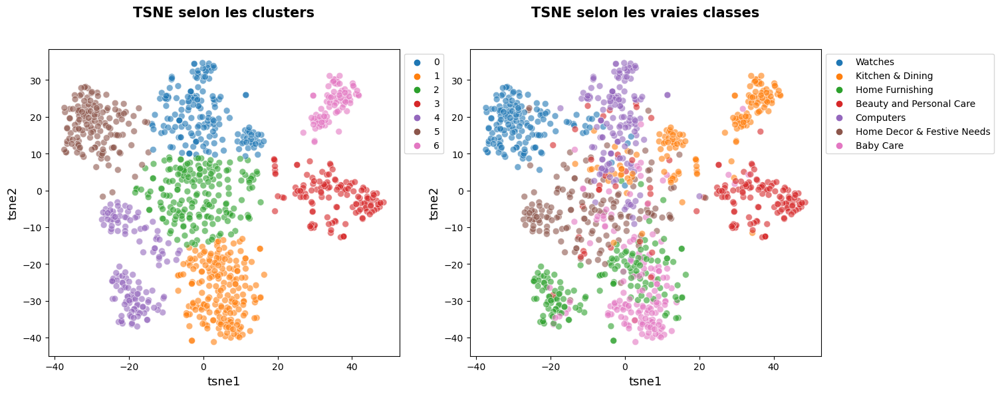

In [388]:
fig, (ax1, ax2) = plt.subplots(figsize=(15,6), ncols=2)

sns.scatterplot(
    x="tsne1", y="tsne2", hue="class", data=df_tsne, legend="brief",
    palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6, ax=ax2)

ax2.set_title('TSNE selon les vraies classes', fontsize=15, pad=35, fontweight='bold')
ax2.set_xlabel('tsne1', fontsize=13)
ax2.set_ylabel('tsne2', fontsize=13)
legend = ax2.legend(prop={'size': 10}, bbox_to_anchor=(1, 1), loc='upper left')

sns.scatterplot(
    x="tsne1", y="tsne2", hue="cluster", palette=sns.color_palette('tab10', n_colors=7),
    s=50, alpha=0.6, data=df_tsne, legend="brief", ax=ax1)

ax1.set_title('TSNE selon les clusters', fontsize=15, pad=35, fontweight='bold')
ax1.set_xlabel('tsne1', fontsize=13)
ax1.set_ylabel('tsne2', fontsize=13)
legend = ax1.legend(prop={'size': 10}, bbox_to_anchor=(1, 1), loc='upper left')


plt.show()

D'abord d'un point de vue graphique, nous observons une meilleure séparation des différentes catégories. 

In [389]:
# Calcul du score ARI pour vérifier la similarité entre les catégories des images et des clusters
labels = data["label"]
print("ARI : ", metrics.adjusted_rand_score(labels, cls.labels_))

ARI :  0.45209438250952905


Le score ARI obtenu confirme notre observation concernant les résultats de notre t-SNE pour les vraies catégories.

In [208]:
# On va effectuer une analyse par classe
# Regroupement des clusters en comptant les classes
df_tsne.groupby("cluster").count()["class"]

cluster
0    173
1    197
2    188
3    132
4    135
5    145
6     80
Name: class, dtype: int64

In [209]:
from sklearn import metrics

# On crée notre matrice de confusion
conf_mat = metrics.confusion_matrix(labels, cls.labels_)
print(conf_mat)

[[  2 109  26   3   9   0   1]
 [  8   5  13 117   5   1   1]
 [113   1  34   1   0   1   0]
 [  5   3  78   1  55   8   0]
 [  0  79   5   0  66   0   0]
 [ 32   0  30  10   0   0  78]
 [ 13   0   2   0   0 135   0]]


In [210]:
def conf_mat_transform(y_true,y_pred) :
    conf_mat = metrics.confusion_matrix(y_true,y_pred)
    
    corresp = [4, 6, 2, 3, 5, 0, 1]
    print ("Correspondance des clusters : ", corresp)
    # y_pred_transform = np.apply_along_axis(correspond_fct, 1, y_pred)
    labels = pd.Series(y_true, name="y_true").to_frame()
    labels['y_pred'] = y_pred
    labels['y_pred_transform'] = labels['y_pred'].apply(lambda x : corresp[x]) 
    
    return labels['y_pred_transform']

In [211]:
cls_labels_transform = conf_mat_transform(labels, cls.labels_)
conf_mat = metrics.confusion_matrix(labels, cls_labels_transform)
np.set_printoptions(suppress=True, precision=0)
print(conf_mat)
print()
print(metrics.classification_report(labels, cls_labels_transform))

Correspondance des clusters :  [4, 6, 2, 3, 5, 0, 1]
[[  0   1  26   3   2   9 109]
 [  1   1  13 117   8   5   5]
 [  1   0  34   1 113   0   1]
 [  8   0  78   1   5  55   3]
 [  0   0   5   0   0  66  79]
 [  0  78  30  10  32   0   0]
 [135   0   2   0  13   0   0]]

              precision    recall  f1-score   support

           0       0.00      0.00      0.00       150
           1       0.01      0.01      0.01       150
           2       0.18      0.23      0.20       150
           3       0.01      0.01      0.01       150
           4       0.00      0.00      0.00       150
           5       0.00      0.00      0.00       150
           6       0.00      0.00      0.00       150

    accuracy                           0.03      1050
   macro avg       0.03      0.03      0.03      1050
weighted avg       0.03      0.03      0.03      1050



<Axes: >

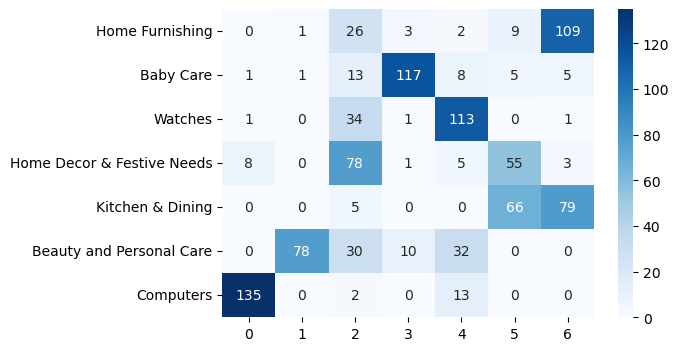

In [212]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_categ],
                     columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues", fmt='g')

## 4.2. ResNet50

Le modèle **ResNet50** (Residual Network) est un autre type de CNN. 

Il est constitué de 50 couches : 
- 48 couches de convolution
- 1 couche MaxPool
- 1 couche de pool moyenne

In [213]:
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import Model
import pandas as pd

In [214]:
# Récupération modèle pré-entraîné ResNet50 et indication de la taille des images en entrée
model_RN50 = ResNet50(weights="imagenet", input_shape=(224, 224, 3))

# On récupère la sortie de l'avant dernière couche du modèle
# (caractéristiques de haut niveau de l'image)
model_RN50 = Model(inputs=model_RN50.inputs, outputs=model_RN50.layers[-2].output)

# Création d'une liste vide qui contiendra les vecteurs de l'extraction de features
# pour chaque image
pict_vectors = []

# Pour chaque image
for image_num in range(data.shape[0]):
    # Chargement de l'image en redimensionnant en taille 224x224
    image = load_img(data.image.iloc[image_num], target_size=(224, 224))
    # Conversion de chaque image en un tableau numpy
    image = img_to_array(image)
    # Redimensionnement des données pour le modèle en ajoutant une dimension (nbre d'échantillons)
    image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
    # Pré-traitement de l'image pour être compatible au modèle ResNet50
    image = preprocess_input(image)

    # Extraction des vecteurs des features
    features = model_RN50.predict(image)
    print(features.shape)
    pict_vectors.append(features[0])
    im_feat_cnn_RN50 = pd.DataFrame(pict_vectors)

1/1 [==============================] - 1s 1s/step
(1, 2048)
1/1 [==============================] - 0s 104ms/step
(1, 2048)
1/1 [==============================] - 0s 100ms/step
(1, 2048)
1/1 [==============================] - 0s 132ms/step
(1, 2048)
1/1 [==============================] - 0s 118ms/step
(1, 2048)
1/1 [==============================] - 0s 122ms/step
(1, 2048)
1/1 [==============================] - 0s 108ms/step
(1, 2048)
1/1 [==============================] - 0s 127ms/step
(1, 2048)
1/1 [==============================] - 0s 118ms/step
(1, 2048)
1/1 [==============================] - 0s 132ms/step
(1, 2048)
1/1 [==============================] - 0s 112ms/step
(1, 2048)
1/1 [==============================] - 0s 110ms/step
(1, 2048)
1/1 [==============================] - 0s 111ms/step
(1, 2048)
1/1 [==============================] - 0s 113ms/step
(1, 2048)
1/1 [==============================] - 0s 118ms/step
(1, 2048)
1/1 [==============================] - 0s 117ms/step
(1, 2

### a. Réduction de dimensions

Après extraction des features, par un algorithme de type CNN (Resnet50), on poursuit par une réduction des dimensions des données par ACP avant d'effectuer notre t-SNE.

- **<u>ACP</u>**:

In [215]:
from sklearn import manifold, decomposition

print("Dimensions dataset avant réduction PCA : ", im_feat_cnn_RN50.shape)
pca = decomposition.PCA(n_components=0.99)
feat_pca_cnn_RN50= pca.fit_transform(im_feat_cnn_RN50)
print("Dimensions dataset après réduction PCA : ", feat_pca_cnn_RN50.shape)

Dimensions dataset avant réduction PCA :  (1050, 2048)
Dimensions dataset après réduction PCA :  (1050, 722)


- **<u>t-SNE</u>**:

In [216]:
# Réduction de dimensions en 2 composantes

tsne = manifold.TSNE(n_components=2, perplexity=30, 
                     n_iter=2000, init='random', random_state=6)
X_tsne = tsne.fit_transform(feat_pca_cnn_RN50)

df_tsne = pd.DataFrame(X_tsne[:,0:2], columns=['tsne1', 'tsne2'])
df_tsne["class"] = data["categ_generale"]
print(df_tsne.shape)

(1050, 3)


In [217]:
from sklearn.cluster import KMeans

In [218]:
# Création de clusters à partir du t-SNE
cls = KMeans(n_clusters=7, random_state=6)
cls.fit(X_tsne)

df_tsne["cluster"] = cls.labels_
print(df_tsne.shape)

(1050, 4)


### b. Analyse visuelle et numérique : affichage t-SNE selon les catégories d'images

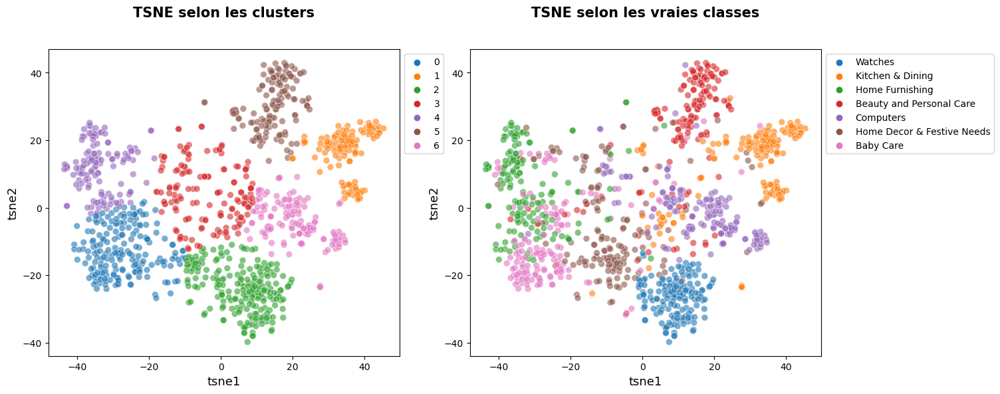

In [219]:
fig, (ax1, ax2) = plt.subplots(figsize=(15,6), ncols=2)

sns.scatterplot(
    x="tsne1", y="tsne2", hue="class", data=df_tsne, legend="brief",
    palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6, ax=ax2)

ax2.set_title('TSNE selon les vraies classes', fontsize=15, pad=35, fontweight='bold')
ax2.set_xlabel('tsne1', fontsize=13)
ax2.set_ylabel('tsne2', fontsize=13)
legend = ax2.legend(prop={'size': 10}, bbox_to_anchor=(1, 1), loc='upper left')

sns.scatterplot(
    x="tsne1", y="tsne2", hue="cluster", palette=sns.color_palette('tab10', n_colors=7),
    s=50, alpha=0.6, data=df_tsne, legend="brief", ax=ax1)

ax1.set_title('TSNE selon les clusters', fontsize=15, pad=35, fontweight='bold')
ax1.set_xlabel('tsne1', fontsize=13)
ax1.set_ylabel('tsne2', fontsize=13)
legend = ax1.legend(prop={'size': 10}, bbox_to_anchor=(1, 1), loc='upper left')


plt.show()

In [220]:
# Calcul du score ARI pour vérifier la similarité entre les catégories des images et des clusters
labels = data["label"]
print("ARI : ", metrics.adjusted_rand_score(labels, cls.labels_))

ARI :  0.4787261829557981


On observe graphiquement une bonne séparation de nos catégories et un score ARI légèrement meilleur par rapport à VGG16. 

## 4.3. InceptionV3 

Inception V3 se base sur l'architecture Inception. 

Il est constitué de **48 couches** : 
- 3 couches d'entrée
- 1 couche de sortie
- 44 couches de traitement

In [221]:
from keras.applications.inception_v3 import InceptionV3, preprocess_input

In [222]:
# Récupération modèle pré-entraîné InceptionV3 et indication de la taille des images en entrée
model_InceptionV3 = InceptionV3(weights="imagenet", input_shape=(299, 299, 3))

# On récupère la sortie de l'avant dernière couche du modèle
# (caractéristiques de haut niveau de l'image)
model_InceptionV3 = Model(inputs=model_InceptionV3.inputs, outputs=model_InceptionV3.layers[-2].output)

# Création d'une liste vide qui contiendra les vecteurs de l'extraction de features
# pour chaque image
pict_vectors = []

# Pour chaque image
for image_num in range(data.shape[0]):
    # Chargement de l'image en redimensionnant en taille 299x299
    image = load_img(data.image.iloc[image_num], target_size=(299, 299))
    # Conversion de chaque image en un tableau numpy
    image = img_to_array(image)
    # Redimensionnement des données pour le modèle en ajoutant une dimension (nbre d'échantillons)
    image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
    # Pré-traitement de l'image pour être compatible au modèle InceptionV3
    image = preprocess_input(image)

    # Extraction des vecteurs des features
    features = model_InceptionV3.predict(image)
    print(features.shape)
    pict_vectors.append(features[0])
    im_feat_cnn_InceptionV3 = pd.DataFrame(pict_vectors)

1/1 [==============================] - 1s 1s/step
(1, 2048)
1/1 [==============================] - 0s 110ms/step
(1, 2048)
1/1 [==============================] - 0s 113ms/step
(1, 2048)
1/1 [==============================] - 0s 133ms/step
(1, 2048)
1/1 [==============================] - 0s 135ms/step
(1, 2048)
1/1 [==============================] - 0s 113ms/step
(1, 2048)
1/1 [==============================] - 0s 141ms/step
(1, 2048)
1/1 [==============================] - 0s 120ms/step
(1, 2048)
1/1 [==============================] - 0s 105ms/step
(1, 2048)
1/1 [==============================] - 0s 108ms/step
(1, 2048)
1/1 [==============================] - 0s 112ms/step
(1, 2048)
1/1 [==============================] - 0s 113ms/step
(1, 2048)
1/1 [==============================] - 0s 111ms/step
(1, 2048)
1/1 [==============================] - 0s 103ms/step
(1, 2048)
1/1 [==============================] - 0s 108ms/step
(1, 2048)
1/1 [==============================] - 0s 122ms/step
(1, 2

### a. Réduction de dimensions

Après extraction des features, par un algorithme de type CNN (InceptionV3), on poursuit par une réduction des dimensions des données par ACP avant d'effectuer notre t-SNE.

- **<u>ACP</u>**:

In [223]:
from sklearn import manifold, decomposition

print("Dimensions dataset avant réduction PCA : ", im_feat_cnn_InceptionV3.shape)
pca = decomposition.PCA(n_components=0.99)
feat_pca_cnn_InceptionV3= pca.fit_transform(im_feat_cnn_InceptionV3)
print("Dimensions dataset après réduction PCA : ", feat_pca_cnn_InceptionV3.shape)

Dimensions dataset avant réduction PCA :  (1050, 2048)
Dimensions dataset après réduction PCA :  (1050, 696)


- **<u>t-SNE</u>**:

In [224]:
# Réduction de dimensions en 2 composantes

tsne = manifold.TSNE(n_components=2, perplexity=30, 
                     n_iter=2000, init='random', random_state=6)
X_tsne = tsne.fit_transform(feat_pca_cnn_InceptionV3)

df_tsne = pd.DataFrame(X_tsne[:,0:2], columns=['tsne1', 'tsne2'])
df_tsne["class"] = data["categ_generale"]
print(df_tsne.shape)

(1050, 3)


In [225]:
# Création de clusters à partir du t-SNE
cls = KMeans(n_clusters=7, random_state=6)
cls.fit(X_tsne)

df_tsne["cluster"] = cls.labels_
print(df_tsne.shape)

(1050, 4)


### b. Analyse visuelle et numérique : affichage t-SNE selon les catégories d'images

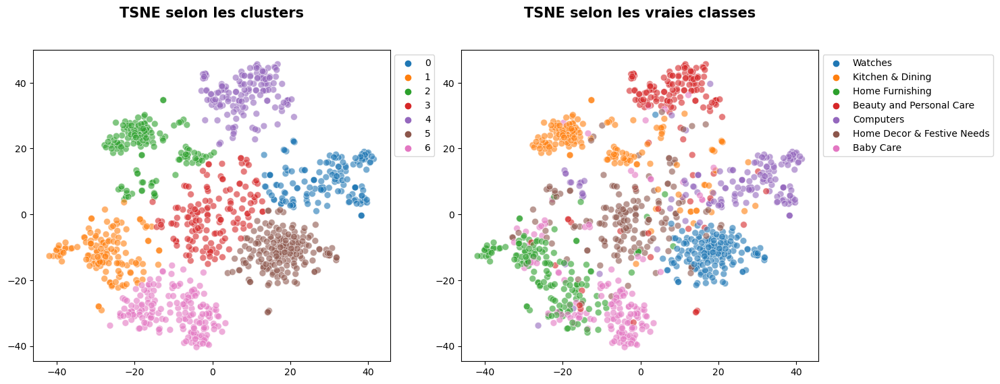

In [226]:
fig, (ax1, ax2) = plt.subplots(figsize=(15,6), ncols=2)

sns.scatterplot(
    x="tsne1", y="tsne2", hue="class", data=df_tsne, legend="brief",
    palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6, ax=ax2)

ax2.set_title('TSNE selon les vraies classes', fontsize=15, pad=35, fontweight='bold')
ax2.set_xlabel('', fontsize=13)
ax2.set_ylabel('', fontsize=13)
legend = ax2.legend(prop={'size': 10}, bbox_to_anchor=(1, 1), loc='upper left')

sns.scatterplot(
    x="tsne1", y="tsne2", hue="cluster", palette=sns.color_palette('tab10', n_colors=7),
    s=50, alpha=0.6, data=df_tsne, legend="brief", ax=ax1)

ax1.set_title('TSNE selon les clusters', fontsize=15, pad=35, fontweight='bold')
ax1.set_xlabel('', fontsize=13)
ax1.set_ylabel('', fontsize=13)
legend = ax1.legend(prop={'size': 10}, bbox_to_anchor=(1, 1), loc='upper left')


plt.show()

In [227]:
# Calcul du score ARI pour vérifier la similarité entre les catégories des images et des clusters
labels = data["label"]
print("ARI : ", metrics.adjusted_rand_score(labels, cls.labels_))

ARI :  0.5570304840116003


Le score ARI est le plus élevé en utilisant InceptionV3.

In [228]:
# On va effectuer une analyse par classe
# Regroupement des clusters en comptant les classes
df_tsne.groupby("cluster").count()["class"]

cluster
0    145
1    134
2    139
3    144
4    146
5    172
6    170
Name: class, dtype: int64

In [229]:
from sklearn import metrics

# On crée notre matrice de confusion
conf_mat = metrics.confusion_matrix(labels, cls.labels_)
print(conf_mat)

[[  4  19   3  10   4   1 109]
 [  6   5   0   6 123   6   4]
 [121   1  13   7   3   2   3]
 [  0  16  14 101   4  10   5]
 [  0  93   1   6   0   1  49]
 [ 14   0 108  13  11   4   0]
 [  0   0   0   1   1 148   0]]


In [230]:
def conf_mat_transform(y_true,y_pred) :
    conf_mat = metrics.confusion_matrix(y_true,y_pred)
    
    corresp = [4, 2, 1, 5, 3, 0, 6]
    print ("Correspondance des clusters : ", corresp)
    # y_pred_transform = np.apply_along_axis(correspond_fct, 1, y_pred)
    labels = pd.Series(y_true, name="y_true").to_frame()
    labels['y_pred'] = y_pred
    labels['y_pred_transform'] = labels['y_pred'].apply(lambda x : corresp[x]) 
    
    return labels['y_pred_transform']

In [231]:
cls_labels_transform = conf_mat_transform(labels, cls.labels_)
conf_mat = metrics.confusion_matrix(labels, cls_labels_transform)
np.set_printoptions(suppress=True, precision=0)
print(conf_mat)
print()
print(metrics.classification_report(labels, cls_labels_transform))

Correspondance des clusters :  [4, 2, 1, 5, 3, 0, 6]
[[  1   3  19   4   4  10 109]
 [  6   0   5 123   6   6   4]
 [  2  13   1   3 121   7   3]
 [ 10  14  16   4   0 101   5]
 [  1   1  93   0   0   6  49]
 [  4 108   0  11  14  13   0]
 [148   0   0   1   0   1   0]]

              precision    recall  f1-score   support

           0       0.01      0.01      0.01       150
           1       0.00      0.00      0.00       150
           2       0.01      0.01      0.01       150
           3       0.03      0.03      0.03       150
           4       0.00      0.00      0.00       150
           5       0.09      0.09      0.09       150
           6       0.00      0.00      0.00       150

    accuracy                           0.02      1050
   macro avg       0.02      0.02      0.02      1050
weighted avg       0.02      0.02      0.02      1050



<Axes: >

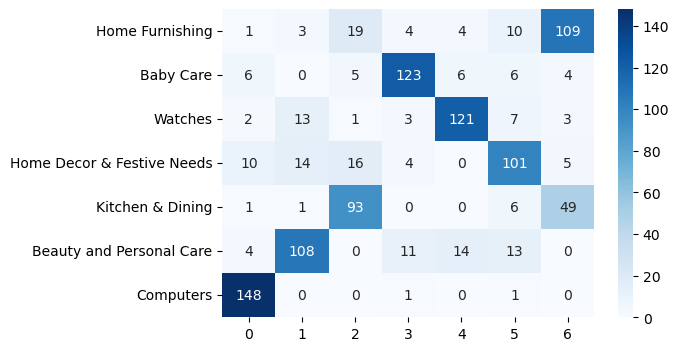

In [232]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_categ],
                     columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues", fmt='g')

Nous avons pu effectuer 3 modèles de type CNN Transfer Learning. Celui ayant les résultats les plus intéressants correspond à **InceptionV3**. 

Dans un autre notebook, nous allons réaliser une <u>classification supervisée</u> à partir des images. 

# DONNEES TEXTUELLES + DONNEES IMAGES

# 1. Combination features textuelles et images et clustering

## 1.1. CountVectorizer + SIFT

In [415]:
def combined(text_feat, image_feat):
    # Vérifions que les features textuelles et images sont de même dimensions
    print("Dimensions des caractéristiques textuelles :", text_feat.shape)
    print("Dimensions des caractéristiques visuelles :", image_feat.shape)
    
    # Concaténation des caractéristiques textuelles et visuelles
    combined_feat = np.concatenate((text_feat, image_feat), axis=1)
    print("Dimensions des caractéristiques combinées :", combined_feat.shape)
    print('------------------')
    
    # Réduction des dimensions par ACP
    print("Dimensions dataset avant réduction PCA : ", combined_feat.shape)
    pca = decomposition.PCA(n_components=0.99)
    feat_pca= pca.fit_transform(combined_feat)
    print("Dimensions dataset après réduction PCA : ", feat_pca.shape)
    
    # Réduction de dimensions en 2 composantes
    tsne = manifold.TSNE(n_components=2, perplexity=30, 
                         n_iter=2000, init='random', random_state=6)
    X_tsne = tsne.fit_transform(feat_pca)

    df_tsne = pd.DataFrame(X_tsne[:,0:2], columns=['tsne1', 'tsne2'])
    df_tsne["class"] = data["categ_generale"]
    
    # Création de clusters à partir du t-SNE
    cls = KMeans(n_clusters=7, random_state=6)
    cls.fit(X_tsne)

    df_tsne["cluster"] = cls.labels_
    
    # Création des graphiques t-SNE
    fig, (ax1, ax2) = plt.subplots(figsize=(15,6), ncols=2)

    sns.scatterplot(
        x="tsne1", y="tsne2", hue="class", data=df_tsne, legend="brief",
        palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6, ax=ax2)

    ax2.set_title('TSNE selon les vraies classes', fontsize=15, pad=35, fontweight='bold')
    ax2.set_xlabel('tsne1', fontsize=13)
    ax2.set_ylabel('tsne2', fontsize=13)
    legend = ax2.legend(prop={'size': 10}, bbox_to_anchor=(1, 1), loc='upper left')

    sns.scatterplot(
        x="tsne1", y="tsne2", hue="cluster", palette=sns.color_palette('tab10', n_colors=7),
        s=50, alpha=0.6, data=df_tsne, legend="brief", ax=ax1)

    ax1.set_title('TSNE selon les clusters', fontsize=15, pad=35, fontweight='bold')
    ax1.set_xlabel('tsne1', fontsize=13)
    ax1.set_ylabel('tsne2', fontsize=13)
    legend = ax1.legend(prop={'size': 10}, bbox_to_anchor=(1, 1), loc='upper left')

    plt.show()
    
    # Calcul du score ARI pour vérifier la similarité entre les catégories des images et des clusters
    labels = data["label"]
    ARI = metrics.adjusted_rand_score(labels, cls.labels_)
    print("ARI : ", ARI)
    
    return [ARI, labels, cls.labels_, df_tsne["class"]]

Dimensions des caractéristiques textuelles : (1050, 3118)
Dimensions des caractéristiques visuelles : (1050, 559)
Dimensions des caractéristiques combinées : (1050, 3677)
------------------
Dimensions dataset avant réduction PCA :  (1050, 3677)
Dimensions dataset après réduction PCA :  (1050, 513)


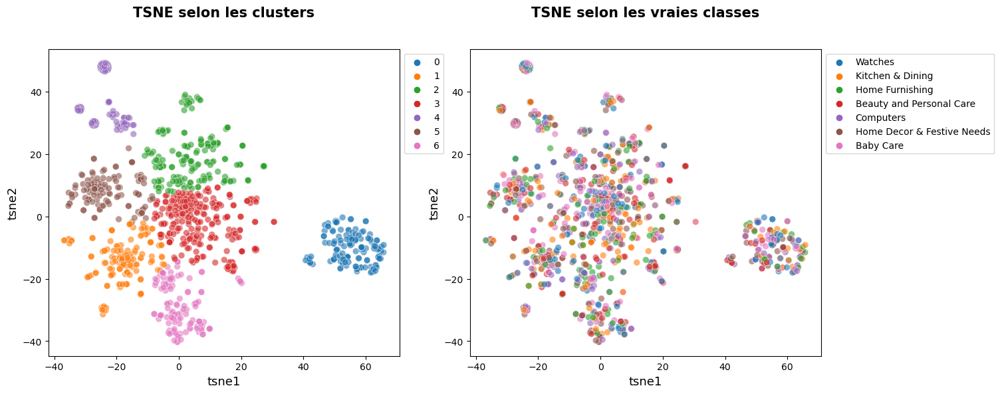

ARI :  -0.0019161897803870783


In [416]:
ARI_CV_SIFT, labels_CV_SIFT, pred_CV_SIFT, classes_CV_SIFT = combined(cv_transform, im_features)

In [399]:
# # On va créer une fonction

# def combined(text_feat, image_feat):
#     # Vérifions que les features textuelles et images sont de même dimensions
#     print("Dimensions des caractéristiques textuelles :", text_feat.shape)
#     print("Dimensions des caractéristiques visuelles :", image_feat.shape)
    
#     # Concaténation des caractéristiques textuelles et visuelles
#     combined_feat = np.concatenate((text_feat, image_feat), axis=1)
#     print("Dimensions des caractéristiques combinées :", combined_feat.shape)
    
#     # On calcule notre score ARI et on effectue notre t-SNE
#     ARI, X_TSNE, labels, y_cat_num = ARI_fct(combined_feat)
#     TSNE_visu_fct(X_TSNE, y_cat_num, labels, ARI)
    
#     return ARI

In [400]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('CountVect_SIFT')
scores_ARI['Score_ARI'].append(ARI_CV_SIFT)

df_CV_SIFT = pd.DataFrame(scores_ARI)
display(df_CV_SIFT)

,Model,Score_ARI
0,CountVect_SIFT,-0.001916


## 1.2. CountVectorizer + VGG16

Dimensions des caractéristiques textuelles : (1050, 3118)
Dimensions des caractéristiques visuelles : (1050, 4096)
Dimensions des caractéristiques combinées : (1050, 7214)
------------------
Dimensions dataset avant réduction PCA :  (1050, 7214)
Dimensions dataset après réduction PCA :  (1050, 826)


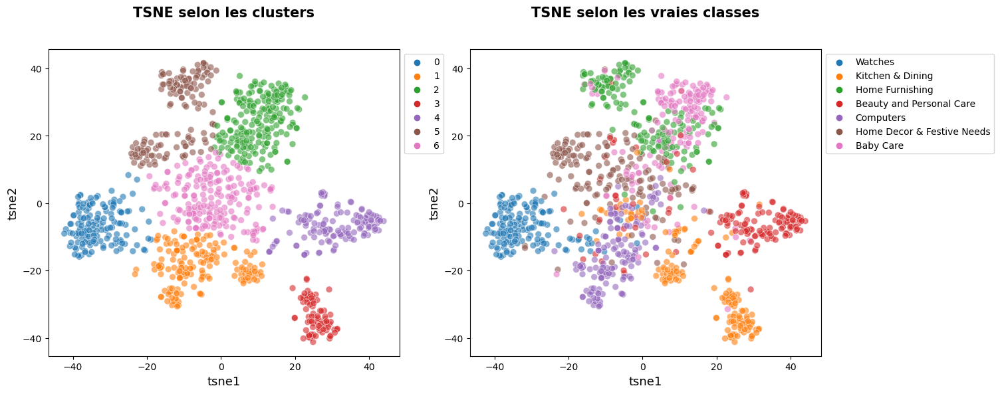

ARI :  0.44915338352258993


In [417]:
ARI_CV_VGG, labels_CV_VGG, pred_CV_VGG, classes_CV_VGG = combined(cv_transform, im_feat_cnn)

In [418]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('CountVect_VGG16')
scores_ARI['Score_ARI'].append(ARI_CV_VGG)

df_CV_VGG = pd.DataFrame(scores_ARI)
display(df_CV_VGG)

,Model,Score_ARI
0,CountVect_VGG16,0.449153


## 1.3. CountVectorizer + ResNet50

Dimensions des caractéristiques textuelles : (1050, 3118)
Dimensions des caractéristiques visuelles : (1050, 2048)
Dimensions des caractéristiques combinées : (1050, 5166)
------------------
Dimensions dataset avant réduction PCA :  (1050, 5166)
Dimensions dataset après réduction PCA :  (1050, 796)


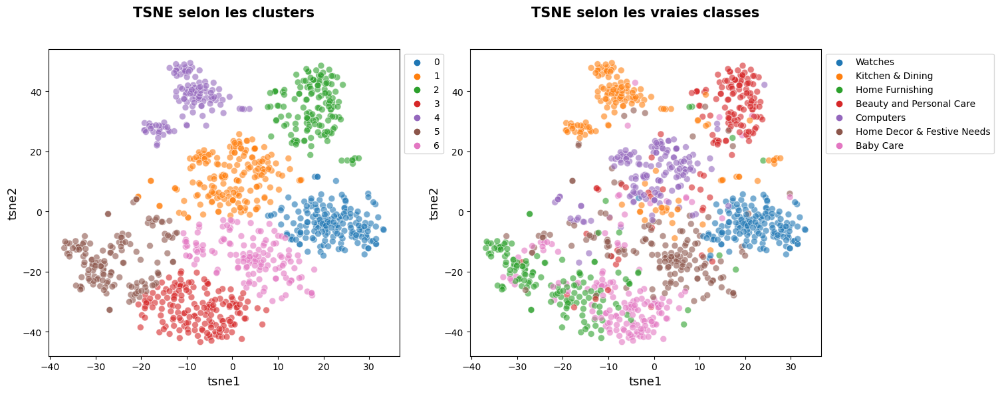

ARI :  0.554448904531606


In [419]:
ARI_CV_RN, labels_CV_RN, pred_CV_RN, classes_CV_RN = combined(cv_transform, im_feat_cnn_RN50)

In [420]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('CountVect_RN50')
scores_ARI['Score_ARI'].append(ARI_CV_RN)

df_CV_RN = pd.DataFrame(scores_ARI)
display(df_CV_RN)

,Model,Score_ARI
0,CountVect_RN50,0.554449


## 1.4. CountVectorizer + InceptionV3

Dimensions des caractéristiques textuelles : (1050, 3118)
Dimensions des caractéristiques visuelles : (1050, 2048)
Dimensions des caractéristiques combinées : (1050, 5166)
------------------
Dimensions dataset avant réduction PCA :  (1050, 5166)
Dimensions dataset après réduction PCA :  (1050, 816)


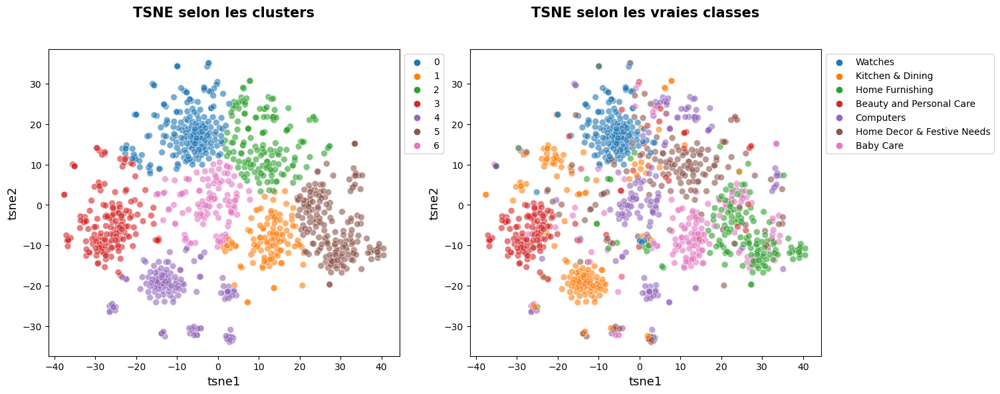

ARI :  0.37447229870256166


In [421]:
ARI_CV_Inc, labels_CV_Inc, pred_CV_Inc, classes_CV_Inc = combined(cv_transform, im_feat_cnn_InceptionV3)

In [422]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('CountVect_IncV3')
scores_ARI['Score_ARI'].append(ARI_CV_Inc)

df_CV_Inc = pd.DataFrame(scores_ARI)
display(df_CV_Inc)

,Model,Score_ARI
0,CountVect_IncV3,0.374472


## 1.5. Tf-idf + SIFT

In [423]:
# On convertit en tableau la matrice de features textuelles
ctf_transform = ctf_transform.toarray()

Dimensions des caractéristiques textuelles : (1050, 3118)
Dimensions des caractéristiques visuelles : (1050, 559)
Dimensions des caractéristiques combinées : (1050, 3677)
------------------
Dimensions dataset avant réduction PCA :  (1050, 3677)
Dimensions dataset après réduction PCA :  (1050, 742)


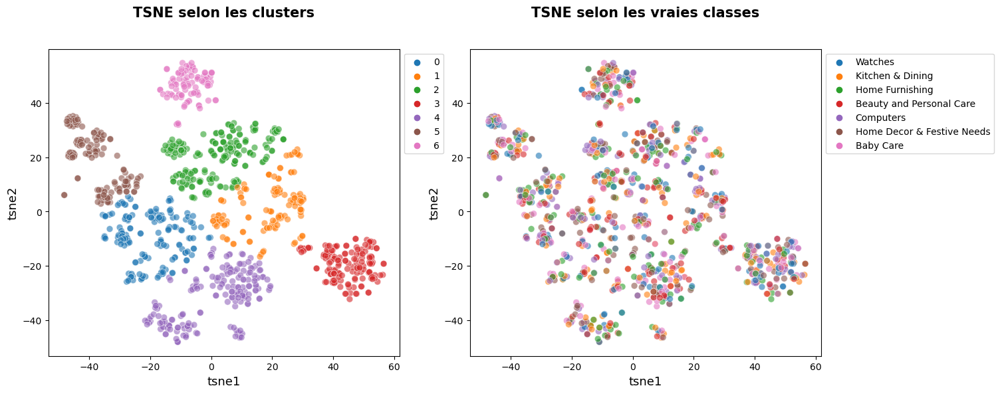

ARI :  -0.0025478099187987062


In [424]:
ARI_TF_SIFT, labels_TF_SIFT, pred_TF_SIFT, classes_TF_SIFT = combined(ctf_transform, im_features)

In [425]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('TFIDF_SIFT')
scores_ARI['Score_ARI'].append(ARI_TF_SIFT)

df_TF_SIFT = pd.DataFrame(scores_ARI)
display(df_TF_SIFT)

,Model,Score_ARI
0,TFIDF_SIFT,-0.002548


## 1.6. Tf-idf + VGG16

Dimensions des caractéristiques textuelles : (1050, 3118)
Dimensions des caractéristiques visuelles : (1050, 4096)
Dimensions des caractéristiques combinées : (1050, 7214)
------------------
Dimensions dataset avant réduction PCA :  (1050, 7214)
Dimensions dataset après réduction PCA :  (1050, 803)


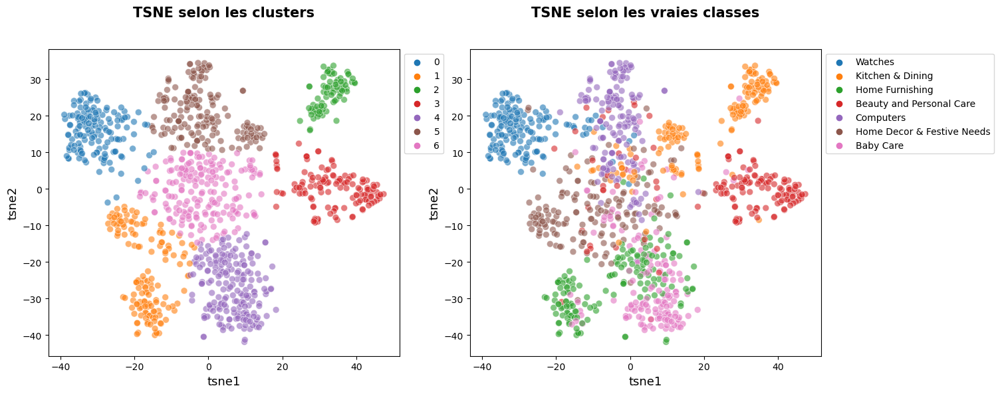

ARI :  0.4487629672781806


In [426]:
ARI_TF_VGG, labels_TF_VGG, pred_TF_VGG, classes_TF_VGG = combined(ctf_transform, im_feat_cnn)

In [427]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('TFIDF_VGG16')
scores_ARI['Score_ARI'].append(ARI_TF_VGG)

df_TF_VGG = pd.DataFrame(scores_ARI)
display(df_TF_VGG)

,Model,Score_ARI
0,TFIDF_VGG16,0.448763


## 1.7. Tf-idf + ResNet50

Dimensions des caractéristiques textuelles : (1050, 3118)
Dimensions des caractéristiques visuelles : (1050, 2048)
Dimensions des caractéristiques combinées : (1050, 5166)
------------------
Dimensions dataset avant réduction PCA :  (1050, 5166)
Dimensions dataset après réduction PCA :  (1050, 726)


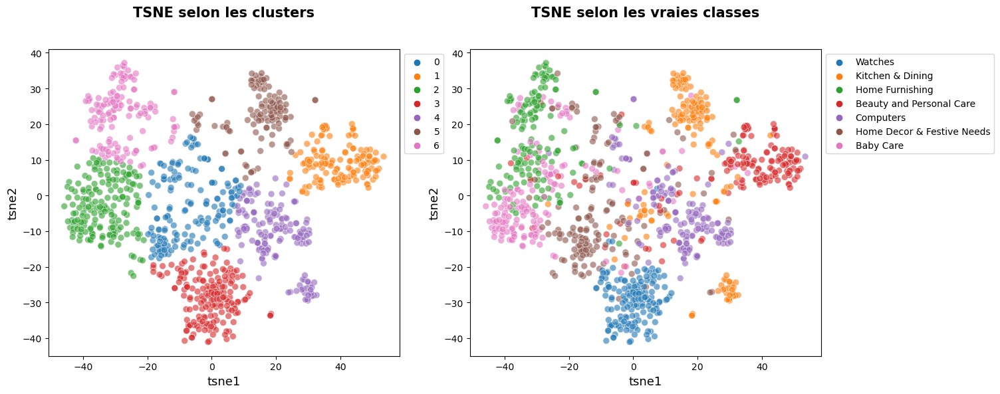

ARI :  0.4718424855467897


In [428]:
ARI_TF_RN, labels_TF_RN, pred_TF_RN, classes_TF_RN = combined(ctf_transform, im_feat_cnn_RN50)

In [429]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('TFIDF_RN50')
scores_ARI['Score_ARI'].append(ARI_TF_RN)

df_TF_RN = pd.DataFrame(scores_ARI)
display(df_TF_RN)

,Model,Score_ARI
0,TFIDF_RN50,0.471842


## 1.8. Tf-idf + InceptionV3

Dimensions des caractéristiques textuelles : (1050, 3118)
Dimensions des caractéristiques visuelles : (1050, 2048)
Dimensions des caractéristiques combinées : (1050, 5166)
------------------
Dimensions dataset avant réduction PCA :  (1050, 5166)
Dimensions dataset après réduction PCA :  (1050, 718)


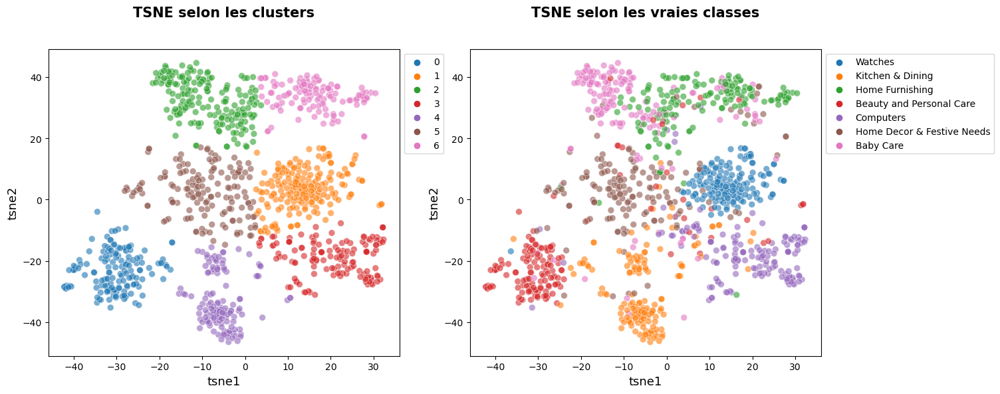

ARI :  0.5701035696754758


In [430]:
ARI_TF_Inc, labels_TF_Inc, pred_TF_Inc, classes_TF_Inc = combined(ctf_transform, im_feat_cnn_InceptionV3)

In [431]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('TFIDF_IncV3')
scores_ARI['Score_ARI'].append(ARI_TF_Inc)

df_TF_Inc = pd.DataFrame(scores_ARI)
display(df_TF_Inc)

,Model,Score_ARI
0,TFIDF_IncV3,0.570104


## 1.9. Word2Vec (CBOW) + SIFT

Dimensions des caractéristiques textuelles : (1050, 3118)
Dimensions des caractéristiques visuelles : (1050, 559)
Dimensions des caractéristiques combinées : (1050, 3677)
------------------
Dimensions dataset avant réduction PCA :  (1050, 3677)
Dimensions dataset après réduction PCA :  (1050, 51)


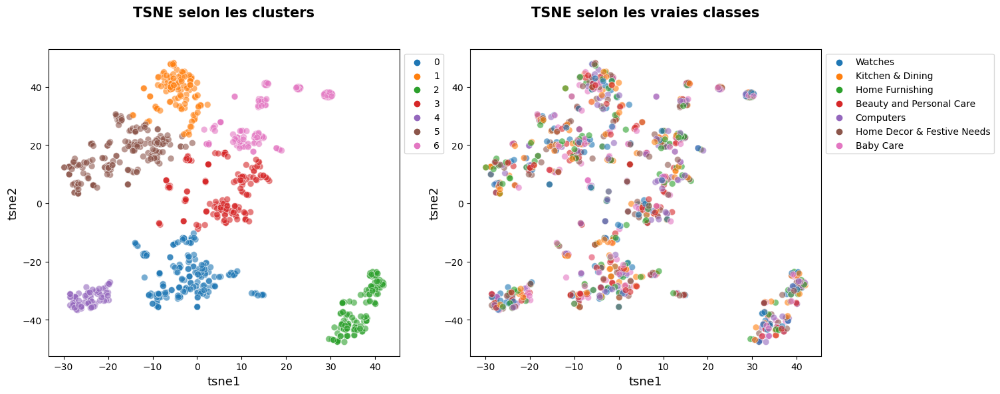

ARI :  0.00037750545096704586


In [432]:
ARI_W2V_SIFT, labels_W2V_SIFT, pred_W2V_SIFT, classes_W2V_SIFT = combined(embeddings_cbow, im_features)

In [433]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('Word2Vec_SIFT')
scores_ARI['Score_ARI'].append(ARI_W2V_SIFT)

df_W2V_SIFT = pd.DataFrame(scores_ARI)
display(df_W2V_SIFT)

,Model,Score_ARI
0,Word2Vec_SIFT,0.000378


## 1.10. Word2Vec (CBOW) + VGG16

Dimensions des caractéristiques textuelles : (1050, 3118)
Dimensions des caractéristiques visuelles : (1050, 4096)
Dimensions des caractéristiques combinées : (1050, 7214)
------------------
Dimensions dataset avant réduction PCA :  (1050, 7214)
Dimensions dataset après réduction PCA :  (1050, 806)


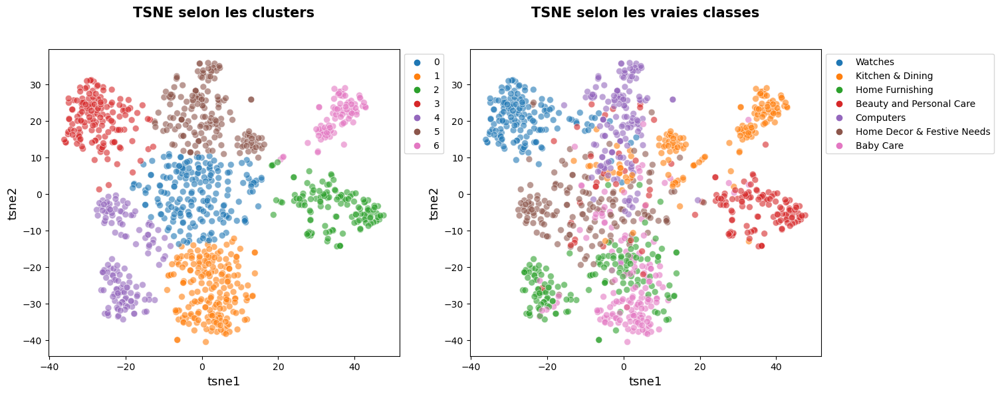

ARI :  0.45263638016469354


In [434]:
ARI_W2V_VGG, labels_W2V_VGG, pred_W2V_VGG, classes_W2V_VGG = combined(embeddings_cbow, im_feat_cnn)

In [435]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('Word2Vec_VGG16')
scores_ARI['Score_ARI'].append(ARI_W2V_VGG)

df_W2V_VGG = pd.DataFrame(scores_ARI)
display(df_W2V_VGG)

,Model,Score_ARI
0,Word2Vec_VGG16,0.452636


## 1.11. Word2Vec (CBOW) + ResNet50

Dimensions des caractéristiques textuelles : (1050, 3118)
Dimensions des caractéristiques visuelles : (1050, 2048)
Dimensions des caractéristiques combinées : (1050, 5166)
------------------
Dimensions dataset avant réduction PCA :  (1050, 5166)
Dimensions dataset après réduction PCA :  (1050, 732)


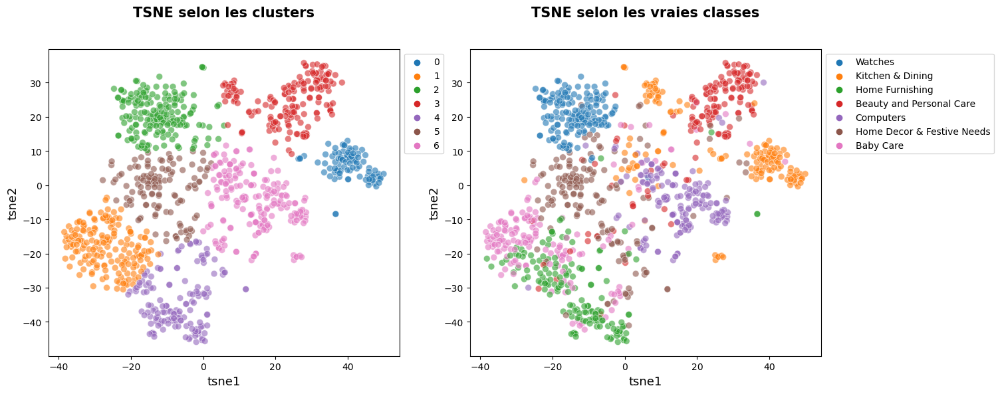

ARI :  0.5248920183431642


In [436]:
ARI_W2V_RN, labels_W2V_RN, pred_W2V_RN, classes_W2V_RN = combined(embeddings_cbow, im_feat_cnn_RN50)

In [437]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('Word2Vec_RN50')
scores_ARI['Score_ARI'].append(ARI_W2V_RN)

df_W2V_RN = pd.DataFrame(scores_ARI)
display(df_W2V_RN)

,Model,Score_ARI
0,Word2Vec_RN50,0.524892


## 1.12. Word2Vec (CBOW) + InceptionV3

Dimensions des caractéristiques textuelles : (1050, 3118)
Dimensions des caractéristiques visuelles : (1050, 2048)
Dimensions des caractéristiques combinées : (1050, 5166)
------------------
Dimensions dataset avant réduction PCA :  (1050, 5166)
Dimensions dataset après réduction PCA :  (1050, 704)


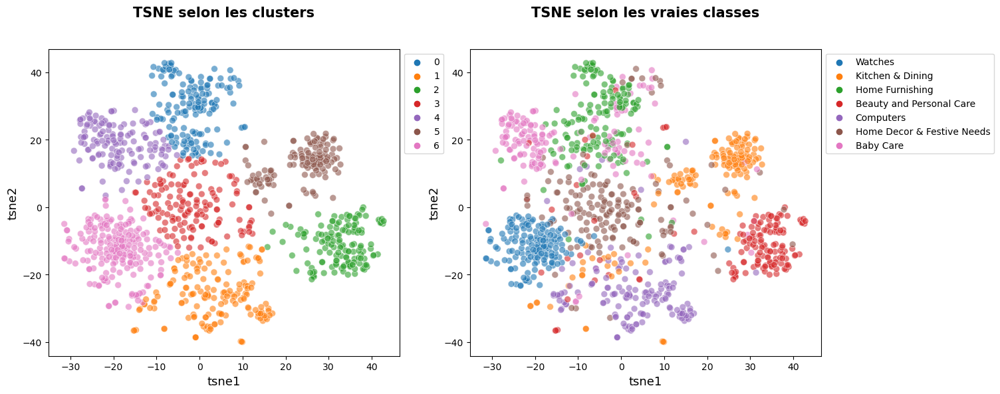

ARI :  0.549314160574944


In [438]:
ARI_W2V_Inc, labels_W2V_Inc, pred_W2V_Inc, classes_W2V_Inc = combined(embeddings_cbow, im_feat_cnn_InceptionV3)

In [439]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('Word2Vec_IncV3')
scores_ARI['Score_ARI'].append(ARI_W2V_Inc)

df_W2V_Inc = pd.DataFrame(scores_ARI)
display(df_W2V_Inc)

,Model,Score_ARI
0,Word2Vec_IncV3,0.549314


## 1.13. BERT + SIFT

Dimensions des caractéristiques textuelles : (1050, 768)
Dimensions des caractéristiques visuelles : (1050, 559)
Dimensions des caractéristiques combinées : (1050, 1327)
------------------
Dimensions dataset avant réduction PCA :  (1050, 1327)
Dimensions dataset après réduction PCA :  (1050, 323)


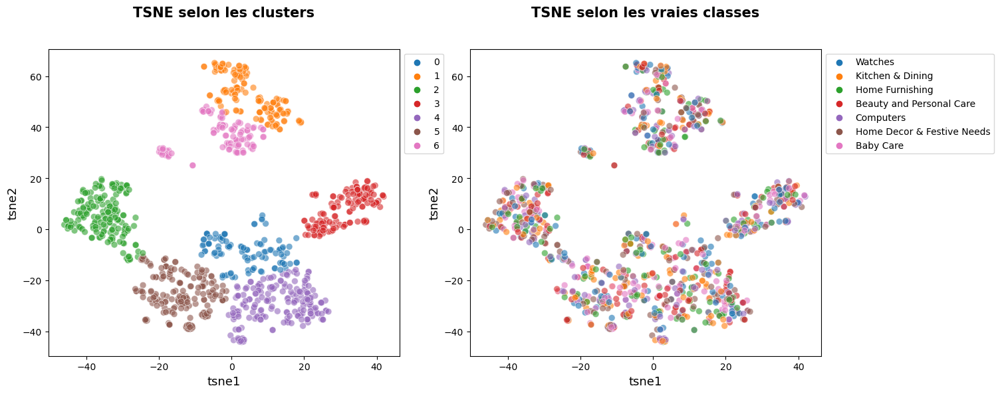

ARI :  -0.0005960275322485564


In [440]:
ARI_BERT_SIFT, labels_BERT_SIFT, pred_BERT_SIFT, classes_BERT_SIFT = combined(features_bert_HF, im_features)

In [441]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('BERT_SIFT')
scores_ARI['Score_ARI'].append(ARI_BERT_SIFT)

df_BERT_SIFT = pd.DataFrame(scores_ARI)
display(df_BERT_SIFT)

,Model,Score_ARI
0,BERT_SIFT,-0.000596


## 1.14. BERT + VGG16

Dimensions des caractéristiques textuelles : (1050, 768)
Dimensions des caractéristiques visuelles : (1050, 4096)
Dimensions des caractéristiques combinées : (1050, 4864)
------------------
Dimensions dataset avant réduction PCA :  (1050, 4864)
Dimensions dataset après réduction PCA :  (1050, 808)


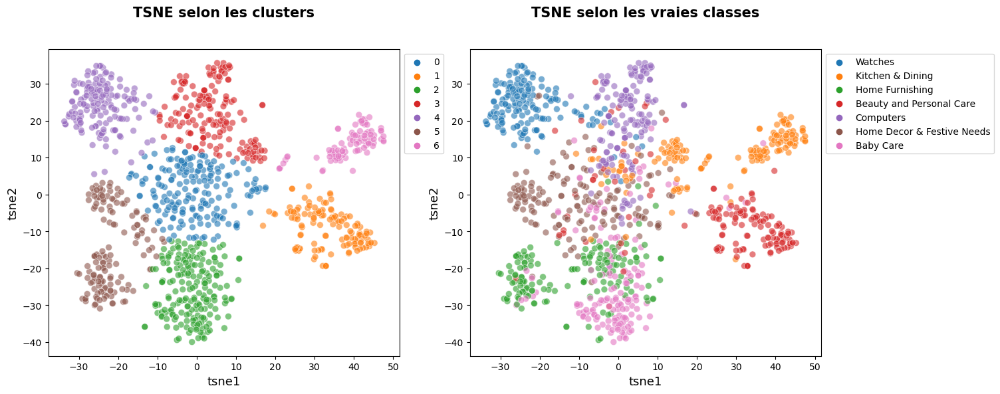

ARI :  0.4634052904442376


In [442]:
ARI_BERT_VGG, labels_BERT_VGG, pred_BERT_VGG, classes_BERT_VGG = combined(features_bert_HF, im_feat_cnn)

In [443]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('BERT_VGG16')
scores_ARI['Score_ARI'].append(ARI_BERT_VGG)

df_BERT_VGG = pd.DataFrame(scores_ARI)
display(df_BERT_VGG)

,Model,Score_ARI
0,BERT_VGG16,0.463405


## 1.15. BERT + ResNet50

Dimensions des caractéristiques textuelles : (1050, 768)
Dimensions des caractéristiques visuelles : (1050, 2048)
Dimensions des caractéristiques combinées : (1050, 2816)
------------------
Dimensions dataset avant réduction PCA :  (1050, 2816)
Dimensions dataset après réduction PCA :  (1050, 746)


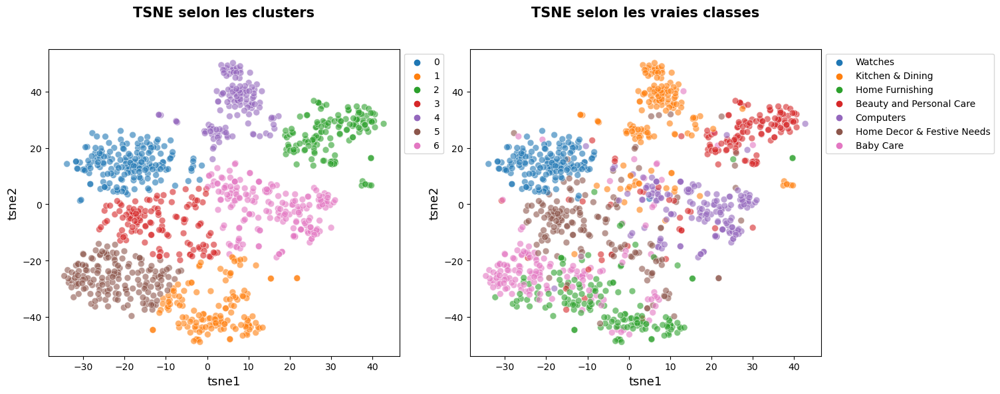

ARI :  0.5780536630582581


In [444]:
ARI_BERT_RN, labels_BERT_RN, pred_BERT_RN, classes_BERT_RN = combined(features_bert_HF, im_feat_cnn_RN50)

In [445]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('BERT_RN50')
scores_ARI['Score_ARI'].append(ARI_BERT_RN)

df_BERT_RN = pd.DataFrame(scores_ARI)
display(df_BERT_RN)

,Model,Score_ARI
0,BERT_RN50,0.578054


## 1.16. BERT + InceptionV3

Dimensions des caractéristiques textuelles : (1050, 768)
Dimensions des caractéristiques visuelles : (1050, 2048)
Dimensions des caractéristiques combinées : (1050, 2816)
------------------
Dimensions dataset avant réduction PCA :  (1050, 2816)
Dimensions dataset après réduction PCA :  (1050, 755)


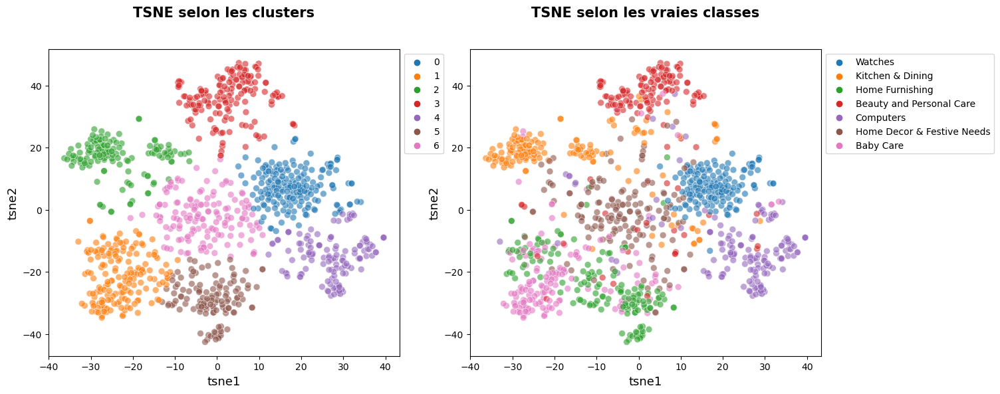

ARI :  0.541850601983109


In [446]:
ARI_BERT_Inc, labels_BERT_Inc, pred_BERT_Inc, classes_BERT_Inc = combined(features_bert_HF, im_feat_cnn_InceptionV3)

In [447]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('BERT_IncV3')
scores_ARI['Score_ARI'].append(ARI_BERT_Inc)

df_BERT_Inc = pd.DataFrame(scores_ARI)
display(df_BERT_Inc)

,Model,Score_ARI
0,BERT_IncV3,0.541851


## 1.17. USE + SIFT

Dimensions des caractéristiques textuelles : (1050, 512)
Dimensions des caractéristiques visuelles : (1050, 559)
Dimensions des caractéristiques combinées : (1050, 1071)
------------------
Dimensions dataset avant réduction PCA :  (1050, 1071)
Dimensions dataset après réduction PCA :  (1050, 396)


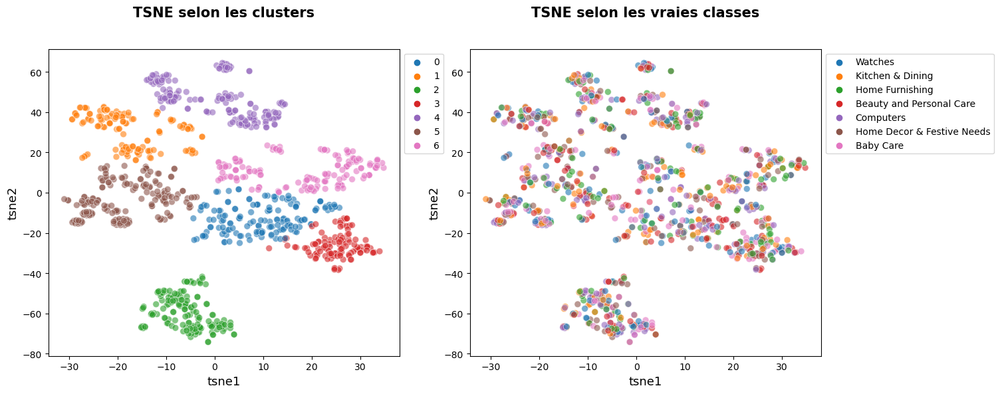

ARI :  -0.000605179172367364


In [448]:
ARI_USE_SIFT, labels_USE_SIFT, pred_USE_SIFT, classes_USE_SIFT = combined(features_USE, im_features)

In [449]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('USE_SIFT')
scores_ARI['Score_ARI'].append(ARI_USE_SIFT)

df_USE_SIFT = pd.DataFrame(scores_ARI)
display(df_USE_SIFT)

,Model,Score_ARI
0,USE_SIFT,-0.000605


## 1.18. USE + VGG16

Dimensions des caractéristiques textuelles : (1050, 512)
Dimensions des caractéristiques visuelles : (1050, 4096)
Dimensions des caractéristiques combinées : (1050, 4608)
------------------
Dimensions dataset avant réduction PCA :  (1050, 4608)
Dimensions dataset après réduction PCA :  (1050, 803)


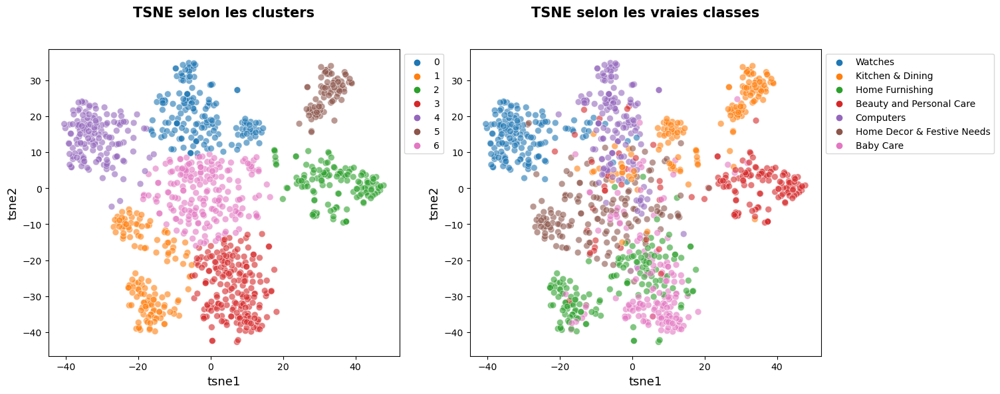

ARI :  0.45206741226655967


In [450]:
ARI_USE_VGG, labels_USE_VGG, pred_USE_VGG, classes_USE_VGG = combined(features_USE, im_feat_cnn)

In [451]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('USE_VGG16')
scores_ARI['Score_ARI'].append(ARI_USE_VGG)

df_USE_VGG = pd.DataFrame(scores_ARI)
display(df_USE_VGG)

,Model,Score_ARI
0,USE_VGG16,0.452067


## 1.19. USE + ResNet50

Dimensions des caractéristiques textuelles : (1050, 512)
Dimensions des caractéristiques visuelles : (1050, 2048)
Dimensions des caractéristiques combinées : (1050, 2560)
------------------
Dimensions dataset avant réduction PCA :  (1050, 2560)
Dimensions dataset après réduction PCA :  (1050, 725)


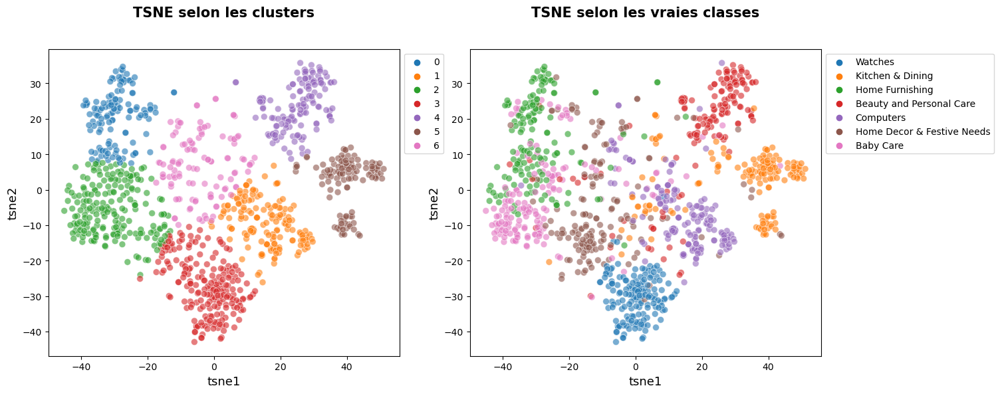

ARI :  0.4862086246485133


In [452]:
ARI_USE_RN, labels_USE_RN, pred_USE_RN, classes_USE_RN = combined(features_USE, im_feat_cnn_RN50)

In [453]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('USE_RN50')
scores_ARI['Score_ARI'].append(ARI_USE_RN)

df_USE_RN = pd.DataFrame(scores_ARI)
display(df_USE_RN)

,Model,Score_ARI
0,USE_RN50,0.486209


## 1.20. USE + InceptionV3

Dimensions des caractéristiques textuelles : (1050, 512)
Dimensions des caractéristiques visuelles : (1050, 2048)
Dimensions des caractéristiques combinées : (1050, 2560)
------------------
Dimensions dataset avant réduction PCA :  (1050, 2560)
Dimensions dataset après réduction PCA :  (1050, 711)


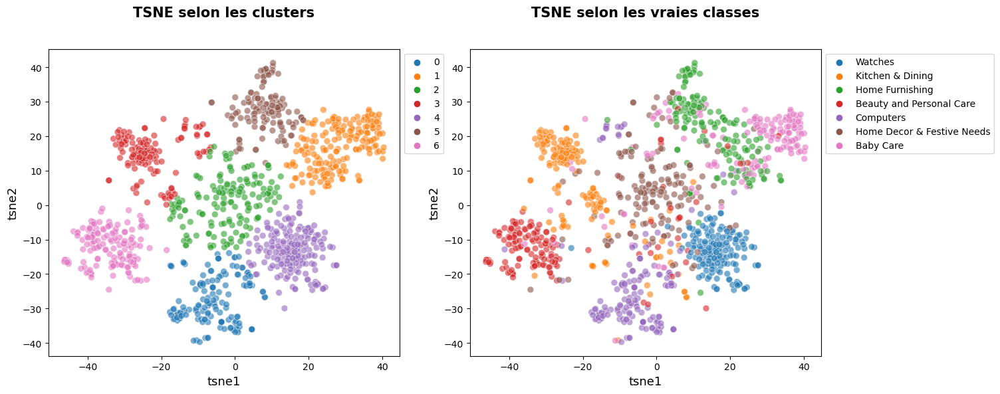

ARI :  0.5341768200881808


In [454]:
ARI_USE_Inc, labels_USE_Inc, pred_USE_Inc, classes_USE_Inc = combined(features_USE, im_feat_cnn_InceptionV3)

In [455]:
# On crée un dictionnaire pour stocker nos valeurs de score ARI
scores_ARI = {
    'Model' : [],
    'Score_ARI' : []
}

# On ajoute les résultats pour notre modèle
scores_ARI['Model'].append('USE_IncV3')
scores_ARI['Score_ARI'].append(ARI_USE_Inc)

df_USE_Inc = pd.DataFrame(scores_ARI)
display(df_USE_Inc)

,Model,Score_ARI
0,USE_IncV3,0.534177


# 2. Représentation graphique des scores obtenus

In [456]:
# On regroupe nos scores obtenus
df_combined_ari = pd.concat([df_CV_SIFT, df_CV_VGG, df_CV_RN, df_CV_Inc,
                            df_TF_SIFT, df_TF_VGG, df_TF_RN, df_TF_Inc,
                            df_W2V_SIFT, df_W2V_VGG, df_W2V_RN, df_W2V_Inc,
                            df_BERT_SIFT, df_BERT_VGG, df_BERT_RN, df_BERT_Inc,
                            df_USE_SIFT, df_USE_VGG, df_BERT_RN, df_BERT_Inc], axis=0)
df_combined_ari['Score_ARI'] = round(df_combined_ari['Score_ARI'], 2)
df_combined_ari

,Model,Score_ARI
0,CountVect_SIFT,-0.00
0,CountVect_VGG16,0.45
0,CountVect_RN50,0.55
0,CountVect_IncV3,0.37
0,TFIDF_SIFT,-0.00
0,TFIDF_VGG16,0.45
0,TFIDF_RN50,0.47
0,TFIDF_IncV3,0.57
0,Word2Vec_SIFT,0.00
0,Word2Vec_VGG16,0.45


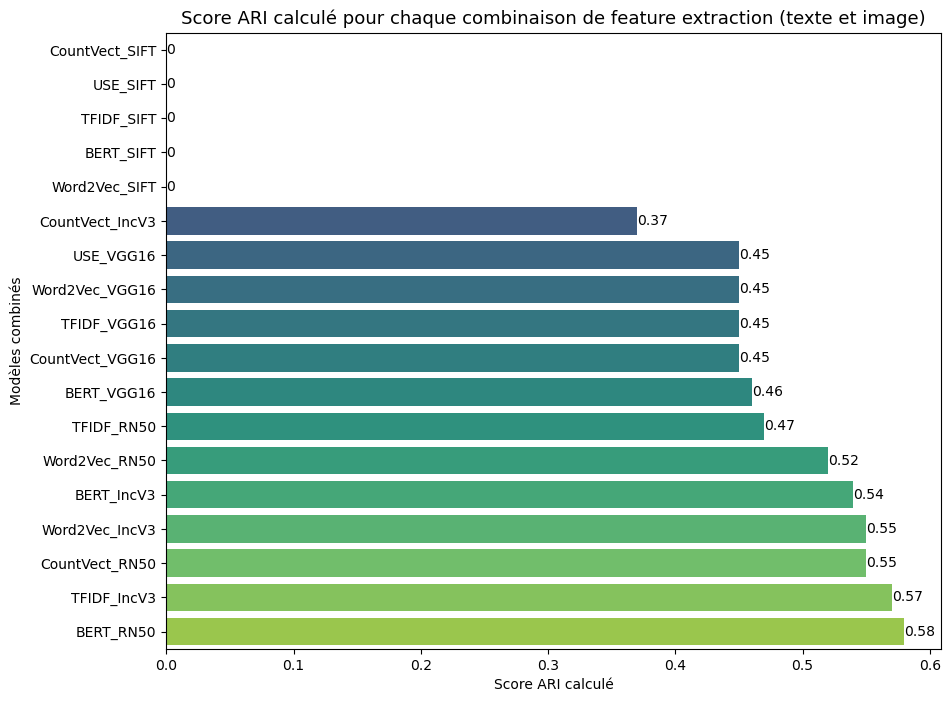

In [457]:
# Définition d'une palette de couleurs personnalisée
palette = sns.color_palette("viridis", len(df_combined_ari))
# Tri des données par score ARI décroissant
df_combined_ari_sorted = df_combined_ari.sort_values('Score_ARI', ascending=True)

# Tracé du graphique en utilisant la palette de couleurs personnalisée
plt.figure(figsize=(10, 8))
ax = sns.barplot(data=df_combined_ari_sorted, y='Model', x='Score_ARI', palette=palette)
plt.title('Score ARI calculé pour chaque combinaison de feature extraction (texte et image)', size=13)
plt.ylabel('Modèles combinés')
plt.xlabel('Score ARI calculé')

for i in ax.containers:
    ax.bar_label(i,)

plt.show()

Le graphique obtenu montre dans un premier temps, que les valeurs ARI combinées de n'importe quel modèle d'extraction de caractéristiques textuelles avec le modèle SIFT renvoie un score ARI proche de 0. 

Ensuite, nous observons également que chaque modèle d'extraction de features de données textuelles couplé avec le modèle VGG16 retourne un score ARI d'environ 0.45/0.46. 

Enfin, les scores ARI les plus élevés concernent des combinaisons de modèles d'extraction de données textuelles couplé soit avec le modèle ResNet50, soit le modèle InceptionV3. 

Le score ARI le plus élevé est atteint par le couplage du modèle **BERT et ResNet50** avec une valeur assez proche de 0.6 (**ARI = 0.58**). 

# 3. Matrice de confusion pour la combinaison (BERT et ResNet50)

In [458]:
# On crée notre matrice de confusion
conf_mat_BERT_RN = metrics.confusion_matrix(labels_BERT_RN, pred_BERT_RN)
print(conf_mat_BERT_RN)

[[  4  20   3   6   2 107   8]
 [  4   3 118   7   1   4  13]
 [  3   0   3   4   0   1 139]
 [ 11  23   3  93   5   6   9]
 [  0  93   3   6   0  48   0]
 [  2   0   8   5 119   0  16]
 [147   0   0   2   0   0   1]]


In [459]:
def conf_mat_transform(y_true,y_pred) :
    conf_mat = metrics.confusion_matrix(y_true,y_pred)
    
    corresp = [0, 2, 3, 5, 1, 6, 4]
    print ("Correspondance des clusters : ", corresp)
    labels = pd.Series(y_true, name="y_true").to_frame()
    labels['y_pred'] = y_pred
    labels['y_pred_transform'] = labels['y_pred'].apply(lambda x : corresp[x]) 
    
    return labels['y_pred_transform']

In [460]:
cls_labels_transform = conf_mat_transform(labels_BERT_RN, pred_BERT_RN)
conf_mat_BERT_RN = metrics.confusion_matrix(labels_BERT_RN, cls_labels_transform)
np.set_printoptions(suppress=True, precision=0)
print(conf_mat_BERT_RN)
print()
print(metrics.classification_report(labels_BERT_RN, cls_labels_transform))

Correspondance des clusters :  [0, 2, 3, 5, 1, 6, 4]
[[  4   2  20   3   8   6 107]
 [  4   1   3 118  13   7   4]
 [  3   0   0   3 139   4   1]
 [ 11   5  23   3   9  93   6]
 [  0   0  93   3   0   6  48]
 [  2 119   0   8  16   5   0]
 [147   0   0   0   1   2   0]]

              precision    recall  f1-score   support

           0       0.02      0.03      0.02       150
           1       0.01      0.01      0.01       150
           2       0.00      0.00      0.00       150
           3       0.02      0.02      0.02       150
           4       0.00      0.00      0.00       150
           5       0.04      0.03      0.04       150
           6       0.00      0.00      0.00       150

    accuracy                           0.01      1050
   macro avg       0.01      0.01      0.01      1050
weighted avg       0.01      0.01      0.01      1050



<Axes: >

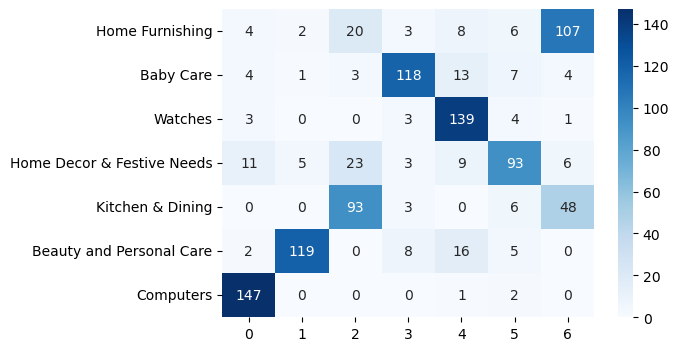

In [461]:
df_cm = pd.DataFrame(conf_mat_BERT_RN, index = [label for label in list_categ],
                     columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues", fmt='g')

In [462]:
# Enregistrement des features combinées BERT + ResNet50

# Combinaison des features
combined_feat_BERT_RN = np.concatenate((features_bert_HF, im_feat_cnn_RN50), axis=1)

# Création DataFrame
df_combined = pd.DataFrame(combined_feat_BERT_RN)

# Ajout des étiquettes
df_combined['label'] = labels_BERT_RN

# Ajout des catégories
df_combined['classes'] = classes_BERT_RN

# Ajout noms des images correspondantes
df_combined['image'] = data['image']

# Enregistrez le DataFrame dans un fichier CSV
df_combined.to_csv('donnees_combinees.csv', index=False)

In [463]:
df_combined.head()

,0,1,2,3,4,5,6,7,8,9,...,2809,2810,2811,2812,2813,2814,2815,label,classes,image
0,0.200532,-0.205197,0.718838,-0.039785,0.536180,0.252378,0.075956,0.072761,-0.095616,-0.352870,...,0.004406,1.604243,0.043518,0.350531,0.343850,0.000000,2.165368,6,Watches,009099b1f6e1e8f893ec29a7023153c4.jpg
1,0.148335,-0.078400,0.482108,0.107813,0.193846,0.023847,0.169878,-0.041152,-0.014009,-0.176780,...,0.000000,0.383919,0.720446,0.088955,1.474887,1.040611,1.635146,5,Kitchen & Dining,0096e89cc25a8b96fb9808716406fe94.jpg
2,0.125866,-0.148298,0.577522,0.018957,0.247185,-0.053283,-0.170143,0.165906,-0.146471,-0.198538,...,0.000000,0.321536,0.036855,1.523284,0.539581,0.000000,0.163918,4,Home Furnishing,00cbbc837d340fa163d11e169fbdb952.jpg
3,0.221357,-0.015224,0.635228,0.155166,0.314898,-0.232043,-0.184382,0.231620,-0.140047,0.035541,...,0.000000,0.987284,0.211744,0.058020,0.115298,0.828230,0.776003,1,Beauty and Personal Care,00d84a518e0550612fcfcba3b02b6255.jpg
4,0.267699,-0.005922,0.637282,-0.057764,0.332293,-0.412970,-0.129525,0.212769,0.020182,-0.111424,...,0.000000,0.000000,0.000000,0.160530,0.779795,0.000000,0.175765,2,Computers,00e966a5049a262cfc72e6bbf68b80e7.jpg
